# Imports

In [1]:
# Set jemalloc config early
import os
import psutil

# os.environ["POLARS_VERBOSE"]=str(1)

os.environ["POLARS_MAX_THREADS"] = str(max(1, int(psutil.cpu_count(logical=False) / 1)))
print(f"Using {os.environ['POLARS_MAX_THREADS']} polars threads")
os.environ["_RJEM_MALLOC_CONF"] = "muzzy_decay_ms:500"  # prevents memory leak in polars

Using 16 polars threads


In [2]:
import logging
from pyutilz.logginglib import init_logging

logger = init_logging(
    default_caller_name="astronomy.py",
    level=logging.INFO,
    format="%(asctime)s - %(levelname)s - %(funcName)s-line:%(lineno)d - %(message)s",
)

logger.info(f"test")

2026-01-01 13:27:05,465 - INFO - <module>-line:10 - test


In [3]:
try:
    from IPython.core.display import display, HTML

    display(HTML("<style>.container { width:100% !important; }</style>"))
except Exception as e:
    pass

%load_ext memory_profiler
%load_ext jupyter_black
%load_ext line_profiler
%load_ext autoreload
%load_ext autotime
%autosave 300
%autoreload 2

C:\Users\Administrator\AppData\Local\Temp\ipykernel_24612\3193644951.py:2: DeprecationWarning: Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display
  from IPython.core.display import display, HTML


Autosaving every 300 seconds
time: 0 ns (started: 2026-01-01 13:27:06 +03:00)


In [4]:
from astro_flares import *

import plotly.io as pio

pio.renderers.default = "notebook"  # или "jupyterlab" если JupyterLab

2026-01-01 13:27:09,639 - INFO - <module>-line:112 - TensorFlow version 2.15.0 available.
2026-01-01 13:27:09,661 - INFO - <module>-line:125 - JAX version 0.5.0 available.


time: 20.3 s (started: 2026-01-01 13:27:07 +03:00)


In [5]:
from mlframe.training.core import train_mlframe_models_suite
from mlframe.profiling.profile_training import create_synthetic_data
from mlframe.training.extractors import SimpleFeaturesAndTargetsExtractor
from mlframe.training.configs import PolarsPipelineConfig, TrainingSplitConfig

from mlframe.training_old import report_model_perf

show_perf_chart = True
report_title = "OOS"
charts_dir = None

report_params = {
    "report_ndigits": 2,
    "calib_report_ndigits": 2,
    "print_report": True,
    "report_title": report_title,
    "use_weights": True,
    "show_perf_chart": show_perf_chart,
}

2026-01-01 13:28:02,925 - INFO - ensure_initialized-line:253 - init
R:\ProgramData\anaconda3\Lib\site-packages\mlflow\protos\service_pb2.py:11: UserWarning:

google.protobuf.service module is deprecated. RPC implementations should provide code generator plugins which generate code specific to the RPC implementation. service.py will be removed in Jan 2025



time: 1min 21s (started: 2026-01-01 13:27:28 +03:00)


In [6]:
from recurrent_classifier import RecurrentClassifierWrapper, RecurrentConfig, InputMode
from build_labeled_dataset import (
    train_recurrent_classifier,
    build_labeled_dataset,
    _extract_sequence_from_hf_dataset,
    prepare_recurrent_training_data,
)
from recurrent_classifier import RNNType, InputMode

from os.path import join
from labels import surely_pos, surely_neg, maybe_neg
from active_learning_pipeline import run_active_learning_pipeline

time: 46 ms (started: 2026-01-01 13:28:50 +03:00)


In [7]:
dataset = load_dataset(
    "snad-space/ztf-m-dwarf-flares-2025", cache_dir="R:\Caches\huggingface"
)
dataset

Resolving data files:   0%|          | 0/314 [00:00<?, ?it/s]

Resolving data files:   0%|          | 0/314 [00:00<?, ?it/s]

Loading dataset shards:   0%|          | 0/124 [00:00<?, ?it/s]

DatasetDict({
    train: Dataset({
        features: ['id', 'class', 'mjd', 'mag', 'magerr'],
        num_rows: 1620543
    })
    test: Dataset({
        features: ['id', 'class', 'mjd', 'mag', 'magerr'],
        num_rows: 99
    })
    target: Dataset({
        features: ['id', 'class', 'mjd', 'mag', 'magerr'],
        num_rows: 94028217
    })
})

time: 33.4 s (started: 2026-01-01 13:28:52 +03:00)


# Data

In [4]:
df = dataset["train"].to_polars()
df

id,class,mjd,mag,magerr
str,i32,list[f64],list[f32],list[f32]
"""ZTFDR730205300044373_MJD58455.…",0,"[58455.18165, 58455.18259, … 58455.23377]","[17.883169, 18.151482, … 18.038214]","[0.02488, 0.028296, … 0.026756]"
"""ZTFDR655205200002175_MJD58786.…",0,"[58786.38102, 58786.38948, … 58786.41958]","[19.494904, 19.380848, … 19.204346]","[0.083979, 0.077006, … 0.067312]"
"""ZTFDR436202200055092_MJD59015.…",0,"[59015.41453, 59015.41499, … 59015.4623]","[18.406841, 18.636959, … 18.548981]","[0.045835, 0.052003, … 0.049504]"
"""ZTFDR487207100046084_MJD58697.…",0,"[58697.22421, 58697.22466, … 58697.29089]","[15.969276, 16.003746, … 16.094067]","[0.018816, 0.018905, … 0.019154]"
"""ZTFDR800204400016836_MJD58441.…",0,"[58441.07085, 58441.07277, … 58441.20638]","[20.313932, 20.34502, … 19.63982]","[0.130327, 0.133302, … 0.079213]"
…,…,…,…,…
"""TIC260972843_CADENCE38934_ZTFD…",1,"[58669.2212, 58669.22165, … 58669.28239]","[17.328041, 17.316807, … 17.04026]","[0.022367, 0.020331, … 0.019497]"
"""TIC326393023_CADENCE143305_ZTF…",1,"[58330.23088, 58330.23226, … 58330.27609]","[17.836258, 17.817795, … 17.804485]","[0.029949, 0.027659, … 0.024496]"
"""TIC302296434_CADENCE284896_ZTF…",1,"[58662.26429, 58662.26474, … 58662.31481]","[18.745579, 18.823509, … 18.283525]","[0.097997, 0.062665, … 0.045213]"


time: 1.56 s (started: 2025-12-17 04:54:01 +03:00)


In [5]:
df.columns, df.dtypes

(['id', 'class', 'mjd', 'mag', 'magerr'],
 [String, Int32, List(Float64), List(Float32), List(Float32)])

time: 15 ms (started: 2025-12-17 04:54:03 +03:00)


# EDA

In [7]:
df["class"].mean()

0.3829228844899518

time: 0 ns (started: 2025-12-17 04:38:41 +03:00)


In [8]:
norm_series(df, 13)

time: 812 ms (started: 2025-12-17 04:38:44 +03:00)


In [9]:
compare_classes(df)

time: 203 ms (started: 2025-12-17 04:38:47 +03:00)


# ML

In [45]:
features = extract_features_polars(df)
features

id,class,npoints,mag_std,mag_skewness,mag_kurtosis,mag_amplitude_sigma,mag_mean,mag_median,magerr_std,magerr_skewness,magerr_kurtosis,magerr_amplitude_sigma,magerr_mean,magerr_median,norm_std,norm_skewness,norm_kurtosis,norm_amplitude_sigma,norm_mean,norm_median
str,i32,u32,f32,f64,f64,f32,f32,f32,f32,f64,f64,f32,f32,f32,f32,f64,f64,f32,f32,f32
"""ZTFDR730205300044373_MJD58455.…",0,39,0.05864,-0.487522,0.17598,0.268312,18.040049,18.04834,0.000752,-0.342352,0.008401,0.003416,0.026799,0.026888,2.180901,-0.487522,0.17598,9.978983,-0.308391,0.0
"""ZTFDR655205200002175_MJD58786.…",0,12,0.1553,-0.205899,-0.930407,0.513088,19.417023,19.437876,0.009281,-0.038016,-0.943449,0.030774,0.079637,0.080492,1.929374,-0.205899,-0.930407,6.374374,-0.25908,0.0
"""ZTFDR436202200055092_MJD59015.…",0,44,0.477234,0.479898,-0.409008,1.930096,19.138649,19.093185,0.02294,1.050148,0.284357,0.087416,0.0735,0.06818,6.999612,0.479898,-0.409008,28.308773,0.666802,0.0
"""ZTFDR487207100046084_MJD58697.…",0,16,0.036377,-0.392952,-0.363239,0.135784,16.048895,16.048555,0.0001,-0.323464,-0.451851,0.00037,0.019029,0.019026,1.911953,-0.392952,-0.363239,7.13667,0.017782,0.0
"""ZTFDR800204400016836_MJD58441.…",0,82,0.214686,-1.089743,1.883778,1.103382,20.357958,20.385025,0.018553,-0.817091,0.778695,0.088591,0.135131,0.137215,1.564592,-1.089743,1.883778,8.041247,-0.197261,-0.000007
…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…
"""TIC260972843_CADENCE38934_ZTFD…",1,11,0.120239,-1.63149,0.726838,0.325521,17.268621,17.316807,0.001126,0.108974,-1.436223,0.003179,0.02074,0.020352,5.907923,-1.63149,0.726838,15.994493,-2.367646,0.0
"""TIC326393023_CADENCE143305_ZTF…",1,73,0.098379,-2.001384,3.898588,0.505289,17.766716,17.795734,0.002396,0.083707,0.55543,0.013954,0.026194,0.02603,3.779484,-2.001384,3.898588,19.412037,-1.114872,0.0
"""TIC302296434_CADENCE284896_ZTF…",1,12,0.327059,-0.526396,0.778102,1.273535,18.298306,18.287445,0.018411,1.486849,1.830714,0.068085,0.050098,0.044546,7.342123,-0.526397,0.778103,28.589464,0.243812,0.0


time: 12.5 s (started: 2025-12-17 09:15:10 +03:00)


In [46]:
ft_extractor = SimpleFeaturesAndTargetsExtractor(
    classification_targets=["class"], columns_to_drop=set(["id"]), verbose=1
)

time: 15 ms (started: 2025-12-17 09:15:51 +03:00)


Raw data:
<class 'polars.dataframe.frame.DataFrame'>
RangeIndex: 1620543 entries, 0 to 1620542
Columns: 21 entries, id to norm_median
dtypes: Float32(12), Float64(6), Int32(1), String(1), UInt32(1)
memory usage: 0.2+ GB
Processed data:
<class 'polars.dataframe.frame.DataFrame'>
RangeIndex: 1620543 entries, 0 to 1620542
Columns: 21 entries, id to norm_median
dtypes: Float32(12), Float64(6), Int32(1), String(1), UInt32(1)
memory usage: 0.2+ GB


,id,class,npoints,mag_skewness,mag_kurtosis,magerr_skewness,magerr_kurtosis,norm_skewness,norm_kurtosis
0,ZTFDR730205300044373_MJD58455.18165,0,39,-0.487522,0.175980,-0.342352,0.008401,-0.487522,0.175980
1,ZTFDR655205200002175_MJD58786.38102,0,12,-0.205899,-0.930407,-0.038016,-0.943449,-0.205899,-0.930407
2,ZTFDR436202200055092_MJD59015.41453,0,44,0.479898,-0.409008,1.050148,0.284357,0.479898,-0.409008
3,ZTFDR487207100046084_MJD58697.22421,0,16,-0.392952,-0.363239,-0.323464,-0.451851,-0.392952,-0.363239
4,ZTFDR800204400016836_MJD58441.07085,0,82,-1.089743,1.883778,-0.817091,0.778695,-1.089743,1.883778


'binary_classification class'

,proportion
i8,f64
0,0.617077
1,0.382923


,id,class,npoints,mag_std,mag_skewness,mag_kurtosis,mag_amplitude_sigma,mag_mean,mag_median,magerr_std,...,magerr_kurtosis,magerr_amplitude_sigma,magerr_mean,magerr_median,norm_std,norm_skewness,norm_kurtosis,norm_amplitude_sigma,norm_mean,norm_median
0,ZTFDR730205300044373_MJD58455.18165,0,39,0.058640,-0.487522,0.175980,0.268312,18.040049,18.048340,0.000752,...,0.008401,0.003416,0.026799,0.026888,2.180901,-0.487522,0.175980,9.978983,-0.308391,0.000000
1,ZTFDR655205200002175_MJD58786.38102,0,12,0.155300,-0.205899,-0.930407,0.513088,19.417023,19.437876,0.009281,...,-0.943449,0.030774,0.079637,0.080492,1.929374,-0.205899,-0.930407,6.374374,-0.259080,0.000000
2,ZTFDR436202200055092_MJD59015.41453,0,44,0.477234,0.479898,-0.409008,1.930096,19.138649,19.093185,0.022940,...,0.284357,0.087416,0.073500,0.068180,6.999612,0.479898,-0.409008,28.308773,0.666802,0.000000
3,ZTFDR487207100046084_MJD58697.22421,0,16,0.036377,-0.392952,-0.363239,0.135784,16.048895,16.048555,0.000100,...,-0.451851,0.000370,0.019029,0.019026,1.911953,-0.392952,-0.363239,7.136670,0.017782,0.000000
4,ZTFDR800204400016836_MJD58441.07085,0,82,0.214686,-1.089743,1.883778,1.103382,20.357958,20.385025,0.018553,...,0.778695,0.088591,0.135131,0.137215,1.564592,-1.089743,1.883778,8.041247,-0.197261,-0.000007


,id,class,npoints,mag_std,mag_skewness,mag_kurtosis,mag_amplitude_sigma,mag_mean,mag_median,magerr_std,...,magerr_kurtosis,magerr_amplitude_sigma,magerr_mean,magerr_median,norm_std,norm_skewness,norm_kurtosis,norm_amplitude_sigma,norm_mean,norm_median
0,TIC260972843_CADENCE38934_ZTFDR485211400020097...,1,11,0.120239,-1.631490,0.726838,0.325521,17.268621,17.316807,0.001126,...,-1.436223,0.003179,0.020740,0.020352,5.907923,-1.631490,0.726838,15.994493,-2.367646,0.0
1,TIC326393023_CADENCE143305_ZTFDR28221020001426...,1,73,0.098379,-2.001384,3.898588,0.505289,17.766716,17.795734,0.002396,...,0.555430,0.013954,0.026194,0.026030,3.779484,-2.001384,3.898588,19.412037,-1.114872,0.0
2,TIC302296434_CADENCE284896_ZTFDR53821410003625...,1,12,0.327059,-0.526396,0.778102,1.273535,18.298306,18.287445,0.018411,...,1.830714,0.068085,0.050098,0.044546,7.342123,-0.526397,0.778103,28.589464,0.243812,0.0
3,TIC80055369_CADENCE205813_ZTFDR284204300028952...,1,14,0.113808,-1.418632,1.034221,0.399027,18.082355,18.100996,0.002437,...,-1.156376,0.007776,0.027818,0.027553,4.130527,-1.418632,1.034221,14.482251,-0.676513,0.0
4,TIC279742103_CADENCE258833_ZTFDR83021140005986...,1,91,0.050343,-1.324724,2.594328,0.290445,17.620676,17.631287,0.001727,...,-0.120219,0.008359,0.023920,0.024007,2.097031,-1.324724,2.594328,12.098385,-0.441985,0.0


target type:   0%|          | 0/1 [00:00<?, ?it/s]

target:   0%|          | 0/1 [00:00<?, ?it/s]

pre_pipeline:   0%|          | 0/1 [00:00<?, ?it/s]

mlframe model:   0%|          | 0/1 [00:00<?, ?it/s]

weighting schema:   0%|          | 0/1 [00:00<?, ?it/s]

es_best_iter: 697


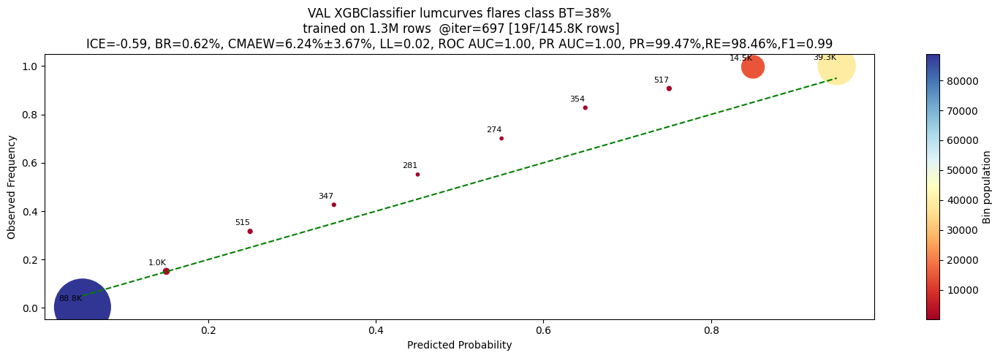

VAL XGBClassifier lumcurves flares class BT=38%
 trained on 1.3M rows  @iter=697
              precision    recall  f1-score   support

           0     0.9906    0.9968    0.9937     90271
           1     0.9947    0.9846    0.9896     55578

    accuracy                         0.9921    145849
   macro avg     0.9926    0.9907    0.9916    145849
weighted avg     0.9921    0.9921    0.9921    145849

ROC AUCs: 1=0.9994
PR AUCs: 1=0.9992
CALIBRATIONs: 
	1: MAEW=6.24%, STD=3.67%, COV=100%
BRIER LOSSes: 
	1=0.6232%
LOG_LOSSes: 
	1=0.0239
ICEs: 
	1=-0.5859
TOTAL INTEGRAL ERROR: -0.5859


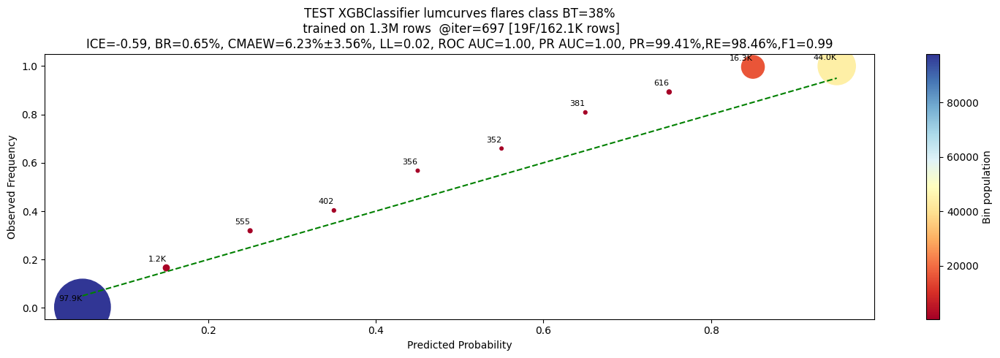

TEST XGBClassifier lumcurves flares class BT=38%
 trained on 1.3M rows  @iter=697
              precision    recall  f1-score   support

           0     0.9904    0.9963    0.9933     99599
           1     0.9941    0.9846    0.9893     62456

    accuracy                         0.9918    162055
   macro avg     0.9922    0.9905    0.9913    162055
weighted avg     0.9918    0.9918    0.9918    162055

ROC AUCs: 1=0.9994
PR AUCs: 1=0.9992
CALIBRATIONs: 
	1: MAEW=6.23%, STD=3.56%, COV=100%
BRIER LOSSes: 
	1=0.6491%
LOG_LOSSes: 
	1=0.0244
ICEs: 
	1=-0.5884
TOTAL INTEGRAL ERROR: -0.5884


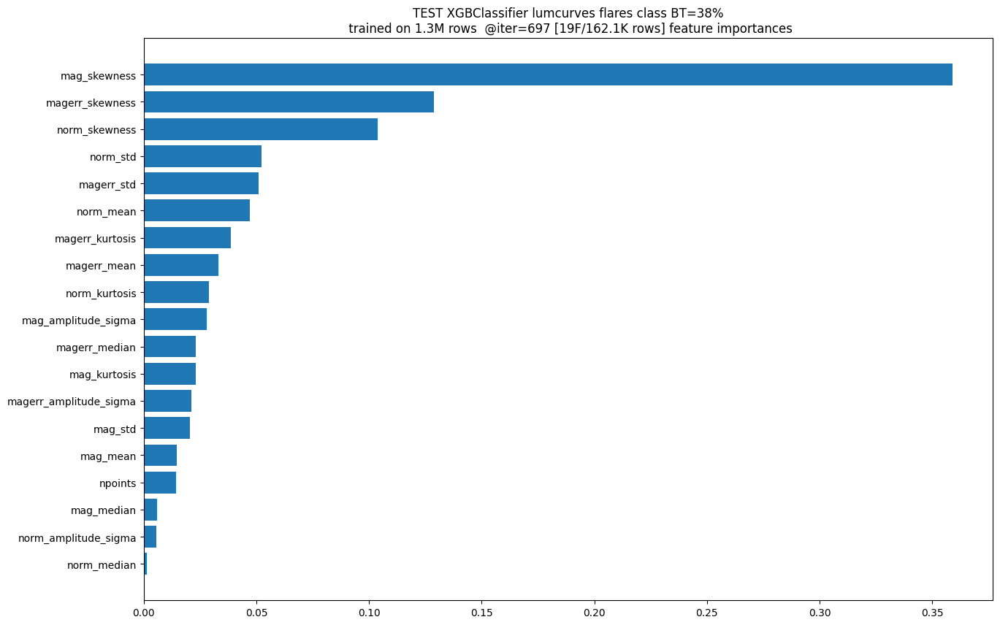

time: 1min 25s (started: 2025-12-17 09:17:58 +03:00)


In [48]:
target_name = "lumcurves"

models, metadata = train_mlframe_models_suite(
    df=features,
    target_name=target_name,
    model_name=f"flares",
    features_and_targets_extractor=ft_extractor,
    mlframe_models="xgb".split(),
    init_common_params={"show_perf_chart": True, "show_fi": True},
    use_ordinary_models=True,
    split_config=TrainingSplitConfig(shuffle_val=True, shuffle_test=True),
    use_mlframe_ensembles=True,
    data_dir="data",
    # models_dir=None,
    verbose=True,
)

# OOS features

In [8]:
def enrich_features(main_features, additional_features):
    combined = pl.concat([main_features, additional_features], how="horizontal")
    fractions = compute_fraction_features(combined)
    main_features = pl.concat(
        [combined, fractions],
        how="horizontal",
    )

    return main_features


freaky_held_out_indices = [
    5,
    12,
    36,
    41,
    43,
    47,
    87,
] + [
    66,
]

time: 15 ms (started: 2026-01-01 13:29:27 +03:00)


In [9]:
oos_df = dataset["test"].to_polars()
oos_features = extract_features_sparingly(dataset["test"])

main features: 100%|██████████████████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.35s/batch]


time: 3.5 s (started: 2026-01-01 13:29:29 +03:00)


In [10]:
additional_oos_features = extract_additional_features_sparingly(dataset["test"])
oos_features = enrich_features(oos_features, additional_oos_features)

additional features: 100%|████████████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.13s/batch]


time: 2.23 s (started: 2026-01-01 13:29:34 +03:00)


In [11]:
DATASET_NAME = "snad-space/ztf-m-dwarf-flares-2025"
HF_CACHE_DIR = r"R:\Caches\huggingface"
SPLIT = "test"
oos_wave_features = extract_wavelet_features_sparingly(
    dataset_name=DATASET_NAME,
    split=SPLIT,
    hf_cache_dir=HF_CACHE_DIR,
)

Resolving data files:   0%|          | 0/314 [00:00<?, ?it/s]

Resolving data files:   0%|          | 0/314 [00:00<?, ?it/s]

2026-01-01 13:29:46,130 - INFO - extract_wavelet_features_sparingly-line:1282 - [wavelet] Extracting features using 16 cores, wavelets=['haar', 'db4', 'sym4']
2026-01-01 13:29:46,139 - INFO - extract_wavelet_features_sparingly-line:1289 - [wavelet] Dataset small (99 < 500000), computing in-memory...


Resolving data files:   0%|          | 0/314 [00:00<?, ?it/s]

Resolving data files:   0%|          | 0/314 [00:00<?, ?it/s]

wavelet features: 100%|██████████████████████████████████████████████████████████████| 99/99 [00:00<00:00, 210.68row/s]

time: 14.9 s (started: 2026-01-01 13:29:38 +03:00)


In [12]:
oos_features = pl.concat(
    [oos_features, oos_wave_features],
    how="horizontal",
).drop("row_index")

oos_features

id,class,npoints,mag_mean,mag_std,mag_min,mag_max,mag_median,mag_q25,mag_q75,mag_skewness,mag_kurtosis,mag_entropy,mag_first,mag_last,mag_arg_min,mag_arg_max,mag_n_unique,mag_trend_changes,magerr_mean,magerr_std,magerr_min,magerr_max,magerr_median,magerr_q25,magerr_q75,magerr_skewness,magerr_kurtosis,magerr_entropy,magerr_first,magerr_last,magerr_arg_min,magerr_arg_max,magerr_n_unique,magerr_trend_changes,norm_mean,norm_std,…,mjd_diff_arg_min,mjd_diff_arg_max,mjd_diff_n_unique,mjd_diff_trend_changes,ts,norm_n_below_3sigma,norm_max_consecutive_below_2sigma,norm_rise_decay_idx_ratio,norm_n_local_minima,norm_n_zero_crossings,norm_rise_decay_time_ratio,mjd_span,norm_frac_below_3sigma,norm_max_consecutive_frac_below_2sigma,norm_frac_local_minima,norm_frac_zero_crossings,wv_haar_total_energy,wv_haar_detail_ratio,wv_haar_max_detail,wv_haar_d1_energy,wv_haar_d2_energy,wv_haar_d3_energy,wv_haar_d4_energy,wv_db4_total_energy,wv_db4_detail_ratio,wv_db4_max_detail,wv_db4_d1_energy,wv_db4_d2_energy,wv_db4_d3_energy,wv_db4_d4_energy,wv_sym4_total_energy,wv_sym4_detail_ratio,wv_sym4_max_detail,wv_sym4_d1_energy,wv_sym4_d2_energy,wv_sym4_d3_energy,wv_sym4_d4_energy
str,i32,u32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,u32,u32,u32,u32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,u32,u32,u32,u32,f32,f32,…,u32,u32,u32,u32,"datetime[μs, UTC]",i32,i32,f32,i32,i32,f32,f32,f64,f64,f64,f64,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32
"""ZTFDR257209100009778""",1,81,18.277956,0.750536,17.015057,20.387354,18.423584,17.687233,18.766064,0.2315,0.250924,4.393619,20.387354,18.864996,21,0,81,26,0.048074,0.031054,0.017062,0.183053,0.045382,0.026185,0.059344,2.5264,8.290339,4.231629,0.183053,0.064138,21,0,81,26,-3.208962,16.538218,…,2,0,3,28,2018-12-19 00:00:00 UTC,36,37,0.366667,13,2,1.660651,0.07169,0.444444,0.45679,0.160494,0.024691,24134.207031,0.35495,72.740486,5913.046387,2050.105713,322.357452,280.921997,63624.984375,0.03833,40.51878,2189.249268,168.37117,81.117088,0.0,57202.554688,0.014593,11.759074,462.936951,246.223663,125.621567,0.0
"""ZTFDR260208100017563""",1,80,19.993542,0.696953,17.942547,20.743458,20.307732,19.590908,20.544415,-1.082484,0.312565,4.381419,20.544455,19.909906,49,38,80,47,0.167013,0.05541,0.03964,0.230914,0.19325,0.125968,0.212915,-0.744423,-0.753964,4.319683,0.212918,0.155199,49,38,80,47,-1.625814,3.606474,…,0,1,3,41,2019-01-10 00:00:00 UTC,24,30,1.612903,24,11,3.998388,0.070811,0.3,0.375,0.3,0.1375,1238.986206,0.135499,7.2558,61.678265,44.895584,18.425713,42.881363,1306.994873,0.166069,10.756878,147.583221,45.375313,24.09292,0.0,1423.175659,0.073924,6.943209,21.925751,62.967041,20.314232,0.0
"""ZTFDR280214400089687""",1,96,20.389763,0.501157,18.74905,21.139164,20.576591,20.130533,20.747143,-1.102585,0.645175,4.564046,20.861336,20.375034,58,5,96,65,0.155814,0.036119,0.05539,0.211005,0.16967,0.13486,0.182202,-0.915431,-0.110681,4.534921,0.190592,0.154399,58,5,96,65,-1.101141,2.953708,…,0,1,2,45,2018-07-04 00:00:00 UTC,21,25,1.552632,33,17,2.35714,0.059836,0.21875,0.260417,0.34375,0.177083,945.216797,0.401415,15.002,240.828491,6.223735,68.68119,63.690628,992.884766,0.182333,8.429711,98.668434,43.582954,38.784275,0.0,1017.546997,0.118066,5.845948,43.955574,35.885162,40.296463,0.0
"""ZTFDR281201100016537""",1,83,19.894436,0.774005,18.632027,21.014927,19.637901,19.265348,20.693279,-0.011298,-1.517447,4.418092,20.624474,19.675564,47,24,83,48,0.120904,0.050061,0.050351,0.195758,0.099438,0.077366,0.173587,0.122181,-1.639616,4.332079,0.168845,0.101924,47,24,83,48,2.579839,7.783825,…,2,0,2,42,2019-06-02 00:00:00 UTC,24,25,1.333333,24,6,2.811501,0.063659,0.289157,0.301205,0.289157,0.072289,5521.078125,0.185223,25.353157,678.985657,230.908875,39.615719,73.120369,9911.904297,0.014606,4.400582,55.54995,35.753201,53.472855,0.0,7427.095703,0.015847,3.491476,18.665026,26.559851,72.472916,0.0
"""ZTFDR283211100006940""",1,23,19.219332,0.60785,17.624674,19.872463,19.485464,19.005825,19.649889,-1.31329

time: 94 ms (started: 2026-01-01 13:29:55 +03:00)


# OOS predictions

In [17]:
xgb_model = models["class"]["binary_classification"][0]

NameError: name 'models' is not defined

time: 110 ms (started: 2025-12-18 04:47:26 +03:00)


time: 31 ms (started: 2025-12-17 09:19:27 +03:00)


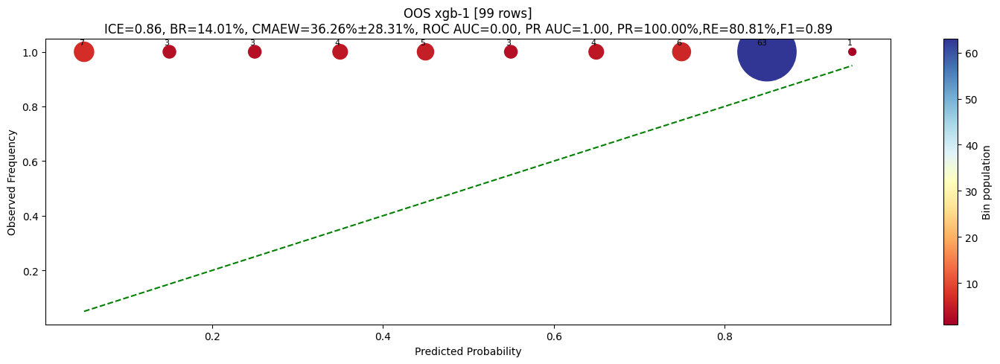

OOS xgb
              precision    recall  f1-score   support

           0       0.00      0.00      0.00         0
           1       1.00      0.19      0.32        99

    accuracy                           0.19        99
   macro avg       0.50      0.10      0.16        99
weighted avg       1.00      0.19      0.32        99

ROC AUCs: 1=0.00
PR AUCs: 1=1.00
CALIBRATIONs: 
	1: MAEW=36.26%, STD=28.31%, COV=100%
BRIER LOSSes: 
	1=14.01%
LOG_LOSSes: 
	1=None
ICEs: 
	1=0.86
TOTAL INTEGRAL ERROR: 0.0000
time: 1.34 s (started: 2025-12-17 09:19:29 +03:00)


In [51]:
probs = xgb_model.model.predict_proba(oos_features.select(xgb_model.columns))
targets = oos_features["class"].to_numpy().astype(np.int8)

model_name = "xgb"
metrics={}

_, _ = report_model_perf(
    targets=targets,
    columns=None,
    df=None,
    model_name=f"{model_name}",
    model=None,
    target_label_encoder=None,
    preds=None,
    probs=probs,
    plot_file=join(charts_dir, model_name) if charts_dir else None,
    metrics=metrics,
    group_ids=None,
    **report_params,
)

In [39]:
features.describe()

statistic,id,class,npoints,mag_std,mag_skewness,mag_kurtosis,mag_amplitude_sigma,mag_mean,mag_median,magerr_std,magerr_skewness,magerr_kurtosis,magerr_amplitude_sigma,magerr_mean,magerr_median,norm_std,norm_skewness,norm_kurtosis,norm_amplitude_sigma,norm_mean,norm_median
str,str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
"""count""","""1620543""",1.620543e6,1.620543e6,1.620543e6,1.620543e6,1.620543e6,1.620543e6,1.620543e6,1.620543e6,1.620543e6,1.620543e6,1.620543e6,1.620543e6,1.620543e6,1.620543e6,1.620543e6,1.620543e6,1.620543e6,1.620543e6,1.620543e6,1.620543e6
"""null_count""","""0""",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
"""mean""",null,0.382923,44.758756,0.142262,-0.564773,1.206014,0.558589,18.078171,18.093191,0.005657,0.119139,0.406184,0.022365,0.047981,0.047923,3.663053,-0.564773,1.206014,14.113132,-0.563894,5.3462e-9
"""std""",null,0.4861,47.487184,0.109889,1.132896,4.350833,0.420632,1.406553,1.404521,0.006455,0.885913,3.427667,0.02536,0.033665,0.033934,3.957867,1.132896,4.350833,13.177006,1.915574,0.000016
"""min""","""TIC100100909_CADENCE100163_ZTF…",0.0,10.0,0.008981,-18.206665,-1.977966,0.036306,10.68872,10.767665,2.4475e-8,-15.846914,-1.994666,9.4064e-8,0.000447,0.000391,0.817573,-18.206665,-1.977966,2.985329,-97.735992,-0.000096
"""25%""",null,0.0,11.0,0.067806,-1.318035,-0.579074,0.264031,17.288145,17.307205,0.001202,-0.342534,-0.763243,0.004533,0.022346,0.022328,1.964054,-1.318035,-0.579074,7.734026,-0.748645,0.0
"""50%""",null,0.0,16.0,0.112444,-0.434528,0.162725,0.440212,18.27652,18.29213,0.003205,0.11891,-0.206217,0.012547,0.037746,0.037624,2.441091,-0.434528,0.162725,10.288111,-0.237969,0.0
"""75%""",null,1.0,67.0,0.182657,0.202861,1.59486,0.725086,19.084057,19.09478,0.007892,0.571395,0.620411,0.031597,0.064734,0.064321,3.704263,0.202861,1.594859,15.112236,0.142319,0.0
"""max""","""ZTFDR853216400051515_MJD59034.…",1.0,345.0,3.738108,16.393195,331.324619,8.856035,21.913754,22.039047,0.099668,17.944469,326.290299,0.294939,0.287876,0.30216,258.765747,16.393195,331.324619,652.485596,189.502213,0.000098


time: 469 ms (started: 2025-12-17 07:56:24 +03:00)


In [40]:
oos_features.describe()

statistic,id,class,npoints,mag_std,mag_skewness,mag_kurtosis,mag_amplitude_sigma,mag_mean,mag_median,magerr_std,magerr_skewness,magerr_kurtosis,magerr_amplitude_sigma,magerr_mean,magerr_median,norm_std,norm_skewness,norm_kurtosis,norm_amplitude_sigma,norm_mean,norm_median
str,str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
"""count""","""99""",99.0,99.0,99.0,99.0,99.0,99.0,99.0,99.0,99.0,99.0,99.0,99.0,99.0,99.0,99.0,99.0,99.0,99.0,99.0,99.0
"""null_count""","""0""",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
"""mean""",null,1.0,63.59596,0.681275,-0.923981,0.379142,2.598441,19.914509,20.11677,0.041455,-0.481421,-0.4765,0.145456,0.120306,0.129919,6.260826,-0.923981,0.379142,23.369263,-1.876297,-7.5546e-7
"""std""",null,0.0,34.779457,0.196518,0.641567,2.560359,0.675683,1.006125,1.0197,0.014459,0.654709,1.741596,0.045848,0.037024,0.042043,4.213955,0.641567,2.560359,13.879195,2.153723,0.000006
"""min""","""ZTFDR257209100009778""",1.0,8.0,0.091329,-4.247967,-1.563847,0.232619,14.222792,14.316984,0.000194,-3.423531,-1.904199,0.000494,0.011943,0.011861,2.463627,-4.247967,-1.563847,10.046504,-17.288227,-0.000044
"""25%""",null,1.0,37.0,0.566101,-1.150626,-0.767639,2.222757,19.755405,19.990475,0.03478,-0.796393,-1.104195,0.135038,0.10416,0.110769,4.082587,-1.150626,-0.767639,16.002178,-2.144174,0.0
"""50%""",null,1.0,58.0,0.671219,-0.850493,-0.166944,2.496281,20.106346,20.307732,0.042568,-0.500746,-0.860727,0.153965,0.127027,0.134869,5.085104,-0.850493,-0.166944,19.330418,-1.571215,0.0
"""75%""",null,1.0,83.0,0.800418,-0.557255,0.502038,3.063389,20.466888,20.662922,0.05123,-0.143485,-0.484352,0.173193,0.145089,0.162092,6.908485,-0.557255,0.502038,23.966467,-0.896264,0.0
"""max""","""ZTFDR832210400037888""",1.0,172.0,1.347738,0.2315,16.815604,4.810865,21.168158,21.312328,0.074826,2.5264,11.669255,0.225938,0.195894,0.21678,27.881622,0.2315,16.815604,99.525803,2.579839,0.000019


time: 94 ms (started: 2025-12-17 07:56:49 +03:00)


# Big active ML

In [ ]:
df_target = dataset["target"].select_columns(["id"]).to_polars()
df_target

In [6]:
df_target["id"].n_unique()

94028217

time: 27.3 s (started: 2025-12-18 05:29:21 +03:00)


In [5]:
df_target

id,class,mjd,mag,magerr
str,i32,list[f64],list[f32],list[f32]
"""ZTFDR258214100040640_MJD58487.…",null,"[58487.27209, 58487.28625, … 58487.3306]","[19.939198, 20.136208, … 20.067881]","[19.939198, 20.136208, … 20.067881]"
"""ZTFDR258214100038912_MJD58487.…",null,"[58487.2689, 58487.26935, … 58487.34294]","[17.520168, 17.528702, … 17.47588]","[17.520168, 17.528702, … 17.47588]"
"""ZTFDR258214100040641_MJD58487.…",null,"[58487.26889, 58487.27072, … 58487.33974]","[18.818167, 19.06382, … 18.804058]","[18.818167, 19.06382, … 18.804058]"
"""ZTFDR258214100037040_MJD58487.…",null,"[58487.26887, 58487.26932, … 58487.34199]","[17.047787, 16.582361, … 17.054947]","[17.047787, 16.582361, … 17.054947]"
"""ZTFDR258214100025746_MJD58487.…",null,"[58487.26935, 58487.27301, … 58487.3379]","[19.442375, 20.403635, … 19.316433]","[19.442375, 20.403635, … 19.316433]"
…,…,…,…,…
"""ZTFDR1824206300019435_MJD58226…",null,"[58226.20003, 58226.20093, … 58226.23149]","[17.890526, 17.921936, … 17.938599]","[17.890526, 17.921936, … 17.938599]"
"""ZTFDR1824206300051972_MJD58229…",null,"[58229.19993, 58229.2004, … 58229.25589]","[19.924105, 20.19936, … 20.452414]","[19.924105, 20.19936, … 20.452414]"
"""ZTFDR1824206300032063_MJD58226…",null,"[58226.20044, 58226.2009, … 58226.23145]","[18.181707, 18.381504, … 18.359154]","[18.181707, 18.381504, … 18.359154]"


time: 62 ms (started: 2025-12-17 20:54:03 +03:00)


In [6]:
df_target.shape

(93960271, 5)

time: 62 ms (started: 2025-12-17 20:54:04 +03:00)


# Known flares

In [61]:
for index in freaky_held_out_indices:
    view_series(oos_df, index=index)
# npoints<25

time: 266 ms (started: 2025-12-26 16:57:08 +03:00)


In [56]:
for index in range(3):
    view_series(oos_df, index=index)

time: 47 ms (started: 2025-12-26 16:30:45 +03:00)


In [57]:
view_series(oos_df, index=43)

time: 47 ms (started: 2025-12-26 16:30:49 +03:00)


# Special events

In [ ]:
big_features 283206300181298

In [23]:
dataset["target"][index]

{'id': 'ZTFDR485206400064968_MJD58642.31972',
 'class': None,
 'mjd': [58642.31972,
  58642.32018,
  58642.32108,
  58642.32199,
  58642.32244,
  58642.3229,
  58642.32335,
  58642.32425,
  58642.32516,
  58642.32562,
  58642.32607,
  58642.32652,
  58642.32697,
  58642.32742,
  58642.32832,
  58642.32877,
  58642.32923,
  58642.32968,
  58642.33013,
  58642.33058,
  58642.33103,
  58642.33148,
  58642.33193,
  58642.33239,
  58642.33284,
  58642.33329,
  58642.33374,
  58642.33419,
  58642.33464,
  58642.33509,
  58642.33555,
  58642.336,
  58642.33645,
  58642.3369,
  58642.33735,
  58642.3378,
  58642.33825,
  58642.33871,
  58642.33961,
  58642.34006,
  58642.34051,
  58642.34141,
  58642.34187,
  58642.34232,
  58642.34277,
  58642.34368,
  58642.34413,
  58642.34459,
  58642.34594,
  58642.34639,
  58642.34684,
  58642.34728,
  58642.34775,
  58642.3482,
  58642.34865,
  58642.3491,
  58642.34955,
  58642.35,
  58642.35044,
  58642.35089,
  58642.35134,
  58642.3518,
  58642.3522

time: 15 ms (started: 2025-12-22 12:42:39 +03:00)


In [22]:
mjd = dataset["target"][index]["mjd"]
(mjd == sorted(mjd))

True

time: 16 ms (started: 2025-12-22 12:41:22 +03:00)


In [17]:
index = 40122309
view_series(dataset["target"][index], index=index, advanced=True)

time: 63 ms (started: 2025-12-22 12:39:00 +03:00)


In [8]:
index = 5555427
view_series(dataset["target"][index], index=index, advanced=True)

time: 704 ms (started: 2025-12-22 07:35:47 +03:00)


In [75]:
index = 55554273
view_series(dataset["target"][index], index=index, advanced=True)

time: 78 ms (started: 2025-12-20 05:30:25 +03:00)


In [78]:
view_series(oos_df, index=1, advanced=True)

time: 78 ms (started: 2025-12-20 05:32:41 +03:00)


In [38]:
index = 89001830
view_series(dataset["target"][index], index=index, singlepoint_min_outlying_factor=10)

time: 78 ms (started: 2025-12-21 17:44:49 +03:00)


In [83]:
(big_features.lazy().filter(pl.col("norm_skewness") < -10).select(pl.len()).collect())

len
u32
23590


time: 31 ms (started: 2025-12-27 10:32:34 +03:00)


In [84]:
for index in (
    big_features.lazy()
    .with_row_index()
    .filter(pl.col("norm_skewness") > -10)
    .sort("norm_skewness")
    .head(5)
    .select("index")
    .collect()["index"]
):
    view_series(
        dataset["target"][index], index=index, singlepoint_min_outlying_factor=0
    )

time: 4.06 s (started: 2025-12-27 10:32:36 +03:00)


In [19]:
clean_ram()

time: 22.9 s (started: 2025-12-21 12:07:16 +03:00)


In [86]:
with pl.Config(tbl_rows=30):
    display(ranked_features.sort("median_log_ratio").head(20))

feature,mean_pop,mean_rare,mean_ratio,mean_log_ratio,median_pop,median_rare,median_ratio,median_log_ratio,std_pop,std_rare,std_ratio,std_log_ratio,cohens_d_mean,cohens_d_median,max_abs_log_ratio
str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
"""mjd_diff_kurtosis""",NaN,18.558035,NaN,NaN,-0.0303,11.72448,-386.946514,-8.59599,NaN,21.757736,NaN,NaN,NaN,NaN,NaN
"""norm_mean""",0.04773,-1.876297,-39.310323,-5.296836,0.024088,-1.571215,-65.227167,-6.027401,0.887163,2.153723,2.427654,1.279563,-2.168738,-1.798204,6.027401
"""norm_first""",-0.100936,2.363058,-23.411399,-4.549139,-0.051602,1.807318,-35.024231,-5.130281,3.990919,7.588773,1.90151,0.927146,0.617399,0.465787,5.130281
"""mag_skewness""",-0.008388,-0.923981,110.160379,6.783462,0.043938,-0.850493,-19.356703,-4.274761,0.938634,0.641567,0.683511,-0.548963,-0.975453,-0.952907,6.783462
"""norm_skewness""",-0.008388,-0.923981,110.160379,6.783462,0.043938,-0.850493,-19.356696,-4.274761,0.938634,0.641567,0.683511,-0.548963,-0.975453,-0.952907,6.783462
"""norm_last""",-0.139838,1.060816,-7.58604,-2.923347,-0.079021,1.031867,-13.058116,-3.706875,3.940786,4.144145,1.051604,0.072591,0.304674,0.281895,3.706875
"""mjd_diff_median""",0.00253,0.002392,0.945292,-0.081169,0.003906,0.000463,0.118531,-3.076669,0.002954,0.007067,2.392675,1.258625,-0.046864,-1.165763,3.076669
"""mjd_diff_q75""",0.004979,0.031516,6.330305,2.662275,0.003906,0.000937,0.239997,-2.058909,0.004191,0.165195,39.416425,5.300725,6.326891,-0.707789,5.300725
"""magerr_skewness""",0.207738,-0.481421,-2.317443,-1.212534,0.21778,-0.500746,-2.299321,-1.201208,0.944219,0.654709,0.693387,-0.528268,-0.729872,-0.760974,1.212534


time: 63 ms (started: 2025-12-20 06:06:56 +03:00)


# Random events

In [37]:
for i in range(10):
    index = np.random.randint(len(big_features))
    view_series(dataset["target"][index], index=index)

time: 391 ms (started: 2025-12-19 13:34:13 +03:00)


# Big features

In [13]:
big_features = pl.read_parquet(
    r"R:\Data\Astronomy\big_features.parquet", parallel="columns"
)

_init_credential_provider_builder(): credential_provider_init = None


time: 16.1 s (started: 2026-01-01 13:29:56 +03:00)


In [14]:
additional_features = pl.read_parquet(
    r"R:\Data\Astronomy\features_additional.parquet", parallel="columns"
)

_init_credential_provider_builder(): credential_provider_init = None


time: 1.95 s (started: 2026-01-01 13:30:14 +03:00)


In [15]:
big_features = enrich_features(big_features, additional_features)
clean_ram()

time: 32.4 s (started: 2026-01-01 13:30:17 +03:00)


In [16]:
wave_features = (
    pl.scan_parquet(
        r"R:\Data\Astronomy\\wavelet_chunks_haar_db4_sym4\wavelet_chunk_*.parquet"
    )
    .sort("row_index")
    .collect()
).drop("row_index")

_init_credential_provider_builder(): credential_provider_init = None


time: 23.9 s (started: 2026-01-01 13:30:51 +03:00)


In [17]:
wave_features

wv_haar_total_energy,wv_haar_detail_ratio,wv_haar_max_detail,wv_haar_d1_energy,wv_haar_d2_energy,wv_haar_d3_energy,wv_haar_d4_energy,wv_db4_total_energy,wv_db4_detail_ratio,wv_db4_max_detail,wv_db4_d1_energy,wv_db4_d2_energy,wv_db4_d3_energy,wv_db4_d4_energy,wv_sym4_total_energy,wv_sym4_detail_ratio,wv_sym4_max_detail,wv_sym4_d1_energy,wv_sym4_d2_energy,wv_sym4_d3_energy,wv_sym4_d4_energy
f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32
572.757019,0.736857,5.537032,54.870945,38.500065,134.111008,194.558075,932.216431,0.46287,4.83052,52.687946,55.213425,111.896889,211.697098,1112.22644,0.36383,6.063162,34.442116,55.259659,100.416679,214.543198
1203.162842,0.546378,7.45773,96.992722,86.748764,194.110001,279.53064,1731.461548,0.371283,6.504838,80.010864,90.393127,177.295868,295.163208,1772.80896,0.343813,7.605155,56.916775,83.120934,200.13475,269.34317
550.752625,0.583891,4.384292,39.158878,60.828053,69.856407,151.735962,489.563171,0.722925,3.850207,25.356268,92.933731,74.960457,160.666977,516.798157,0.724062,4.785738,36.337414,83.709175,96.503784,157.643738
150.692749,0.748046,7.717164,59.554619,0.645609,17.362947,35.16188,164.142197,0.359696,3.899971,59.041279,0.0,0.0,0.0,154.407349,0.258836,4.242571,39.966137,0.0,0.0,0.0
128.596466,0.869457,4.159596,24.811663,17.522402,32.21439,37.260605,141.757614,0.422672,3.110437,19.152296,40.764713,0.0,0.0,142.675217,0.444459,2.520229,25.378376,38.034863,0.0,0.0
…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…
258.655426,0.885782,6.586214,21.52788,62.095612,54.001156,91.487755,299.391907,0.298447,4.502221,89.352547,0.0,0.0,0.0,303.714111,0.347323,6.913197,105.486938,0.0,0.0,0.0
277.974548,0.764947,6.616033,2.551845,22.980484,31.8559,155.247513,443.1633,0.471118,6.812099,65.298714,143.483292,0.0,0.0,426.535645,0.641032,7.004133,43.833157,229.589752,0.0,0.0
138.872711,0.732256,4.913523,10.800043,27.820265,21.851599,41.218452,137.335358,0.466337,4.777255,64.04451,0.0,0.0,0.0,137.003998,0.430348,4.790569,58.959393,0.0,0.0,0.0


time: 78 ms (started: 2026-01-01 13:31:17 +03:00)


In [18]:
big_features = pl.concat(
    [big_features, wave_features],
    how="horizontal",
)
clean_ram()

time: 7.39 s (started: 2026-01-01 13:31:19 +03:00)


In [19]:
big_features

id,class,npoints,mag_mean,mag_std,mag_min,mag_max,mag_median,mag_q25,mag_q75,mag_skewness,mag_kurtosis,mag_entropy,mag_first,mag_last,mag_arg_min,mag_arg_max,mag_n_unique,mag_trend_changes,magerr_mean,magerr_std,magerr_min,magerr_max,magerr_median,magerr_q25,magerr_q75,magerr_skewness,magerr_kurtosis,magerr_entropy,magerr_first,magerr_last,magerr_arg_min,magerr_arg_max,magerr_n_unique,magerr_trend_changes,norm_mean,norm_std,…,mjd_diff_arg_min,mjd_diff_arg_max,mjd_diff_n_unique,mjd_diff_trend_changes,ts,norm_n_below_3sigma,norm_max_consecutive_below_2sigma,norm_rise_decay_idx_ratio,norm_n_local_minima,norm_n_zero_crossings,norm_rise_decay_time_ratio,mjd_span,norm_frac_below_3sigma,norm_max_consecutive_frac_below_2sigma,norm_frac_local_minima,norm_frac_zero_crossings,wv_haar_total_energy,wv_haar_detail_ratio,wv_haar_max_detail,wv_haar_d1_energy,wv_haar_d2_energy,wv_haar_d3_energy,wv_haar_d4_energy,wv_db4_total_energy,wv_db4_detail_ratio,wv_db4_max_detail,wv_db4_d1_energy,wv_db4_d2_energy,wv_db4_d3_energy,wv_db4_d4_energy,wv_sym4_total_energy,wv_sym4_detail_ratio,wv_sym4_max_detail,wv_sym4_d1_energy,wv_sym4_d2_energy,wv_sym4_d3_energy,wv_sym4_d4_energy
str,i32,u32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,u32,u32,u32,u32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,u32,u32,u32,u32,f32,f32,…,u32,u32,u32,u32,"datetime[μs, UTC]",i32,i32,f32,i32,i32,f32,f32,f64,f64,f64,f64,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32
"""ZTFDR257201100001119_MJD58471.…",null,174,18.913832,0.135884,18.501698,19.387657,18.921986,18.840481,18.985106,-0.112987,1.3233,5.15903,18.605858,19.062325,76,31,174,116,0.075098,0.007802,0.054352,0.106575,0.075198,0.07063,0.07892,0.364245,1.68334,5.153715,0.058914,0.083698,76,31,174,116,-0.1084,1.807023,…,0,4,2,66,2018-12-19 00:00:00 UTC,9,3,0.785714,58,75,0.825431,0.08585,0.051724,0.017241,0.333333,0.431034,572.757019,0.736857,5.537032,54.870945,38.500065,134.111008,194.558075,932.216431,0.46287,4.83052,52.687946,55.213425,111.896889,211.697098,1112.22644,0.36383,6.063162,34.442116,55.259659,100.416679,214.543198
"""ZTFDR257201100031205_MJD58471.…",null,188,18.212538,0.109453,17.842152,18.584852,18.216366,18.15344,18.284317,-0.24003,0.994606,5.236424,18.096306,18.348726,77,138,188,114,0.043691,0.003615,0.033012,0.057963,0.043653,0.041616,0.045977,0.176193,1.273714,5.233038,0.039858,0.048305,77,138,188,114,-0.08771,2.507348,…,0,5,2,66,2018-12-19 00:00:00 UTC,25,8,0.702703,57,51,0.693628,0.08585,0.132979,0.042553,0.303191,0.271277,1203.162842,0.546378,7.45773,96.992722,86.748764,194.110001,279.53064,1731.461548,0.371283,6.504838,80.010864,90.393127,177.295868,295.163208,1772.80896,0.343813,7.605155,56.916775,83.120934,200.13475,269.34317
"""ZTFDR257201100048647_MJD58472.…",null,129,19.074141,0.154115,18.715588,19.509781,19.063267,18.969311,19.167679,0.39769,0.219762,4.85978,19.011953,19.295404,26,6,129,86,0.084942,0.010087,0.064136,0.116274,0.083758,0.077974,0.09062,0.702977,0.6787,4.852957,0.080553,0.099639,26,6,129,86,0.129762,1.840007,…,0,1,2,65,2018-12-20 00:00:00 UTC,3,4,0.262136,43,53,0.293119,0.08457,0.023256,0.031008,0.333333,0.410853,550.752625,0.583891,4.384292,39.158878,60.828053,69.856407,151.735962,489.563171,0.722925,3.850207,25.356268,92.933731,74.960457,160.666977,516.798157,0.724062,4.785738,36.337414,83.709175,96.503784,157.643738
"""ZTFDR257201100051826_MJD58472.…",null,19,19.37347,0.272342,18.896191,19.884975,19.37619,19.112148,19.570467,0.124072,-0.824714,2.944345,19.077137,19.579378,6,13,19,10,0.106831,0.020874,0.073723,0.148942,0.105694,0.086914,0.121298,0.346468,-0.714802,2.926517,0.084643,0.122046,6,13,19,10,-0.025736,2.5767,…,1,2,4,16,2018-12-20 00:00:00 UTC,1,3,0.538462,5,7,0.94341,0.07727,0.052632,0.157895,0.263158,0.368421,150.692749,0.748046,7.717164,59.554619,0.645609,17.362947,35.16188,164.142197,0.359696,3.899971,59.041279,0.0,0.0,0.0,154.407349,0.258836,4.242571,39.966137,0.0,0.0,0.0
"""ZTFDR257201100011565_MJD58471.…",null,48,19.7246,0.

time: 109 ms (started: 2026-01-01 13:31:28 +03:00)


## Computing additional features

In [7]:
additional_features = extract_additional_features_sparingly(
    dataset["target"].select(range(5000000))
)
additional_features

_init_credential_provider_builder(): credential_provider_init = None
2025-12-20 10:04:59,760 - INFO - extract_additional_features_sparingly-line:910 - [additional] Cache invalid (500000 vs 5000000), recomputing...
2025-12-20 10:04:59,766 - INFO - extract_additional_features_sparingly-line:912 - [additional] Computing flare-specific features...
_init_credential_provider_builder(): credential_provider_init = None
2025-12-20 10:06:54,696 - INFO - extract_additional_features_sparingly-line:1047 -     Saved to data\features_additional.parquet


norm_n_below_3sigma,norm_max_consecutive_below_2sigma,norm_rise_decay_idx_ratio,norm_rise_decay_time_ratio,mjd_span,norm_n_local_minima,norm_n_zero_crossings
i32,i32,f32,f32,f32,i32,i32
9,3,0.785714,0.825431,0.08585,58,75
25,8,0.702703,0.693628,0.08585,57,51
3,4,0.262136,0.293119,0.08457,43,53
1,3,0.538462,0.94341,0.07727,5,7
3,5,0.53125,0.74533,0.08128,16,21
…,…,…,…,…,…,…
3,1,6.0,4.996633,0.03562,12,20
5,2,5.666667,12.53398,0.05576,5,9
9,3,1.875,1.953378,0.03104,6,9


time: 2min 2s (started: 2025-12-20 10:04:59 +03:00)


In [ ]:
additional_features = extract_additional_features_sparingly(dataset["target"])
additional_features

## Computing big features

In [8]:
test_features = extract_features_sparingly(
    dataset["target"].select(range(5000)), engine="streaming"
)
test_features

2025-12-18 13:38:00,368 - INFO - load_or_compute-line:441 - [1/6] Computing mag features...
_init_credential_provider_builder(): credential_provider_init = None
2025-12-18 13:38:01,260 - INFO - load_or_compute-line:446 -     Saved to data\features_mag.parquet
2025-12-18 13:38:01,931 - INFO - load_or_compute-line:441 - [2/6] Computing magerr features...
_init_credential_provider_builder(): credential_provider_init = None
2025-12-18 13:38:02,815 - INFO - load_or_compute-line:446 -     Saved to data\features_magerr.parquet
2025-12-18 13:38:03,467 - INFO - load_or_compute-line:441 - [3/6] Computing norm features...
_init_credential_provider_builder(): credential_provider_init = None
2025-12-18 13:38:04,328 - INFO - load_or_compute-line:446 -     Saved to data\features_norm.parquet
2025-12-18 13:38:05,034 - INFO - load_or_compute-line:441 - [4/6] Computing mjd_diff features...
_init_credential_provider_builder(): credential_provider_init = None
2025-12-18 13:38:06,018 - INFO - load_or_compu

id,class,npoints,mag_mean,mag_std,mag_min,mag_max,mag_median,mag_q25,mag_q75,mag_skewness,mag_kurtosis,mag_entropy,mag_first,mag_last,mag_arg_min,mag_arg_max,mag_n_unique,mag_trend_changes,magerr_mean,magerr_std,magerr_min,magerr_max,magerr_median,magerr_q25,magerr_q75,magerr_skewness,magerr_kurtosis,magerr_entropy,magerr_first,magerr_last,magerr_arg_min,magerr_arg_max,magerr_n_unique,magerr_trend_changes,norm_mean,norm_std,norm_min,norm_max,norm_median,norm_q25,norm_q75,norm_skewness,norm_kurtosis,norm_first,norm_last,norm_arg_min,norm_arg_max,norm_n_unique,norm_trend_changes,mjd_diff_mean,mjd_diff_std,mjd_diff_min,mjd_diff_max,mjd_diff_median,mjd_diff_q25,mjd_diff_q75,mjd_diff_skewness,mjd_diff_kurtosis,mjd_diff_entropy,mjd_diff_first,mjd_diff_last,mjd_diff_arg_min,mjd_diff_arg_max,mjd_diff_n_unique,mjd_diff_trend_changes,ts
str,i32,u32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,u32,u32,u32,u32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,u32,u32,u32,u32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,u32,u32,u32,u32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,u32,u32,u32,u32,"datetime[μs, UTC]"
"""ZTFDR257201100001119_MJD58471.…",null,174,18.913832,0.135884,18.501698,19.387657,18.921986,18.840481,18.985106,-0.112987,1.3233,5.15903,18.605858,19.062325,76,31,174,116,0.075098,0.007802,0.054352,0.106575,0.075198,0.07063,0.07892,0.364245,1.68334,5.153715,0.058914,0.083698,76,31,174,116,-0.1084,1.807023,-5.589094,6.192615,0.0,-1.083871,0.839384,-0.112987,1.3233,-4.203945,1.866261,76,31,174,116,0.000496,0.000139,0.00045,0.00138,0.00046,0.00045,0.00046,3.5539,12.874785,5.122674,0.00045,0.00045,0,70,13,152,2018-12-19 00:00:00 UTC
"""ZTFDR257201100031205_MJD58471.…",null,188,18.212538,0.109453,17.842152,18.584852,18.216366,18.15344,18.284317,-0.24003,0.994606,5.236424,18.096306,18.348726,77,138,188,114,0.043691,0.003615,0.033012,0.057963,0.043653,0.041616,0.045977,0.176193,1.273714,5.233038,0.039858,0.048305,77,138,188,114,-0.08771,2.507348,-8.572489,8.441278,0.0,-1.441492,1.556625,-0.24003,0.994606,-2.750331,3.03211,77,138,188,114,0.000459,0.000033,0.00045,0.0009,0.00046,0.00045,0.00046,12.628547,165.25676,5.229053,0.00045,0.00046,0,176,7,166,2018-12-19 00:00:00 UTC
"""ZTFDR257201100048647_MJD58472.…",null,129,19.074141,0.154115,18.715588,19.509781,19.063267,18.969311,19.167679,0.39769,0.219762,4.85978,19.011953,19.295404,26,6,129,86,0.084942,0.010087,0.064136,0.116274,0.083758,0.077974,0.09062,0.702977,0.6787,4.852957,0.080553,0.099639,26,6,129,86,0.129762,1.840007,-4.150992,5.330997,0.0,-1.121754,1.246591,0.39769,0.219762,-0.612638,2.771526,26,6,129,86,0.000661,0.000383,0.00045,0.00228,0.00046,0.00045,0.00091,2.125184,4.139797,4.720881,0.00091,0.00045,5,52,19,95,2018-12-20 00:00:00 UTC
"""ZTFDR257201100051826_MJD58472.…",null,19,19.37347,0.272342,18.896191,19.884975,19.37619,19.112148,19.570467,0.124072,-0.824714,2.944345,19.077137,19.579378,6,13,19,10,0.106831,0.020874,0.073723,0.148942,0.105694,0.086914,0.121298,0.346468,-0.714802,2.926517,0.084643,0.122046,6,13,19,10,-0.025736,2.5767,-4.541409,4.813759,0.0,-2.498174,1.838107,0.124072,-0.824714,-2.829426,1.922418,6,13,19,10,0.004293,0.004313,0.00046,0.01508,0.002745,0.00137,0.00502,1.540015,1.349784,2.488526,0.00274,0.00046,17,8,18,10,2018-12-20 00:00:00 UTC
"""ZTFDR257201100011565_MJD58471.…",null,48,19.7246,0.22452,19.075207,20.159521,19.771763,19.631021,19.851671,-0.834665,0.633071,3.871137,19.602474,19.935028,16,24,48,32,0.135178,0.018889,0.08452,0.173324,0.138759,0.126432,0.145932,-0.649473,0.241762,3.861241,0.123997,0.153471,16,24,48,32,-0.339897,1.618055,-5.019882,2.794463,0.000007,-1.014283,0.575877,-0.834665,0.633071,-1.220015,1.176606,16,24,48,32,0.001729,0.001576,0.00045,0.00731,0.00136,0.00046,0.00229,1.621449,2.446616,3.508264,0.00548,0.00046,5,13,23,28,2018-12-19 00:00:00 UTC
…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…
"""ZTFDR257201400028131_MJD58472.…",null,115,17.72

time: 7.94 s (started: 2025-12-18 13:38:00 +03:00)


In [7]:
clean_ram()

time: 1.03 s (started: 2025-12-18 22:16:11 +03:00)


In [ ]:
big_features = extract_features_sparingly(dataset["target"], engine="cpu")
big_features

2025-12-18 13:43:48,284 - INFO - load_or_compute-line:441 - [1/6] Computing mag features...
_init_credential_provider_builder(): credential_provider_init = None
2025-12-18 14:57:29,283 - INFO - load_or_compute-line:446 -     Saved to data\features_mag.parquet
2025-12-18 14:57:50,734 - INFO - load_or_compute-line:441 - [2/6] Computing magerr features...


In [6]:
big_features = extract_features_sparingly(dataset["target"], engine="cpu")
big_features

2025-12-18 23:11:45,377 - INFO - extract_features_sparingly-line:584 - Low RAM mode: 127.9GB < 512GB threshold
2025-12-18 23:11:45,381 - INFO - extract_features_sparingly-line:723 - Pass 1: Computing and caching all features...
_init_credential_provider_builder(): credential_provider_init = None
2025-12-18 23:11:45,778 - INFO - compute_and_save-line:604 - [mag] mag features already cached, skipping...
_init_credential_provider_builder(): credential_provider_init = None
2025-12-18 23:11:46,103 - INFO - compute_and_save-line:604 - [magerr] magerr features already cached, skipping...
2025-12-18 23:11:46,111 - INFO - compute_and_save-line:607 - [norm] Computing norm features...
_init_credential_provider_builder(): credential_provider_init = None
2025-12-19 00:00:04,627 - INFO - compute_and_save-line:610 -     Saved to data\features_norm.parquet
2025-12-19 00:00:06,888 - INFO - compute_and_save-line:607 - [mjd_diff] Computing mjd_diff features...
_init_credential_provider_builder(): credent

id,class,npoints,mag_mean,mag_std,mag_min,mag_max,mag_median,mag_q25,mag_q75,mag_skewness,mag_kurtosis,mag_entropy,mag_first,mag_last,mag_arg_min,mag_arg_max,mag_n_unique,mag_trend_changes,magerr_mean,magerr_std,magerr_min,magerr_max,magerr_median,magerr_q25,magerr_q75,magerr_skewness,magerr_kurtosis,magerr_entropy,magerr_first,magerr_last,magerr_arg_min,magerr_arg_max,magerr_n_unique,magerr_trend_changes,norm_mean,norm_std,norm_min,norm_max,norm_median,norm_q25,norm_q75,norm_skewness,norm_kurtosis,norm_first,norm_last,norm_arg_min,norm_arg_max,norm_n_unique,norm_trend_changes,mjd_diff_mean,mjd_diff_std,mjd_diff_min,mjd_diff_max,mjd_diff_median,mjd_diff_q25,mjd_diff_q75,mjd_diff_skewness,mjd_diff_kurtosis,mjd_diff_entropy,mjd_diff_first,mjd_diff_last,mjd_diff_arg_min,mjd_diff_arg_max,mjd_diff_n_unique,mjd_diff_trend_changes,ts
str,i32,u32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,u32,u32,u32,u32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,u32,u32,u32,u32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,u32,u32,u32,u32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,u32,u32,u32,u32,"datetime[μs, UTC]"
"""ZTFDR257201100001119_MJD58471.…",null,174,18.913832,0.135884,18.501698,19.387657,18.921986,18.840481,18.985106,-0.112987,1.3233,5.15903,18.605858,19.062325,76,31,174,116,0.075098,0.007802,0.054352,0.106575,0.075198,0.07063,0.07892,0.364245,1.68334,5.153715,0.058914,0.083698,76,31,174,116,-0.1084,1.807023,-5.589094,6.192615,0.0,-1.083871,0.839384,-0.112987,1.3233,-4.203945,1.866261,76,31,174,116,0.000497,0.001305,0.0,0.003906,0.0,0.0,0.0,2.238154,3.009332,NaN,0.0,0.0,0,4,2,66,2018-12-19 00:00:00 UTC
"""ZTFDR257201100031205_MJD58471.…",null,188,18.212538,0.109453,17.842152,18.584852,18.216366,18.15344,18.284317,-0.24003,0.994606,5.236424,18.096306,18.348726,77,138,188,114,0.043691,0.003615,0.033012,0.057963,0.043653,0.041616,0.045977,0.176193,1.273714,5.233038,0.039858,0.048305,77,138,188,114,-0.08771,2.507348,-8.572489,8.441278,0.0,-1.441492,1.556625,-0.24003,0.994606,-2.750331,3.03211,77,138,188,114,0.00046,0.001262,0.0,0.003906,0.0,0.0,0.0,2.373464,3.633333,NaN,0.0,0.0,0,5,2,66,2018-12-19 00:00:00 UTC
"""ZTFDR257201100048647_MJD58472.…",null,129,19.074141,0.154115,18.715588,19.509781,19.063267,18.969311,19.167679,0.39769,0.219762,4.85978,19.011953,19.295404,26,6,129,86,0.084942,0.010087,0.064136,0.116274,0.083758,0.077974,0.09062,0.702977,0.6787,4.852957,0.080553,0.099639,26,6,129,86,0.129762,1.840007,-4.150992,5.330997,0.0,-1.121754,1.246591,0.39769,0.219762,-0.612638,2.771526,26,6,129,86,0.000671,0.00148,0.0,0.003906,0.0,0.0,0.0,1.739462,1.025729,NaN,0.0,0.0,0,1,2,65,2018-12-20 00:00:00 UTC
"""ZTFDR257201100051826_MJD58472.…",null,19,19.37347,0.272342,18.896191,19.884975,19.37619,19.112148,19.570467,0.124072,-0.824714,2.944345,19.077137,19.579378,6,13,19,10,0.106831,0.020874,0.073723,0.148942,0.105694,0.086914,0.121298,0.346468,-0.714802,2.926517,0.084643,0.122046,6,13,19,10,-0.025736,2.5767,-4.541409,4.813759,0.0,-2.498174,1.838107,0.124072,-0.824714,-2.829426,1.922418,6,13,19,10,0.00434,0.004993,0.0,0.015625,0.003906,0.0,0.003906,1.353805,0.759936,NaN,0.003906,0.0,1,2,4,16,2018-12-20 00:00:00 UTC
"""ZTFDR257201100011565_MJD58471.…",null,48,19.7246,0.22452,19.075207,20.159521,19.771763,19.631021,19.851671,-0.834665,0.633071,3.871137,19.602474,19.935028,16,24,48,32,0.135178,0.018889,0.08452,0.173324,0.138759,0.126432,0.145932,-0.649473,0.241762,3.861241,0.123997,0.153471,16,24,48,32,-0.339897,1.618055,-5.019882,2.794463,0.000007,-1.014283,0.575877,-0.834665,0.633071,-1.220015,1.176606,16,24,48,32,0.001745,0.002276,0.0,0.0078125,0.0,0.0,0.003906,0.874692,-0.235138,NaN,0.003906,0.0,3,13,3,38,2018-12-19 00:00:00 UTC
…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…
"""ZTFDR1824216400046147_MJD58229…",null,26,19.558136,0.315779,18.933319,20.113304,19.600155,19.377138,19.767147,-0.305537,-0.725756,3.257971,19.4076,19.159927,5,22,26,16,0.10060

time: 2h 44min 56s (started: 2025-12-18 23:11:45 +03:00)


In [ ]:
big_features.write_parquet("big_features.parquet", compression="zstd")

# Ranking individual features

In [29]:
ranked_features = rank_discriminative_features(big_features, oos_features)
ranked_features

feature,mean_pop,mean_rare,mean_ratio,mean_log_ratio,median_pop,median_rare,median_ratio,median_log_ratio,std_pop,std_rare,std_ratio,std_log_ratio,cohens_d_mean,cohens_d_median,max_abs_log_ratio
str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
"""mjd_diff_kurtosis""",NaN,6.737611,NaN,NaN,-0.08284,2.653846,-32.035717,-5.001609,NaN,11.620858,NaN,NaN,NaN,NaN,NaN
"""mjd_diff_entropy""",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
"""mjd_diff_skewness""",NaN,2.234664,NaN,NaN,1.058266,1.98089,1.871827,0.904447,NaN,1.377353,NaN,NaN,NaN,NaN,NaN
"""wv_haar_d4_energy""",172.692307,85.012329,0.492276,-1.02246,0.0,60.260479,6.0260e11,39.132421,806.907227,116.067894,0.143843,-2.797434,-0.108662,0.074681,39.132421
"""wv_sym4_d2_energy""",98.568832,117.247536,1.189499,0.250354,0.0,42.454033,4.2454e11,38.627111,535.977295,299.184723,0.558204,-0.841135,0.03485,0.079209,38.627111
…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…
"""mag_min""",17.992857,18.217197,1.012468,0.017877,18.233477,18.424438,1.010473,0.015031,1.231929,1.024751,0.831826,-0.265646,0.182105,0.155011,0.265646
"""mag_last""",18.286016,20.246765,1.107227,0.146951,18.513449,20.375034,1.100553,0.138229,1.355093,1.135964,0.838292,-0.254475,1.446948,1.37377,0.254475
"""norm_frac_local_minima""",0.29013,0.259264,0.893615,-0.162274,0.3,0.268293,0.894309,-0.161155,0.059483,0.050514,0.849211,-0.235806,-0.51889,-0.533045,0.235806


time: 20.5 s (started: 2025-12-24 05:53:28 +03:00)


In [30]:
ranked_features.sort("median_log_ratio").head(10)

feature,mean_pop,mean_rare,mean_ratio,mean_log_ratio,median_pop,median_rare,median_ratio,median_log_ratio,std_pop,std_rare,std_ratio,std_log_ratio,cohens_d_mean,cohens_d_median,max_abs_log_ratio
str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
"""row_index""",2.4000e7,49.0,0.000002,-18.901751,2.4000e7,49.0,0.000002,-18.901751,1.3856e7,28.722813,0.000002,-18.879855,-1.732049,-1.732049,18.901751
"""mjd_diff_kurtosis""",NaN,6.737611,NaN,NaN,-0.08284,2.653846,-32.035717,-5.001609,NaN,11.620858,NaN,NaN,NaN,NaN,NaN
"""norm_mean""",0.076819,-1.876297,-24.424901,-4.610281,0.052166,-1.571215,-30.119516,-4.912627,0.870555,2.153723,2.473965,1.306825,-2.243518,-1.864755,4.912627
"""norm_first""",-0.124815,2.363058,-18.932533,-4.242796,-0.079276,1.807318,-22.797852,-4.510826,3.923413,7.588773,1.934228,0.951758,0.634108,0.480854,4.510826
"""mag_skewness""",0.034788,-0.923981,-26.560308,-4.7312,0.091479,-0.850493,-9.297097,-3.21678,0.958915,0.641567,0.669055,-0.579803,-0.999848,-0.982332,4.7312
"""norm_skewness""",0.034788,-0.923981,-26.560308,-4.7312,0.091479,-0.850493,-9.297096,-3.21678,0.958915,0.641567,0.669055,-0.579803,-0.999848,-0.982332,4.7312
"""wv_db4_detail_ratio""",0.474865,0.107452,0.226279,-2.143828,0.476999,0.085013,0.178224,-2.488238,0.233642,0.09642,0.412683,-1.276893,-1.572551,-1.677725,2.488238
"""wv_sym4_detail_ratio""",0.494039,0.124945,0.252905,-1.983333,0.500602,0.103728,0.207206,-2.270862,0.215473,0.109554,0.508435,-0.975865,-1.712948,-1.841875,2.270862
"""norm_frac_zero_crossings""",0.431579,0.139878,0.324108,-1.625455,0.44,0.121951,0.277162,-1.851199,0.129418,0.094094,0.727052,-0.459869,-2.253941,-2.457529,1.851199


time: 16 ms (started: 2025-12-24 05:53:49 +03:00)


In [31]:
ranked_features.sort("cohens_d_mean").head(10)

feature,mean_pop,mean_rare,mean_ratio,mean_log_ratio,median_pop,median_rare,median_ratio,median_log_ratio,std_pop,std_rare,std_ratio,std_log_ratio,cohens_d_mean,cohens_d_median,max_abs_log_ratio
str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
"""norm_min""",-5.378806,-17.275366,3.211747,1.683358,-4.34484,-13.972876,3.21597,1.685254,4.150403,11.15953,2.688782,1.426953,-2.866345,-2.319769,1.685254
"""norm_q25""",-1.642307,-5.187131,3.158442,1.659213,-1.30176,-4.253629,3.267598,1.70823,1.490383,4.29655,2.882849,1.527495,-2.378447,-1.980596,1.70823
"""norm_frac_zero_crossings""",0.431579,0.139878,0.324108,-1.625455,0.44,0.121951,0.277162,-1.851199,0.129418,0.094094,0.727052,-0.459869,-2.253941,-2.457529,1.851199
"""norm_mean""",0.076819,-1.876297,-24.424901,-4.610281,0.052166,-1.571215,-30.119516,-4.912627,0.870555,2.153723,2.473965,1.306825,-2.243518,-1.864755,4.912627
"""row_index""",2.4000e7,49.0,0.000002,-18.901751,2.4000e7,49.0,0.000002,-18.901751,1.3856e7,28.722813,0.000002,-18.879855,-1.732049,-1.732049,18.901751
"""wv_sym4_detail_ratio""",0.494039,0.124945,0.252905,-1.983333,0.500602,0.103728,0.207206,-2.270862,0.215473,0.109554,0.508435,-0.975865,-1.712948,-1.841875,2.270862
"""wv_haar_detail_ratio""",0.767412,0.433941,0.56546,-0.822502,0.831849,0.396227,0.476321,-1.069994,0.203545,0.237589,1.167253,0.223117,-1.638314,-2.140171,1.069994
"""wv_db4_detail_ratio""",0.474865,0.107452,0.226279,-2.143828,0.476999,0.085013,0.178224,-2.488238,0.233642,0.09642,0.412683,-1.276893,-1.572551,-1.677725,2.488238
"""norm_skewness""",0.034788,-0.923981,-26.560308,-4.7312,0.091479,-0.850493,-9.297096,-3.21678,0.958915,0.641567,0.669055,-0.579803,-0.999848,-0.982332,4.7312


time: 31 ms (started: 2025-12-24 05:56:08 +03:00)


In [32]:
ranked_features.sort("cohens_d_median").head(10)

feature,mean_pop,mean_rare,mean_ratio,mean_log_ratio,median_pop,median_rare,median_ratio,median_log_ratio,std_pop,std_rare,std_ratio,std_log_ratio,cohens_d_mean,cohens_d_median,max_abs_log_ratio
str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
"""norm_frac_zero_crossings""",0.431579,0.139878,0.324108,-1.625455,0.44,0.121951,0.277162,-1.851199,0.129418,0.094094,0.727052,-0.459869,-2.253941,-2.457529,1.851199
"""norm_min""",-5.378806,-17.275366,3.211747,1.683358,-4.34484,-13.972876,3.21597,1.685254,4.150403,11.15953,2.688782,1.426953,-2.866345,-2.319769,1.685254
"""wv_haar_detail_ratio""",0.767412,0.433941,0.56546,-0.822502,0.831849,0.396227,0.476321,-1.069994,0.203545,0.237589,1.167253,0.223117,-1.638314,-2.140171,1.069994
"""norm_q25""",-1.642307,-5.187131,3.158442,1.659213,-1.30176,-4.253629,3.267598,1.70823,1.490383,4.29655,2.882849,1.527495,-2.378447,-1.980596,1.70823
"""norm_mean""",0.076819,-1.876297,-24.424901,-4.610281,0.052166,-1.571215,-30.119516,-4.912627,0.870555,2.153723,2.473965,1.306825,-2.243518,-1.864755,4.912627
"""wv_sym4_detail_ratio""",0.494039,0.124945,0.252905,-1.983333,0.500602,0.103728,0.207206,-2.270862,0.215473,0.109554,0.508435,-0.975865,-1.712948,-1.841875,2.270862
"""row_index""",2.4000e7,49.0,0.000002,-18.901751,2.4000e7,49.0,0.000002,-18.901751,1.3856e7,28.722813,0.000002,-18.879855,-1.732049,-1.732049,18.901751
"""wv_db4_detail_ratio""",0.474865,0.107452,0.226279,-2.143828,0.476999,0.085013,0.178224,-2.488238,0.233642,0.09642,0.412683,-1.276893,-1.572551,-1.677725,2.488238
"""mjd_diff_median""",0.002504,0.001993,0.79589,-0.329359,0.003906,0.0,0.0,33.219281,0.002513,0.007329,2.916995,1.544483,-0.20338,-1.554684,33.219281


time: 31 ms (started: 2025-12-24 05:56:29 +03:00)


In [33]:
ranked_features.sort("max_abs_log_ratio", descending=True).filter(
    ~pl.col("max_abs_log_ratio").is_nan()
).head(10)

feature,mean_pop,mean_rare,mean_ratio,mean_log_ratio,median_pop,median_rare,median_ratio,median_log_ratio,std_pop,std_rare,std_ratio,std_log_ratio,cohens_d_mean,cohens_d_median,max_abs_log_ratio
str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
"""wv_haar_d4_energy""",172.692307,85.012329,0.492276,-1.02246,0.0,60.260479,6.0260e11,39.132421,806.907227,116.067894,0.143843,-2.797434,-0.108662,0.074681,39.132421
"""wv_sym4_d2_energy""",98.568832,117.247536,1.189499,0.250354,0.0,42.454033,4.2454e11,38.627111,535.977295,299.184723,0.558204,-0.841135,0.03485,0.079209,38.627111
"""wv_db4_d2_energy""",100.771194,89.912125,0.89224,-0.164496,0.0,38.912598,3.8913e11,38.501446,550.231445,220.839539,0.401358,-1.31704,-0.019735,0.07072,38.501446
"""wv_db4_d3_energy""",113.770164,63.598812,0.559011,-0.839051,0.0,22.149937,2.2150e11,37.688512,646.183044,233.494659,0.361344,-1.468553,-0.077643,0.034278,37.688512
"""wv_sym4_d3_energy""",114.612473,48.195351,0.420507,-1.249798,0.0,21.429049,2.1429e11,37.640777,652.317444,114.361511,0.175316,-2.511973,-0.101817,0.032851,37.640777
"""norm_last""",0.04632,1.060816,22.901664,4.517381,0.0,1.031867,1.0319e10,33.264539,3.770553,4.144145,1.099081,0.136298,0.269057,0.273665,33.264539
"""wv_db4_d4_energy""",61.007244,7.463868,0.122344,-3.030985,0.0,0.0,0.0,33.219281,480.236481,27.985203,0.058274,-4.101009,-0.111494,0.0,33.219281
"""wv_sym4_d4_energy""",61.640446,9.418665,0.1528,-2.710283,0.0,0.0,0.0,33.219281,485.558716,36.637379,0.075454,-3.728258,-0.10755,0.0,33.219281
"""mjd_diff_min""",0.000096,0.000039,0.411264,-1.281864,0.0,0.0,0.0,33.219281,0.001063,0.000393,0.369265,-1.437272,-0.053128,0.0,33.219281


time: 125 ms (started: 2025-12-24 05:56:52 +03:00)


In [34]:
ranked_features.sort("std_log_ratio", descending=True).filter(
    ~pl.col("std_log_ratio").is_nan()
).head(10)

feature,mean_pop,mean_rare,mean_ratio,mean_log_ratio,median_pop,median_rare,median_ratio,median_log_ratio,std_pop,std_rare,std_ratio,std_log_ratio,cohens_d_mean,cohens_d_median,max_abs_log_ratio
str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
"""mjd_span""",0.059222,0.722067,12.192575,3.607931,0.05849,0.0727,1.242944,0.313761,0.022076,3.198555,144.888808,7.178802,29.402239,0.630313,7.178802
"""mjd_diff_max""",0.011173,0.132181,11.830542,3.564444,0.011719,0.011719,1.0,-1.2167e-8,0.005728,0.628816,109.772492,6.778373,20.869309,0.0,6.778373
"""mjd_diff_std""",0.00368,0.033404,9.078385,3.182436,0.003771,0.002442,0.647533,-0.626974,0.001935,0.158372,81.862802,6.355136,15.260716,-0.682344,6.355136
"""mjd_diff_last""",0.002076,0.033775,16.271421,4.024268,0.0,0.003906,3.90625e7,25.219281,0.003915,0.218395,55.781346,5.801711,8.070924,0.994559,25.219281
"""mjd_diff_q75""",0.00514,0.032118,6.248688,2.643553,0.003906,0.003906,1.0,-3.6789e-8,0.004196,0.165113,39.351231,5.298337,6.419527,0.0,5.298337
"""mjd_diff_mean""",0.003411,0.020395,5.978416,2.579763,0.003646,0.001411,0.386905,-1.36995,0.002435,0.094342,38.745009,5.275939,6.964225,-0.916583,5.275939
"""mjd_diff_first""",0.002079,0.015033,7.230158,2.854027,0.0,0.003906,3.90625e7,25.219281,0.003996,0.08731,21.850998,4.449627,3.240404,0.977143,25.219281
"""norm_max_consecutive_below_2si…",2.219648,20.494949,9.233423,3.206866,2.0,18.0,9.0,3.169925,2.738363,12.378696,4.520474,2.176474,6.673674,5.842792,3.206866
"""mjd_diff_median""",0.002504,0.001993,0.79589,-0.329359,0.003906,0.0,0.0,33.219281,0.002513,0.007329,2.916995,1.544483,-0.20338,-1.554684,33.219281


time: 31 ms (started: 2025-12-24 05:56:54 +03:00)


# Active learning

2025-12-22 11:34:34,114 - INFO - __init__-line:1679 - Output directory: R:\Data\Astronomy\active_learning_output_20251222_113434
2025-12-22 11:34:34,118 - INFO - _validate_inputs-line:1754 - unlabeled_samples: 94,028,217 samples
2025-12-22 11:34:34,121 - INFO - _validate_inputs-line:1755 - known_flares: 99 known flares
2025-12-22 11:34:34,123 - INFO - __init__-line:1689 - Using 75 feature columns
2025-12-22 11:34:34,901 - INFO - initialize-line:2183 - ============================================================
2025-12-22 11:34:34,905 - INFO - initialize-line:2184 - PHASE 0: INITIALIZATION
2025-12-22 11:34:34,907 - INFO - initialize-line:2185 - ============================================================
2025-12-22 11:34:34,918 - INFO - stratified_flare_split-line:446 - Stratified split: train=50, val=25, held_out=24
2025-12-22 11:34:34,921 - INFO - initialize-line:2205 - Flares split (stratified): train=50, validation=25, held_out=24
2025-12-22 11:34:43,496 - INFO - initialize-line:22

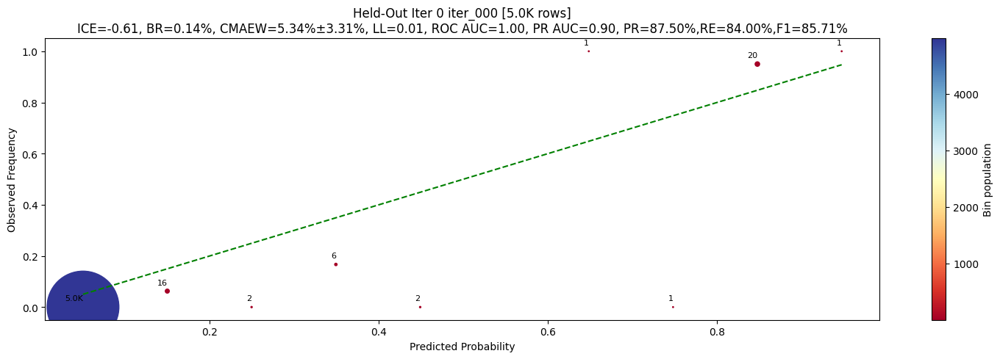

2025-12-22 11:34:56,988 - INFO - initialize-line:2326 - ============================================================
2025-12-22 11:34:56,992 - INFO - initialize-line:2327 - ITERATION 0 COMPLETE
2025-12-22 11:34:56,995 - INFO - initialize-line:2328 -   Train: 1050 samples
2025-12-22 11:34:57,000 - INFO - initialize-line:2329 -   Validation: R=0.840, P=0.875, AUC=0.998, PR-AUC=0.903, ICE=0.0000, LL=0.0067, Brier=0.0014
2025-12-22 11:34:57,004 - INFO - initialize-line:2335 - ============================================================
2025-12-22 11:34:57,009 - INFO - run-line:3152 - ============================================================
2025-12-22 11:34:57,013 - INFO - run-line:3153 - ITERATION 1 (elapsed: 0.01 hours)
2025-12-22 11:34:57,017 - INFO - run-line:3154 - ============================================================


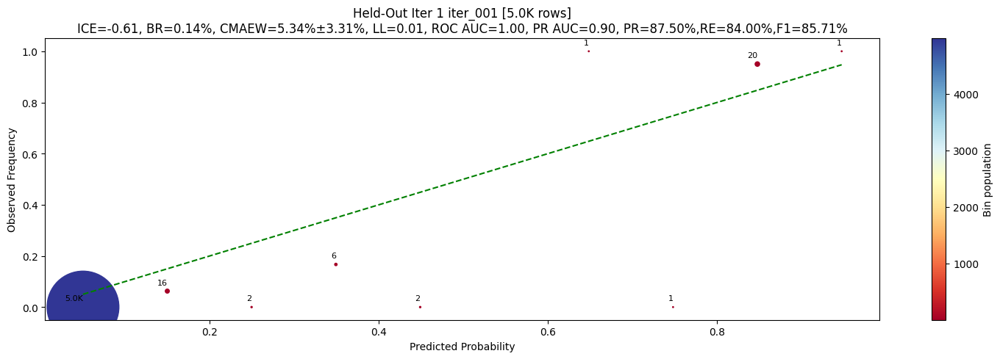

2025-12-22 11:34:58,271 - INFO - _compute_enrichment_factor-line:3046 - Computing enrichment (batched prediction)...
2025-12-22 11:34:58,274 - INFO - _get_unlabeled_features_for_prediction-line:2063 - Creating zero-copy view of unlabeled_samples for prediction... (RAM: 60.14 GB)
2025-12-22 11:35:10,756 - INFO - _get_unlabeled_features_for_prediction-line:2070 - Zero-copy view created: shape=(94028217, 75), RAM: 60.14 -> 87.03 GB (delta: +26.89 GB)
2025-12-22 11:35:10,760 - INFO - _predict_unlabeled_features_batched-line:2119 - Predicting on 94,028,217 samples (single pass)...
2025-12-22 11:35:25,883 - INFO - run-line:3165 - Training bootstrap models...


Bootstrap models:   0%|          | 0/5 [00:00<?, ?it/s]

2025-12-22 11:44:04,669 - INFO - _predict_unlabeled_pool-line:2461 - Predicting on 94,028,217 samples (batched to avoid OOM)...
2025-12-22 11:44:04,673 - INFO - _predict_unlabeled_features_batched-line:2119 - Predicting on 94,028,217 samples (single pass)...


Predicting models:   0%|          | 0/5 [00:00<?, ?it/s]

2025-12-22 11:44:18,433 - INFO - _predict_unlabeled_features_batched-line:2119 - Predicting on 94,028,217 samples (single pass)...
2025-12-22 11:44:42,294 - INFO - _predict_unlabeled_features_batched-line:2119 - Predicting on 94,028,217 samples (single pass)...
2025-12-22 11:44:56,342 - INFO - _predict_unlabeled_features_batched-line:2119 - Predicting on 94,028,217 samples (single pass)...
2025-12-22 11:45:20,015 - INFO - _predict_unlabeled_features_batched-line:2119 - Predicting on 94,028,217 samples (single pass)...
2025-12-22 11:45:43,262 - INFO - _predict_unlabeled_features_batched-line:2119 - Predicting on 94,028,217 samples (single pass)...
2025-12-22 11:48:17,074 - INFO - _pseudo_label_negatives-line:2602 - Pseudo-negatives added: 100, weight=0.90
2025-12-22 11:48:18,560 - INFO - _pseudo_label_positives-line:2744 -   Added pseudo_pos: id=ZTFDR686208200055661_MJD58345.20677, row=74736114, conf=0.9989


2025-12-22 11:48:19,485 - INFO - plot_sample-line:1431 - Plotted sample ZTFDR686208200055661_MJD58345.20677 (row 74736114) - added
2025-12-22 11:48:19,489 - INFO - _pseudo_label_positives-line:2744 -   Added pseudo_pos: id=ZTFDR803206400078410_MJD58468.09312, row=88981355, conf=0.9989


2025-12-22 11:48:19,577 - INFO - plot_sample-line:1431 - Plotted sample ZTFDR803206400078410_MJD58468.09312 (row 88981355) - added
2025-12-22 11:48:19,582 - INFO - _pseudo_label_positives-line:2744 -   Added pseudo_pos: id=ZTFDR686206100128225_MJD58345.19581, row=74436070, conf=0.9987


2025-12-22 11:48:19,672 - INFO - plot_sample-line:1431 - Plotted sample ZTFDR686206100128225_MJD58345.19581 (row 74436070) - added
2025-12-22 11:48:19,676 - INFO - _pseudo_label_positives-line:2744 -   Added pseudo_pos: id=ZTFDR729205400022878_MJD58437.07226, row=78884387, conf=0.9987


2025-12-22 11:48:19,760 - INFO - plot_sample-line:1431 - Plotted sample ZTFDR729205400022878_MJD58437.07226 (row 78884387) - added
2025-12-22 11:48:19,764 - INFO - _pseudo_label_positives-line:2744 -   Added pseudo_pos: id=ZTFDR541206400003924_MJD58342.20912, row=53540896, conf=0.9985


2025-12-22 11:48:19,849 - INFO - plot_sample-line:1431 - Plotted sample ZTFDR541206400003924_MJD58342.20912 (row 53540896) - added
2025-12-22 11:48:19,854 - INFO - _pseudo_label_positives-line:2744 -   Added pseudo_pos: id=ZTFDR541210400098879_MJD58342.20907, row=53819910, conf=0.9986


2025-12-22 11:48:19,940 - INFO - plot_sample-line:1431 - Plotted sample ZTFDR541210400098879_MJD58342.20907 (row 53819910) - added
2025-12-22 11:48:19,944 - INFO - _pseudo_label_positives-line:2744 -   Added pseudo_pos: id=ZTFDR685205100007414_MJD58345.19415, row=72707496, conf=0.9990


2025-12-22 11:48:20,029 - INFO - plot_sample-line:1431 - Plotted sample ZTFDR685205100007414_MJD58345.19415 (row 72707496) - added
2025-12-22 11:48:20,035 - INFO - _pseudo_label_positives-line:2744 -   Added pseudo_pos: id=ZTFDR411207400047364_MJD58456.30351, row=31710590, conf=0.9987


2025-12-22 11:48:20,122 - INFO - plot_sample-line:1431 - Plotted sample ZTFDR411207400047364_MJD58456.30351 (row 31710590) - added
2025-12-22 11:48:20,126 - INFO - _pseudo_label_positives-line:2744 -   Added pseudo_pos: id=ZTFDR485206400064968_MJD58642.31972, row=40122309, conf=0.9985


2025-12-22 11:48:20,219 - INFO - plot_sample-line:1431 - Plotted sample ZTFDR485206400064968_MJD58642.31972 (row 40122309) - added
2025-12-22 11:48:20,223 - INFO - _pseudo_label_positives-line:2744 -   Added pseudo_pos: id=ZTFDR768205200062188_MJD58448.0962, row=83735577, conf=0.9987


2025-12-22 11:48:20,323 - INFO - plot_sample-line:1431 - Plotted sample ZTFDR768205200062188_MJD58448.0962 (row 83735577) - added
2025-12-22 11:48:20,327 - INFO - _pseudo_label_positives-line:2757 - Pseudo-positives added: 10, weight=0.25
2025-12-22 11:48:25,652 - INFO - _review_pseudo_labels-line:2903 - Review: removed 0 pseudo-labels (known_flares: 0, unlabeled: 1110 reviewed)
2025-12-22 11:48:25,657 - INFO - _balance_class_weights-line:2991 - Effective train size: pos=52.5, neg=1090.0
2025-12-22 11:48:25,660 - INFO - _balance_class_weights-line:2998 - Class weight adjusted: {0: 1.0, 1: 2.076190476190488}
2025-12-22 11:48:25,662 - INFO - run-line:3188 - Building training data...
2025-12-22 11:48:25,678 - INFO - run-line:3192 - Retraining main model...
2025-12-22 11:48:34,692 - INFO - run-line:3216 - OOB metrics: recall=0.962, precision=0.962, coverage=91.64%
2025-12-22 11:48:36,680 - INFO - run-line:3273 - ============================================================
2025-12-22 11:48:

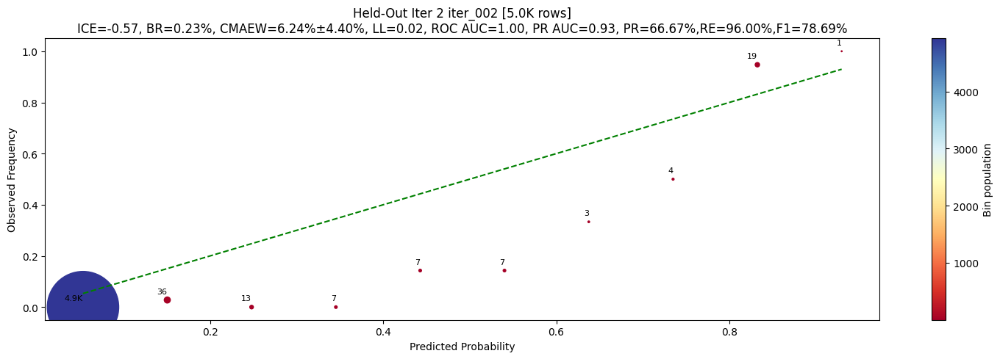

2025-12-22 11:48:38,921 - INFO - _compute_enrichment_factor-line:3046 - Computing enrichment (batched prediction)...
2025-12-22 11:48:38,926 - INFO - _predict_unlabeled_features_batched-line:2119 - Predicting on 94,028,217 samples (single pass)...
2025-12-22 11:48:56,032 - INFO - run-line:3165 - Training bootstrap models...


Bootstrap models:   0%|          | 0/5 [00:00<?, ?it/s]

2025-12-22 11:57:12,575 - INFO - _predict_unlabeled_pool-line:2461 - Predicting on 94,028,217 samples (batched to avoid OOM)...
2025-12-22 11:57:12,581 - INFO - _predict_unlabeled_features_batched-line:2119 - Predicting on 94,028,217 samples (single pass)...


Predicting models:   0%|          | 0/5 [00:00<?, ?it/s]

2025-12-22 11:57:23,608 - INFO - _predict_unlabeled_features_batched-line:2119 - Predicting on 94,028,217 samples (single pass)...
2025-12-22 11:57:48,221 - INFO - _predict_unlabeled_features_batched-line:2119 - Predicting on 94,028,217 samples (single pass)...
2025-12-22 11:58:11,600 - INFO - _predict_unlabeled_features_batched-line:2119 - Predicting on 94,028,217 samples (single pass)...
2025-12-22 11:58:24,174 - INFO - _predict_unlabeled_features_batched-line:2119 - Predicting on 94,028,217 samples (single pass)...
2025-12-22 11:58:47,831 - INFO - _predict_unlabeled_features_batched-line:2119 - Predicting on 94,028,217 samples (single pass)...
2025-12-22 12:01:02,349 - INFO - _pseudo_label_negatives-line:2602 - Pseudo-negatives added: 100, weight=1.00
2025-12-22 12:01:04,795 - INFO - _review_pseudo_labels-line:2903 - Review: removed 0 pseudo-labels (known_flares: 0, unlabeled: 1210 reviewed)
2025-12-22 12:01:04,805 - INFO - _balance_class_weights-line:2991 - Effective train size: po

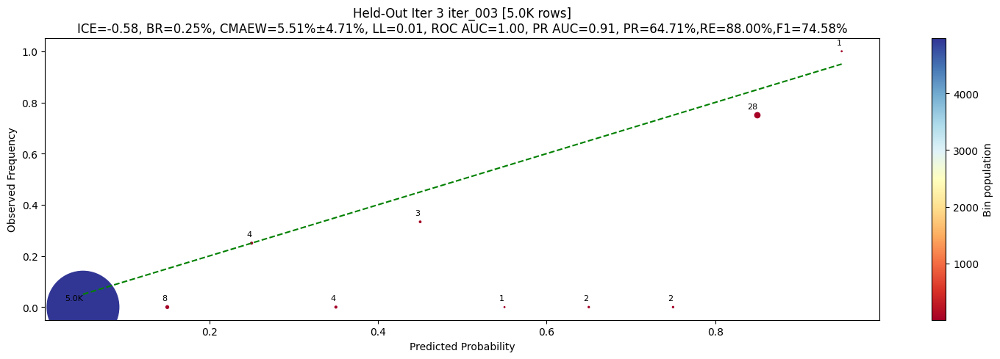

2025-12-22 12:03:09,762 - INFO - _compute_enrichment_factor-line:3046 - Computing enrichment (batched prediction)...
2025-12-22 12:03:09,766 - INFO - _predict_unlabeled_features_batched-line:2119 - Predicting on 94,028,217 samples (single pass)...
2025-12-22 12:03:35,555 - INFO - run-line:3165 - Training bootstrap models...


Bootstrap models:   0%|          | 0/5 [00:00<?, ?it/s]

2025-12-22 12:13:46,259 - INFO - _predict_unlabeled_pool-line:2461 - Predicting on 94,028,217 samples (batched to avoid OOM)...
2025-12-22 12:13:46,263 - INFO - _predict_unlabeled_features_batched-line:2119 - Predicting on 94,028,217 samples (single pass)...


Predicting models:   0%|          | 0/5 [00:00<?, ?it/s]

2025-12-22 12:14:09,035 - INFO - _predict_unlabeled_features_batched-line:2119 - Predicting on 94,028,217 samples (single pass)...
2025-12-22 12:14:32,668 - INFO - _predict_unlabeled_features_batched-line:2119 - Predicting on 94,028,217 samples (single pass)...
2025-12-22 12:14:55,639 - INFO - _predict_unlabeled_features_batched-line:2119 - Predicting on 94,028,217 samples (single pass)...
2025-12-22 12:15:19,328 - INFO - _predict_unlabeled_features_batched-line:2119 - Predicting on 94,028,217 samples (single pass)...
2025-12-22 12:15:43,918 - INFO - _predict_unlabeled_features_batched-line:2119 - Predicting on 94,028,217 samples (single pass)...
2025-12-22 12:18:02,920 - INFO - _pseudo_label_negatives-line:2602 - Pseudo-negatives added: 100, weight=1.00
2025-12-22 12:18:03,250 - INFO - _pseudo_label_positives-line:2744 -   Added pseudo_pos: id=ZTFDR690210100033851_MJD58660.3602, row=76542690, conf=1.0000


2025-12-22 12:18:03,314 - INFO - plot_sample-line:1431 - Plotted sample ZTFDR690210100033851_MJD58660.3602 (row 76542690) - added
2025-12-22 12:18:03,317 - INFO - _pseudo_label_positives-line:2744 -   Added pseudo_pos: id=ZTFDR767205200085687_MJD58448.0961, row=83251304, conf=1.0000


2025-12-22 12:18:03,370 - INFO - plot_sample-line:1431 - Plotted sample ZTFDR767205200085687_MJD58448.0961 (row 83251304) - added
2025-12-22 12:18:03,374 - INFO - _pseudo_label_positives-line:2744 -   Added pseudo_pos: id=ZTFDR803205200073850_MJD58468.09649, row=88964466, conf=1.0000


2025-12-22 12:18:03,430 - INFO - plot_sample-line:1431 - Plotted sample ZTFDR803205200073850_MJD58468.09649 (row 88964466) - added
2025-12-22 12:18:03,434 - INFO - _pseudo_label_positives-line:2744 -   Added pseudo_pos: id=ZTFDR437210200131757_MJD58348.22627, row=36638955, conf=1.0000


2025-12-22 12:18:03,490 - INFO - plot_sample-line:1431 - Plotted sample ZTFDR437210200131757_MJD58348.22627 (row 36638955) - added
2025-12-22 12:18:03,494 - INFO - _pseudo_label_positives-line:2744 -   Added pseudo_pos: id=ZTFDR767207200066397_MJD58451.06905, row=83325614, conf=1.0000


2025-12-22 12:18:03,551 - INFO - plot_sample-line:1431 - Plotted sample ZTFDR767207200066397_MJD58451.06905 (row 83325614) - added
2025-12-22 12:18:03,555 - INFO - _pseudo_label_positives-line:2744 -   Added pseudo_pos: id=ZTFDR638202400092798_MJD58337.2186, row=66283407, conf=1.0000


2025-12-22 12:18:03,612 - INFO - plot_sample-line:1431 - Plotted sample ZTFDR638202400092798_MJD58337.2186 (row 66283407) - added
2025-12-22 12:18:03,616 - INFO - _pseudo_label_positives-line:2744 -   Added pseudo_pos: id=ZTFDR768214400028804_MJD58451.07232, row=83914745, conf=1.0000


2025-12-22 12:18:03,678 - INFO - plot_sample-line:1431 - Plotted sample ZTFDR768214400028804_MJD58451.07232 (row 83914745) - added
2025-12-22 12:18:03,682 - INFO - _pseudo_label_positives-line:2744 -   Added pseudo_pos: id=ZTFDR803205200026342_MJD58468.16726, row=88966211, conf=0.9999


2025-12-22 12:18:03,744 - INFO - plot_sample-line:1431 - Plotted sample ZTFDR803205200026342_MJD58468.16726 (row 88966211) - added
2025-12-22 12:18:03,747 - INFO - _pseudo_label_positives-line:2744 -   Added pseudo_pos: id=ZTFDR565209300016509_MJD58795.34767, row=57940390, conf=1.0000


2025-12-22 12:18:03,814 - INFO - plot_sample-line:1431 - Plotted sample ZTFDR565209300016509_MJD58795.34767 (row 57940390) - added
2025-12-22 12:18:03,817 - INFO - _pseudo_label_positives-line:2744 -   Added pseudo_pos: id=ZTFDR768214400071601_MJD58451.07233, row=83915389, conf=1.0000


2025-12-22 12:18:03,880 - INFO - plot_sample-line:1431 - Plotted sample ZTFDR768214400071601_MJD58451.07233 (row 83915389) - added
2025-12-22 12:18:03,884 - INFO - _pseudo_label_positives-line:2757 - Pseudo-positives added: 10, weight=0.35
2025-12-22 12:18:06,135 - INFO - _review_pseudo_labels-line:2903 - Review: removed 0 pseudo-labels (known_flares: 0, unlabeled: 1320 reviewed)
2025-12-22 12:18:06,143 - INFO - _balance_class_weights-line:2991 - Effective train size: pos=56.0, neg=1290.0
2025-12-22 12:18:06,147 - INFO - _balance_class_weights-line:2998 - Class weight adjusted: {0: 1.0, 1: 2.3035714285714386}
2025-12-22 12:18:06,150 - INFO - run-line:3188 - Building training data...
2025-12-22 12:18:06,171 - INFO - run-line:3192 - Retraining main model...
2025-12-22 12:20:08,065 - INFO - _adjust_thresholds-line:3021 - Thresholds relaxed: pos>0.985, neg<0.060
2025-12-22 12:20:08,137 - INFO - run-line:3216 - OOB metrics: recall=0.953, precision=0.984, coverage=91.97%
2025-12-22 12:20:10,

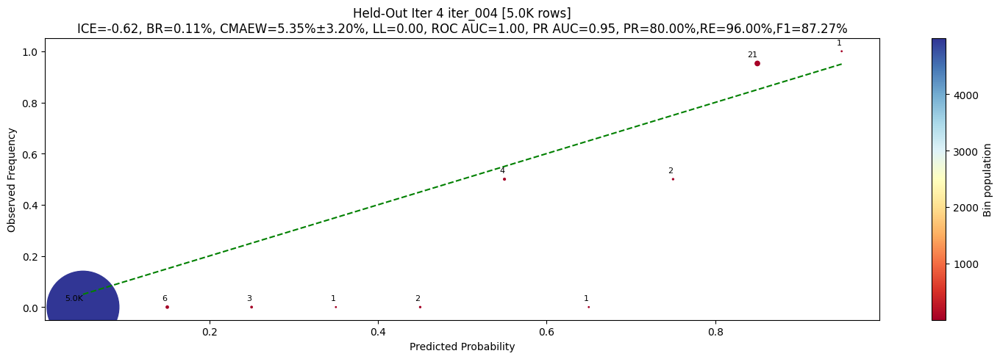

2025-12-22 12:20:12,271 - INFO - _compute_enrichment_factor-line:3046 - Computing enrichment (batched prediction)...
2025-12-22 12:20:12,275 - INFO - _predict_unlabeled_features_batched-line:2119 - Predicting on 94,028,217 samples (single pass)...
2025-12-22 12:20:37,916 - INFO - run-line:3165 - Training bootstrap models...


Bootstrap models:   0%|          | 0/5 [00:00<?, ?it/s]

2025-12-22 12:29:17,861 - INFO - _predict_unlabeled_pool-line:2461 - Predicting on 94,028,217 samples (batched to avoid OOM)...
2025-12-22 12:29:17,865 - INFO - _predict_unlabeled_features_batched-line:2119 - Predicting on 94,028,217 samples (single pass)...


Predicting models:   0%|          | 0/5 [00:00<?, ?it/s]

2025-12-22 12:29:41,729 - INFO - _predict_unlabeled_features_batched-line:2119 - Predicting on 94,028,217 samples (single pass)...
2025-12-22 12:30:06,071 - INFO - _predict_unlabeled_features_batched-line:2119 - Predicting on 94,028,217 samples (single pass)...
2025-12-22 12:30:29,539 - INFO - _predict_unlabeled_features_batched-line:2119 - Predicting on 94,028,217 samples (single pass)...
2025-12-22 12:30:45,362 - INFO - _predict_unlabeled_features_batched-line:2119 - Predicting on 94,028,217 samples (single pass)...
2025-12-22 12:31:09,607 - INFO - _predict_unlabeled_features_batched-line:2119 - Predicting on 94,028,217 samples (single pass)...
2025-12-22 12:33:28,295 - INFO - _pseudo_label_negatives-line:2602 - Pseudo-negatives added: 100, weight=1.00
2025-12-22 12:33:28,644 - INFO - _pseudo_label_positives-line:2744 -   Added pseudo_pos: id=ZTFDR486215300051610_MJD58643.36275, row=41348058, conf=1.0000


2025-12-22 12:33:28,694 - INFO - plot_sample-line:1431 - Plotted sample ZTFDR486215300051610_MJD58643.36275 (row 41348058) - added
2025-12-22 12:33:28,698 - INFO - _pseudo_label_positives-line:2744 -   Added pseudo_pos: id=ZTFDR777212300027255_MJD58836.1558, row=86636724, conf=1.0000


2025-12-22 12:33:28,737 - INFO - plot_sample-line:1431 - Plotted sample ZTFDR777212300027255_MJD58836.1558 (row 86636724) - added
2025-12-22 12:33:28,740 - INFO - _pseudo_label_positives-line:2744 -   Added pseudo_pos: id=ZTFDR807209100015536_MJD58475.17117, row=93195182, conf=1.0000


2025-12-22 12:33:28,798 - INFO - plot_sample-line:1431 - Plotted sample ZTFDR807209100015536_MJD58475.17117 (row 93195182) - added
2025-12-22 12:33:28,800 - INFO - _pseudo_label_positives-line:2744 -   Added pseudo_pos: id=ZTFDR412212400027889_MJD58457.35357, row=32010402, conf=1.0000


2025-12-22 12:33:28,848 - INFO - plot_sample-line:1431 - Plotted sample ZTFDR412212400027889_MJD58457.35357 (row 32010402) - added
2025-12-22 12:33:28,851 - INFO - _pseudo_label_positives-line:2744 -   Added pseudo_pos: id=ZTFDR411203400031073_MJD58457.3042, row=31642169, conf=0.9999


2025-12-22 12:33:28,906 - INFO - plot_sample-line:1431 - Plotted sample ZTFDR411203400031073_MJD58457.3042 (row 31642169) - added
2025-12-22 12:33:28,909 - INFO - _pseudo_label_positives-line:2744 -   Added pseudo_pos: id=ZTFDR766208400024574_MJD58294.39406, row=83049922, conf=0.9999


2025-12-22 12:33:28,965 - INFO - plot_sample-line:1431 - Plotted sample ZTFDR766208400024574_MJD58294.39406 (row 83049922) - added
2025-12-22 12:33:28,968 - INFO - _pseudo_label_positives-line:2744 -   Added pseudo_pos: id=ZTFDR777211400038934_MJD58836.16364, row=86612476, conf=0.9999


2025-12-22 12:33:29,023 - INFO - plot_sample-line:1431 - Plotted sample ZTFDR777211400038934_MJD58836.16364 (row 86612476) - added
2025-12-22 12:33:29,027 - INFO - _pseudo_label_positives-line:2744 -   Added pseudo_pos: id=ZTFDR588208100043952_MJD58645.34337, row=59553592, conf=0.9999


2025-12-22 12:33:29,101 - INFO - plot_sample-line:1431 - Plotted sample ZTFDR588208100043952_MJD58645.34337 (row 59553592) - added
2025-12-22 12:33:29,105 - INFO - _pseudo_label_positives-line:2744 -   Added pseudo_pos: id=ZTFDR726211100036168_MJD58324.31826, row=77342041, conf=0.9999


2025-12-22 12:33:29,179 - INFO - plot_sample-line:1431 - Plotted sample ZTFDR726211100036168_MJD58324.31826 (row 77342041) - added
2025-12-22 12:33:29,183 - INFO - _pseudo_label_positives-line:2744 -   Added pseudo_pos: id=ZTFDR382208400119305_MJD58639.33981, row=25597099, conf=0.9999


2025-12-22 12:33:29,255 - INFO - plot_sample-line:1431 - Plotted sample ZTFDR382208400119305_MJD58639.33981 (row 25597099) - added
2025-12-22 12:33:29,261 - INFO - _pseudo_label_positives-line:2744 -   Added pseudo_pos: id=ZTFDR562216200020648_MJD58852.19428, row=56424157, conf=0.9999


2025-12-22 12:33:29,336 - INFO - plot_sample-line:1431 - Plotted sample ZTFDR562216200020648_MJD58852.19428 (row 56424157) - added
2025-12-22 12:33:29,339 - INFO - _pseudo_label_positives-line:2757 - Pseudo-positives added: 11, weight=0.40
2025-12-22 12:33:31,769 - INFO - _review_pseudo_labels-line:2903 - Review: removed 0 pseudo-labels (known_flares: 0, unlabeled: 1431 reviewed)
2025-12-22 12:33:31,779 - INFO - _balance_class_weights-line:2991 - Effective train size: pos=60.4, neg=1390.0
2025-12-22 12:33:31,782 - INFO - _balance_class_weights-line:2998 - Class weight adjusted: {0: 1.0, 1: 2.3013245033112684}
2025-12-22 12:33:31,786 - INFO - run-line:3188 - Building training data...
2025-12-22 12:33:31,808 - INFO - run-line:3192 - Retraining main model...
2025-12-22 12:35:21,550 - INFO - _adjust_thresholds-line:3021 - Thresholds relaxed: pos>0.980, neg<0.070
2025-12-22 12:35:21,632 - INFO - run-line:3216 - OOB metrics: recall=0.961, precision=0.986, coverage=90.88%
2025-12-22 12:35:23,

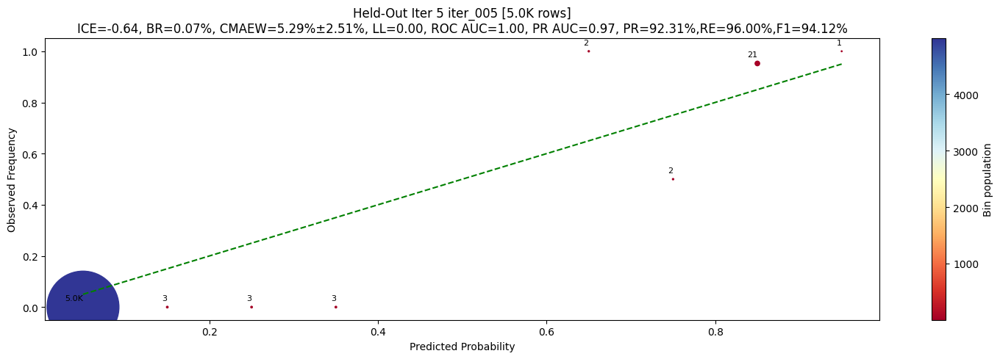

2025-12-22 12:35:25,717 - INFO - _compute_enrichment_factor-line:3046 - Computing enrichment (batched prediction)...
2025-12-22 12:35:25,721 - INFO - _predict_unlabeled_features_batched-line:2119 - Predicting on 94,028,217 samples (single pass)...
2025-12-22 12:35:50,302 - INFO - _finalize-line:3382 - ============================================================
2025-12-22 12:35:50,306 - INFO - _finalize-line:3383 - FINALIZATION
2025-12-22 12:35:50,308 - INFO - _finalize-line:3384 - Stop reason: SUCCESS
2025-12-22 12:35:50,311 - INFO - _finalize-line:3385 - ============================================================
2025-12-22 12:35:50,313 - INFO - _load_best_model-line:3305 - Loading best model from iteration 0
2025-12-22 12:35:50,366 - INFO - _finalize-line:3391 - Computing honest held-out metrics (never used for training decisions)...


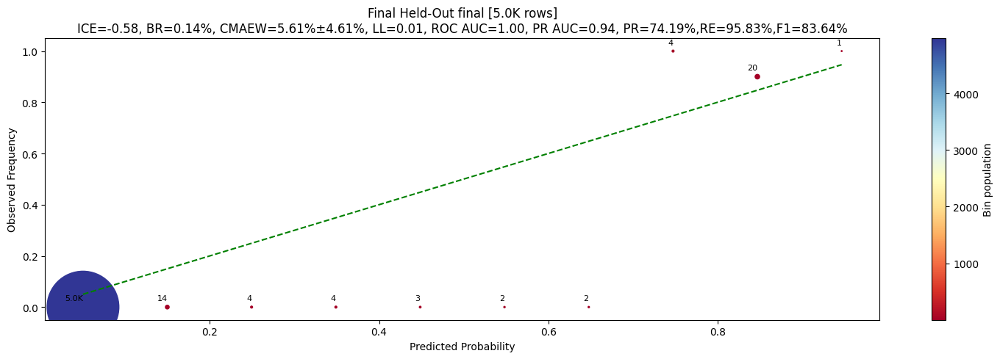

KeyError: 'ice'

time: 1h 1min 19s (started: 2025-12-22 11:34:34 +03:00)


In [15]:
# setup_logging(level=logging.INFO)

# Run pipeline
results = run_active_learning_pipeline(
    unlabeled_samples=big_features,
    known_flares=oos_features,
    output_dir=join(r"R:\Data\Astronomy", "active_learning_output"),
    unlabeled_dataset=dataset["target"],
    known_flares_dataset=dataset["test"],
)

In [26]:
big_features.head().to_pandas().dtypes

id                                         object
class                                     float64
npoints                                    uint32
mag_mean                                  float32
mag_std                                   float32
                                           ...   
mjd_span                                  float32
norm_frac_below_3sigma                    float64
norm_max_consecutive_frac_below_2sigma    float64
norm_frac_local_minima                    float64
norm_frac_zero_crossings                  float64
Length: 78, dtype: object

time: 31 ms (started: 2025-12-23 06:34:24 +03:00)


2025-12-22 13:42:11,717 - INFO - __init__-line:1641 - Output directory: R:\Data\Astronomy\active_learning_output_20251222_134211
2025-12-22 13:42:11,720 - INFO - _validate_inputs-line:1719 - unlabeled_samples: 94,028,217 samples
2025-12-22 13:42:11,723 - INFO - _validate_inputs-line:1720 - known_flares: 99 known flares
2025-12-22 13:42:11,726 - INFO - __init__-line:1651 - Using 75 feature columns
2025-12-22 13:42:11,728 - INFO - __init__-line:1688 - Tracking row index 55554273
2025-12-22 13:42:11,730 - INFO - initialize-line:2139 - ============================================================
2025-12-22 13:42:11,733 - INFO - initialize-line:2140 - PHASE 0: INITIALIZATION
2025-12-22 13:42:11,736 - INFO - initialize-line:2141 - ============================================================
2025-12-22 13:42:11,747 - INFO - stratified_flare_split-line:425 - Stratified split: train=50, val=25, held_out=24
2025-12-22 13:42:11,751 - INFO - initialize-line:2161 - Flares split (stratified): train=

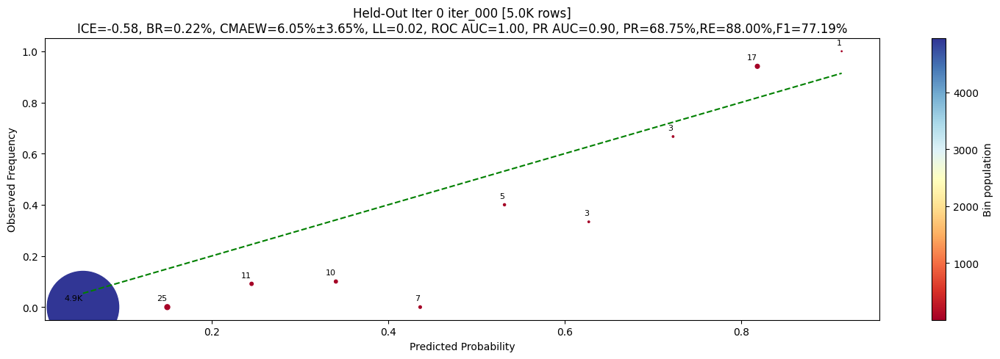

2025-12-22 13:42:41,647 - INFO - _get_tracked_rowid_probability-line:2114 - Tracked row 55554273: P(flare)=0.026805
2025-12-22 13:42:41,650 - INFO - initialize-line:2282 - ============================================================
2025-12-22 13:42:41,652 - INFO - initialize-line:2283 - ITERATION 0 COMPLETE
2025-12-22 13:42:41,655 - INFO - initialize-line:2284 -   Train: 1050 samples
2025-12-22 13:42:41,659 - INFO - initialize-line:2285 -   Validation: R=0.880, P=0.688, AUC=0.998, PR-AUC=0.899, ICE=0.0000, LL=0.0176, Brier=0.0022
2025-12-22 13:42:41,663 - INFO - initialize-line:2291 - ============================================================
2025-12-22 13:42:41,667 - INFO - run-line:3173 - ============================================================
2025-12-22 13:42:41,671 - INFO - run-line:3174 - ITERATION 1 (elapsed: 0.01 hours)
2025-12-22 13:42:41,675 - INFO - run-line:3175 - ============================================================


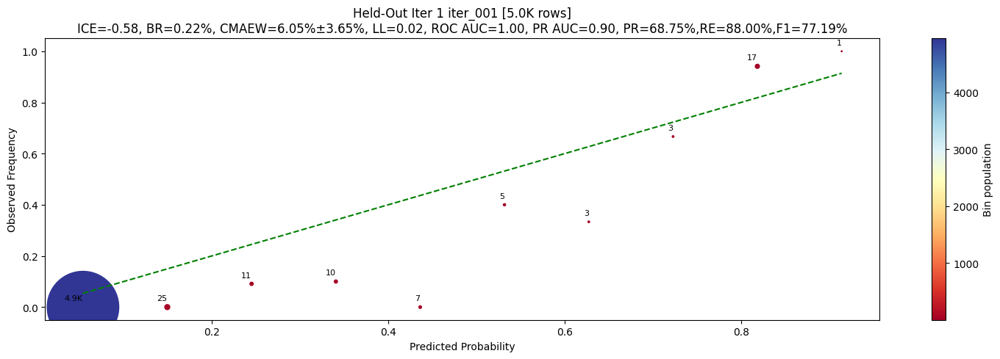

2025-12-22 13:42:42,743 - INFO - _compute_enrichment_factor-line:3024 - Computing enrichment (batched prediction)...
2025-12-22 13:42:42,747 - INFO - _get_unlabeled_features_for_prediction-line:2019 - Creating zero-copy view of unlabeled_samples for prediction... (RAM: 31.52 GB)
2025-12-22 13:43:07,703 - INFO - _get_unlabeled_features_for_prediction-line:2026 - Zero-copy view created: shape=(94028217, 75), RAM: 31.52 -> 83.34 GB (delta: +51.82 GB)
2025-12-22 13:43:20,676 - INFO - run-line:3186 - Training bootstrap models...


Bootstrap models:   0%|          | 0/5 [00:00<?, ?it/s]

Predicting models:   0%|          | 0/5 [00:00<?, ?it/s]

2025-12-22 13:55:26,298 - INFO - _pseudo_label_negatives-line:2567 - Pseudo-negatives added: 100, weight=0.90
_init_credential_provider_builder(): credential_provider_init = None
2025-12-22 13:55:29,146 - INFO - _save_top_candidates-line:3085 - Top-1000 candidates saved to R:\Data\Astronomy\active_learning_output_20251222_134211\top_candidates\top_1000_iter_001.parquet
2025-12-22 13:55:34,279 - INFO - _review_pseudo_labels-line:2868 - Review: removed 0 pseudo-labels (known_flares: 0, unlabeled: 1100 reviewed)
2025-12-22 13:55:34,285 - INFO - _balance_class_weights-line:2969 - Effective train size: pos=50.0, neg=1090.0
2025-12-22 13:55:34,288 - INFO - _balance_class_weights-line:2976 - Class weight adjusted: {0: 1.0, 1: 2.180000000000012}
2025-12-22 13:55:34,292 - INFO - run-line:3212 - Building training data...
2025-12-22 13:55:34,324 - INFO - run-line:3216 - Retraining main model...
2025-12-22 13:55:56,106 - INFO - _compute_enrichment_factor-line:3024 - Computing enrichment (batched p

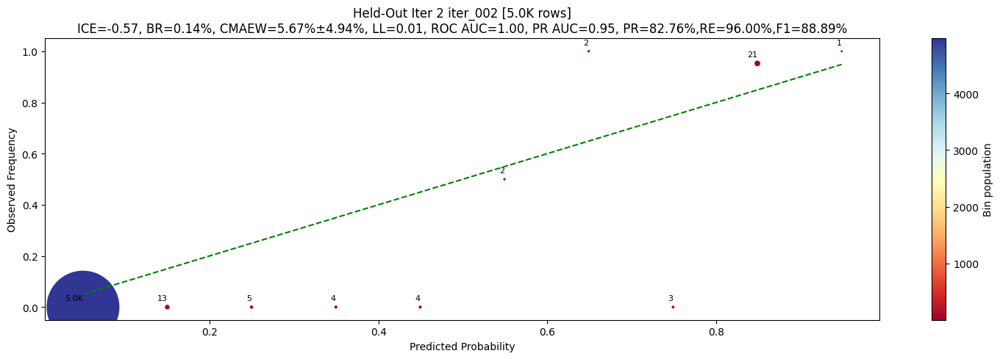

2025-12-22 13:56:26,913 - INFO - _validate_and_check_stopping-line:2358 - New best model saved (validation recall=0.960, ICE not available)
2025-12-22 13:56:26,916 - INFO - _compute_enrichment_factor-line:3024 - Computing enrichment (batched prediction)...
2025-12-22 13:56:48,631 - INFO - run-line:3186 - Training bootstrap models...


Bootstrap models:   0%|          | 0/5 [00:00<?, ?it/s]

Predicting models:   0%|          | 0/5 [00:00<?, ?it/s]

2025-12-22 14:05:50,663 - INFO - _pseudo_label_negatives-line:2567 - Pseudo-negatives added: 100, weight=1.00
2025-12-22 14:05:52,527 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR777212300027255_MJD58836.1558, row=86636724, conf=0.9977


2025-12-22 14:06:00,428 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR686206100128225_MJD58345.19581, row=74436070, conf=0.9974


2025-12-22 14:06:00,880 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR690210100033851_MJD58660.3602, row=76542690, conf=0.9973


2025-12-22 14:06:01,251 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR485216300006424_MJD58642.32006, row=40301631, conf=0.9973


2025-12-22 14:06:01,571 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR588213400058251_MJD58645.33807, row=59567108, conf=0.9971


2025-12-22 14:06:02,023 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR487211400048382_MJD58644.36131, row=41701472, conf=0.9971


2025-12-22 14:06:02,412 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR767205200085687_MJD58448.0961, row=83251304, conf=0.9964


2025-12-22 14:06:02,700 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR309206300050770_MJD58464.36662, row=12476119, conf=0.9969


2025-12-22 14:06:03,109 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR803209200088578_MJD58468.09334, row=89017048, conf=0.9967


2025-12-22 14:06:03,473 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR487207400017156_MJD58644.36182, row=41509964, conf=0.9967


2025-12-22 14:06:03,801 - INFO - _pseudo_label_positives-line:2722 - Pseudo-positives added: 10, weight=0.30
_init_credential_provider_builder(): credential_provider_init = None
2025-12-22 14:06:06,347 - INFO - _save_top_candidates-line:3085 - Top-1000 candidates saved to R:\Data\Astronomy\active_learning_output_20251222_134211\top_candidates\top_1000_iter_002.parquet
2025-12-22 14:06:09,037 - INFO - _review_pseudo_labels-line:2868 - Review: removed 0 pseudo-labels (known_flares: 0, unlabeled: 1210 reviewed)
2025-12-22 14:06:09,046 - INFO - _balance_class_weights-line:2969 - Effective train size: pos=53.0, neg=1190.0
2025-12-22 14:06:09,051 - INFO - _balance_class_weights-line:2976 - Class weight adjusted: {0: 1.0, 1: 2.2452830188679376}
2025-12-22 14:06:09,055 - INFO - run-line:3212 - Building training data...
2025-12-22 14:06:09,091 - INFO - run-line:3216 - Retraining main model...
2025-12-22 14:07:48,336 - INFO - run-line:3244 - OOB metrics: recall=0.912, precision=0.981, coverage=9

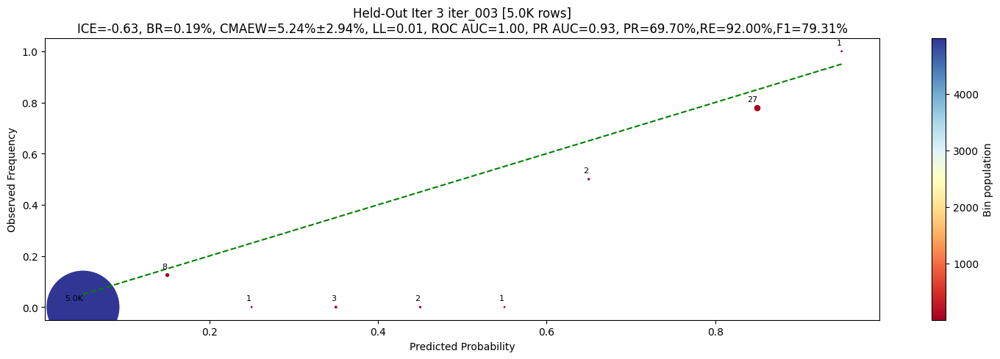

2025-12-22 14:07:52,181 - INFO - _compute_enrichment_factor-line:3024 - Computing enrichment (batched prediction)...
2025-12-22 14:08:15,012 - INFO - run-line:3186 - Training bootstrap models...


Bootstrap models:   0%|          | 0/5 [00:00<?, ?it/s]

Predicting models:   0%|          | 0/5 [00:00<?, ?it/s]

2025-12-22 14:18:54,554 - INFO - _pseudo_label_negatives-line:2567 - Pseudo-negatives added: 100, weight=1.00
2025-12-22 14:18:54,898 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR591201400123433_MJD58343.19632, row=60897090, conf=0.9999


2025-12-22 14:18:55,283 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR485209200074779_MJD58642.32091, row=40175077, conf=0.9999


2025-12-22 14:18:55,688 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR592205400073734_MJD58343.20432, row=61870944, conf=0.9998


2025-12-22 14:18:56,021 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR689209400047208_MJD58450.11516, row=76319458, conf=0.9998


2025-12-22 14:18:56,322 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR613213200002748_MJD58791.37926, row=64105007, conf=0.9998


2025-12-22 14:18:56,763 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR611215200019569_MJD58846.16629, row=63213765, conf=0.9998


2025-12-22 14:18:57,165 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR769213300085419_MJD59026.40768, row=84724493, conf=0.9998


2025-12-22 14:18:57,547 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR336202400036948_MJD58667.36244, row=24273407, conf=0.9998


2025-12-22 14:18:57,898 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR767212100038888_MJD58448.09582, row=83512259, conf=0.9997


2025-12-22 14:18:58,192 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR565209300016509_MJD58795.34767, row=57940390, conf=0.9998


2025-12-22 14:18:58,540 - INFO - _pseudo_label_positives-line:2722 - Pseudo-positives added: 10, weight=0.35
_init_credential_provider_builder(): credential_provider_init = None
2025-12-22 14:19:00,847 - INFO - _save_top_candidates-line:3085 - Top-1000 candidates saved to R:\Data\Astronomy\active_learning_output_20251222_134211\top_candidates\top_1000_iter_003.parquet
2025-12-22 14:19:03,228 - INFO - _review_pseudo_labels-line:2868 - Review: removed 0 pseudo-labels (known_flares: 0, unlabeled: 1320 reviewed)
2025-12-22 14:19:03,235 - INFO - _balance_class_weights-line:2969 - Effective train size: pos=56.5, neg=1290.0
2025-12-22 14:19:03,238 - INFO - _balance_class_weights-line:2976 - Class weight adjusted: {0: 1.0, 1: 2.283185840707976}
2025-12-22 14:19:03,241 - INFO - run-line:3212 - Building training data...
2025-12-22 14:19:03,262 - INFO - run-line:3216 - Retraining main model...
2025-12-22 14:20:41,083 - INFO - _adjust_thresholds-line:2999 - Thresholds relaxed: pos>0.985, neg<0.060

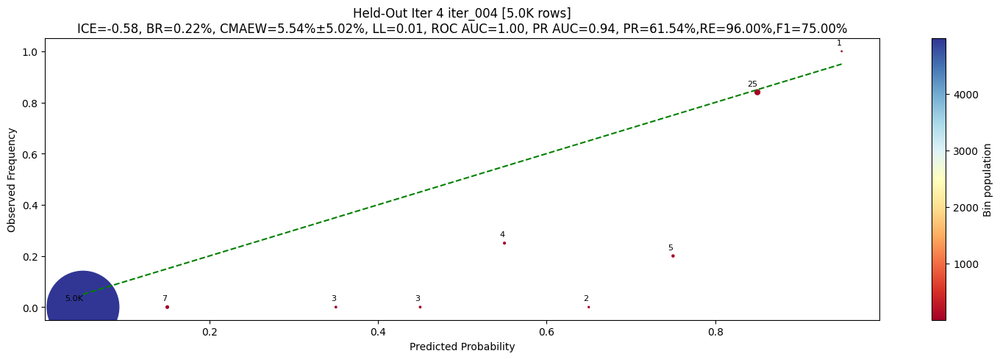

2025-12-22 14:20:45,247 - INFO - _compute_enrichment_factor-line:3024 - Computing enrichment (batched prediction)...
2025-12-22 14:21:08,748 - INFO - run-line:3186 - Training bootstrap models...


Bootstrap models:   0%|          | 0/5 [00:00<?, ?it/s]

Predicting models:   0%|          | 0/5 [00:00<?, ?it/s]

2025-12-22 14:33:07,505 - INFO - _pseudo_label_negatives-line:2567 - Pseudo-negatives added: 100, weight=1.00
2025-12-22 14:33:07,813 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR729205400022878_MJD58437.07226, row=78884387, conf=1.0000


2025-12-22 14:33:08,074 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR772205100015789_MJD58649.39654, row=85579316, conf=1.0000


2025-12-22 14:33:08,460 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR411207400047364_MJD58456.30351, row=31710590, conf=1.0000


2025-12-22 14:33:08,741 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR832202400057547_MJD58775.21301, row=93826594, conf=1.0000


2025-12-22 14:33:08,984 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR807209100015536_MJD58475.17117, row=93195182, conf=1.0000


2025-12-22 14:33:09,201 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR853213400035322_MJD59034.39789, row=94005397, conf=0.9999


2025-12-22 14:33:09,578 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR562216200020648_MJD58852.19428, row=56424157, conf=1.0000


2025-12-22 14:33:09,876 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR769206400068558_MJD58466.09151, row=84315213, conf=1.0000


2025-12-22 14:33:10,229 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR803206400078410_MJD58468.09312, row=88981355, conf=0.9999


2025-12-22 14:33:10,596 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR638207400094988_MJD58338.21312, row=66555298, conf=0.9999


2025-12-22 14:33:10,890 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR771207400041547_MJD58461.14842, row=85329752, conf=0.9999


2025-12-22 14:33:11,198 - INFO - _pseudo_label_positives-line:2722 - Pseudo-positives added: 11, weight=0.40
_init_credential_provider_builder(): credential_provider_init = None
2025-12-22 14:33:13,948 - INFO - _save_top_candidates-line:3085 - Top-1000 candidates saved to R:\Data\Astronomy\active_learning_output_20251222_134211\top_candidates\top_1000_iter_004.parquet
2025-12-22 14:33:16,685 - INFO - _review_pseudo_labels-line:2868 - Review: removed 0 pseudo-labels (known_flares: 0, unlabeled: 1431 reviewed)
2025-12-22 14:33:16,695 - INFO - _balance_class_weights-line:2969 - Effective train size: pos=60.9, neg=1390.0
2025-12-22 14:33:16,700 - INFO - _balance_class_weights-line:2976 - Class weight adjusted: {0: 1.0, 1: 2.2824302134647074}
2025-12-22 14:33:16,704 - INFO - run-line:3212 - Building training data...
2025-12-22 14:33:16,727 - INFO - run-line:3216 - Retraining main model...
2025-12-22 14:34:50,621 - INFO - _adjust_thresholds-line:2999 - Thresholds relaxed: pos>0.980, neg<0.07

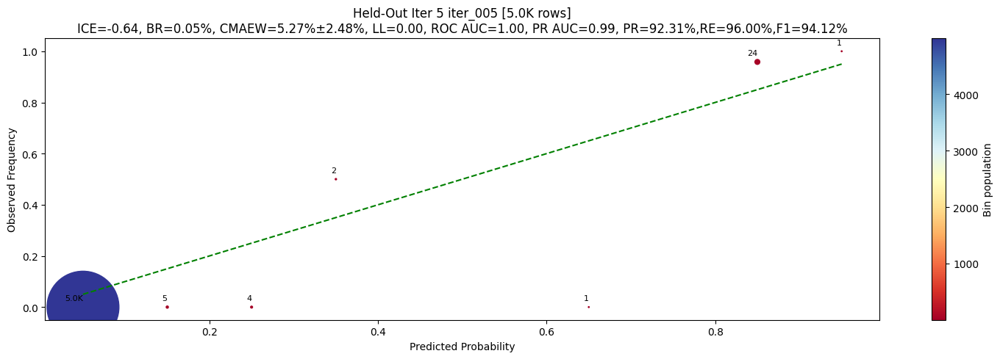

2025-12-22 14:34:54,751 - INFO - _compute_enrichment_factor-line:3024 - Computing enrichment (batched prediction)...
2025-12-22 14:35:18,249 - INFO - run-line:3186 - Training bootstrap models...


Bootstrap models:   0%|          | 0/5 [00:00<?, ?it/s]

Predicting models:   0%|          | 0/5 [00:00<?, ?it/s]

2025-12-22 14:46:55,784 - INFO - _pseudo_label_negatives-line:2567 - Pseudo-negatives added: 100, weight=1.00
2025-12-22 14:46:56,191 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR706202400007742_MJD58793.38607, row=76648546, conf=0.9999


2025-12-22 14:46:56,399 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR766208400024574_MJD58294.39406, row=83049922, conf=1.0000


2025-12-22 14:46:56,613 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR260202100050853_MJD58481.33112, row=363036, conf=1.0000


2025-12-22 14:46:56,831 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR382208400119305_MJD58639.33981, row=25597099, conf=1.0000


2025-12-22 14:46:57,026 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR412212400027889_MJD58457.35357, row=32010402, conf=0.9999


2025-12-22 14:46:57,217 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR768214400071601_MJD58451.07233, row=83915389, conf=0.9999


2025-12-22 14:46:57,406 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR486215300051610_MJD58643.36275, row=41348058, conf=1.0000


2025-12-22 14:46:57,640 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR335207400088082_MJD58674.36788, row=23681707, conf=0.9999


2025-12-22 14:46:57,848 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR641215300040202_MJD59022.401, row=69073186, conf=1.0000


2025-12-22 14:46:58,089 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR806212200035304_MJD59032.39842, row=92679156, conf=1.0000


2025-12-22 14:46:58,324 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR280210200181313_MJD58302.22747, row=3511464, conf=0.9999


2025-12-22 14:46:58,529 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR386216200054647_MJD59010.40628, row=31530231, conf=0.9999


2025-12-22 14:46:58,746 - INFO - _pseudo_label_positives-line:2722 - Pseudo-positives added: 12, weight=0.45
_init_credential_provider_builder(): credential_provider_init = None
2025-12-22 14:47:01,710 - INFO - _save_top_candidates-line:3085 - Top-1000 candidates saved to R:\Data\Astronomy\active_learning_output_20251222_134211\top_candidates\top_1000_iter_005.parquet
2025-12-22 14:47:04,402 - INFO - _review_pseudo_labels-line:2868 - Review: removed 0 pseudo-labels (known_flares: 0, unlabeled: 1543 reviewed)
2025-12-22 14:47:04,407 - INFO - _balance_class_weights-line:2969 - Effective train size: pos=66.3, neg=1490.0
2025-12-22 14:47:04,410 - INFO - _balance_class_weights-line:2976 - Class weight adjusted: {0: 1.0, 1: 2.2473604826546096}
2025-12-22 14:47:04,413 - INFO - run-line:3212 - Building training data...
2025-12-22 14:47:04,431 - INFO - run-line:3216 - Retraining main model...
2025-12-22 14:47:34,853 - INFO - _adjust_thresholds-line:2999 - Thresholds relaxed: pos>0.975, neg<0.08

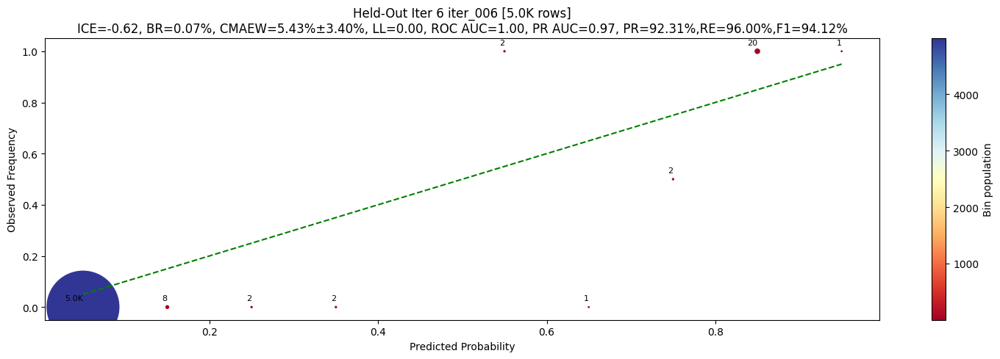

2025-12-22 14:48:06,084 - INFO - _compute_enrichment_factor-line:3024 - Computing enrichment (batched prediction)...
2025-12-22 14:48:24,665 - INFO - run-line:3186 - Training bootstrap models...


Bootstrap models:   0%|          | 0/5 [00:00<?, ?it/s]

Predicting models:   0%|          | 0/5 [00:00<?, ?it/s]

2025-12-22 14:56:13,360 - INFO - _pseudo_label_negatives-line:2567 - Pseudo-negatives added: 100, weight=1.00
2025-12-22 14:56:13,664 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR257210200005675_MJD58472.31832, row=41723, conf=0.9996


2025-12-22 14:56:13,956 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR768214400028804_MJD58451.07232, row=83914745, conf=0.9997


2025-12-22 14:56:14,273 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR330216400048567_MJD58290.27853, row=13532923, conf=0.9996


2025-12-22 14:56:14,629 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR279205200117764_MJD58635.3003, row=1400735, conf=0.9997


2025-12-22 14:56:14,998 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR726211100036168_MJD58324.31826, row=77342041, conf=0.9996


2025-12-22 14:56:15,331 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR742213300019875_MJD58806.40401, row=82413284, conf=0.9996


2025-12-22 14:56:15,647 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR410210100030608_MJD58812.44892, row=31587544, conf=0.9997


2025-12-22 14:56:16,071 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR803205200073850_MJD58468.09649, row=88964466, conf=0.9997


2025-12-22 14:56:16,382 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR587205200026342_MJD59019.42674, row=59521101, conf=0.9996


2025-12-22 14:56:16,676 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR806213300034732_MJD59032.42874, row=92811257, conf=0.9996


2025-12-22 14:56:16,978 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR335210400084533_MJD58674.36832, row=23845773, conf=0.9997


2025-12-22 14:56:17,358 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR771205200039849_MJD58461.14873, row=85295878, conf=0.9996


2025-12-22 14:56:17,629 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR284207300132950_MJD58286.35077, row=10713165, conf=0.9996


2025-12-22 14:56:17,975 - INFO - _pseudo_label_positives-line:2722 - Pseudo-positives added: 13, weight=0.50
_init_credential_provider_builder(): credential_provider_init = None
2025-12-22 14:56:20,403 - INFO - _save_top_candidates-line:3085 - Top-1000 candidates saved to R:\Data\Astronomy\active_learning_output_20251222_134211\top_candidates\top_1000_iter_006.parquet
2025-12-22 14:56:23,151 - INFO - _review_pseudo_labels-line:2868 - Review: removed 0 pseudo-labels (known_flares: 0, unlabeled: 1656 reviewed)
2025-12-22 14:56:23,160 - INFO - _balance_class_weights-line:2969 - Effective train size: pos=72.8, neg=1590.0
2025-12-22 14:56:23,165 - INFO - _balance_class_weights-line:2976 - Class weight adjusted: {0: 1.0, 1: 2.1840659340659423}
2025-12-22 14:56:23,169 - INFO - run-line:3212 - Building training data...
2025-12-22 14:56:23,272 - INFO - run-line:3216 - Retraining main model...
2025-12-22 14:57:57,222 - INFO - _adjust_thresholds-line:2999 - Thresholds relaxed: pos>0.970, neg<0.09

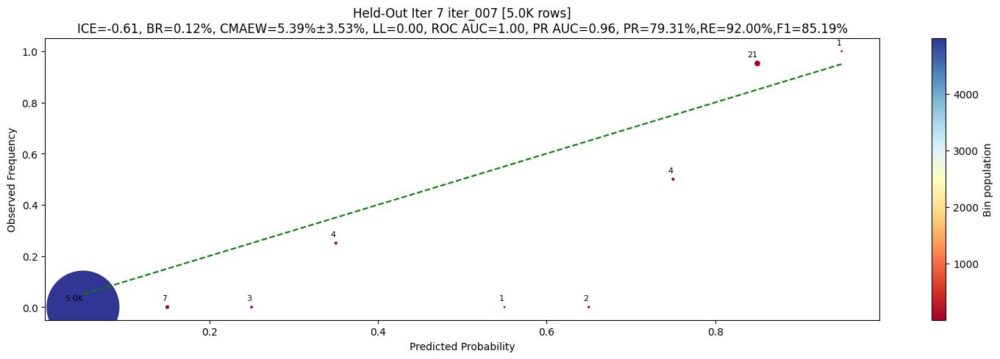

2025-12-22 14:58:01,169 - INFO - _compute_enrichment_factor-line:3024 - Computing enrichment (batched prediction)...
2025-12-22 14:58:23,579 - INFO - run-line:3186 - Training bootstrap models...


Bootstrap models:   0%|          | 0/5 [00:00<?, ?it/s]

Predicting models:   0%|          | 0/5 [00:00<?, ?it/s]

2025-12-22 15:09:15,743 - INFO - _pseudo_label_negatives-line:2567 - Pseudo-negatives added: 100, weight=1.00
2025-12-22 15:09:16,051 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR258214100018083_MJD58487.27621, row=101527, conf=0.9999


2025-12-22 15:09:16,325 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR638202400092798_MJD58337.2186, row=66283407, conf=0.9999


2025-12-22 15:09:16,584 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR538202300127593_MJD58334.19824, row=49121917, conf=0.9998


2025-12-22 15:09:16,940 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR592208400030991_MJD58343.19487, row=61952056, conf=0.9998


2025-12-22 15:09:17,214 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR284210200088562_MJD58286.3507, row=11123059, conf=0.9999


2025-12-22 15:09:17,402 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR733209300032227_MJD58648.41277, row=82149824, conf=0.9998


2025-12-22 15:09:17,579 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR640215300013929_MJD59004.40338, row=68481756, conf=0.9998


2025-12-22 15:09:17,943 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR541206400003924_MJD58342.20912, row=53540896, conf=0.9998


2025-12-22 15:09:18,208 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR541209200068438_MJD58342.21643, row=53727368, conf=0.9998


2025-12-22 15:09:18,507 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR283210400186980_MJD58312.26883, row=8323633, conf=0.9998


2025-12-22 15:09:18,776 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR541205400077818_MJD58342.20922, row=53473598, conf=0.9997


2025-12-22 15:09:19,020 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR768204200065336_MJD58451.0679, row=83711971, conf=0.9998


2025-12-22 15:09:19,303 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR638201300158344_MJD58337.21306, row=66204867, conf=0.9997


2025-12-22 15:09:19,630 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR538210200015275_MJD58334.19621, row=50212410, conf=0.9998


2025-12-22 15:09:19,936 - INFO - _pseudo_label_positives-line:2722 - Pseudo-positives added: 14, weight=0.55
_init_credential_provider_builder(): credential_provider_init = None
2025-12-22 15:09:21,829 - INFO - _save_top_candidates-line:3085 - Top-1000 candidates saved to R:\Data\Astronomy\active_learning_output_20251222_134211\top_candidates\top_1000_iter_007.parquet
2025-12-22 15:09:24,372 - INFO - _review_pseudo_labels-line:2868 - Review: removed 0 pseudo-labels (known_flares: 0, unlabeled: 1770 reviewed)
2025-12-22 15:09:24,378 - INFO - _balance_class_weights-line:2969 - Effective train size: pos=80.5, neg=1690.0
2025-12-22 15:09:24,381 - INFO - _balance_class_weights-line:2976 - Class weight adjusted: {0: 1.0, 1: 2.0993788819875863}
2025-12-22 15:09:24,385 - INFO - run-line:3212 - Building training data...
2025-12-22 15:09:24,405 - INFO - run-line:3216 - Retraining main model...
2025-12-22 15:10:55,770 - INFO - _adjust_thresholds-line:2999 - Thresholds relaxed: pos>0.965, neg<0.10

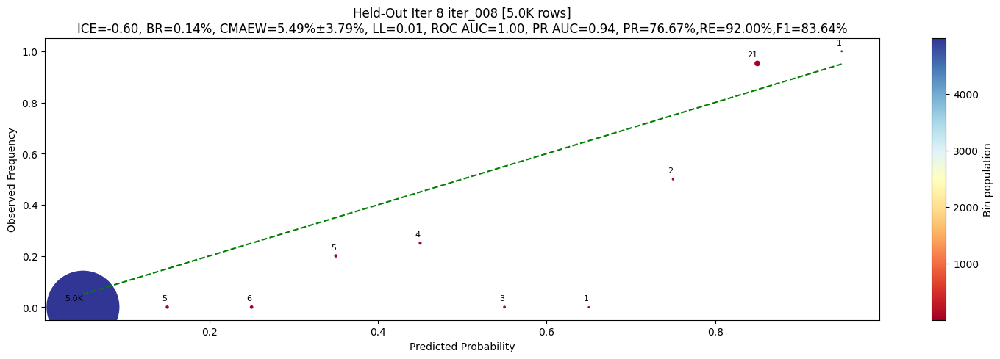

2025-12-22 15:10:59,986 - INFO - _compute_enrichment_factor-line:3024 - Computing enrichment (batched prediction)...
2025-12-22 15:11:22,244 - INFO - run-line:3186 - Training bootstrap models...


Bootstrap models:   0%|          | 0/5 [00:00<?, ?it/s]

Predicting models:   0%|          | 0/5 [00:00<?, ?it/s]

2025-12-22 15:20:28,148 - INFO - _pseudo_label_negatives-line:2567 - Pseudo-negatives added: 100, weight=1.00
2025-12-22 15:20:28,479 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR331210200157488_MJD58304.23701, row=15395041, conf=0.9992


2025-12-22 15:20:28,788 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR260208100017563_MJD58493.28958, row=473371, conf=0.9992


2025-12-22 15:20:29,103 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR541212300185918_MJD58342.20521, row=54062324, conf=0.9992


2025-12-22 15:20:29,356 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR768214400028233_MJD58451.06948, row=83914367, conf=0.9992


2025-12-22 15:20:29,684 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR806213300000569_MJD59032.40954, row=92812974, conf=0.9991


2025-12-22 15:20:29,985 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR541206400101933_MJD58342.20455, row=53535423, conf=0.9990


2025-12-22 15:20:30,351 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR688208200078236_MJD58449.07646, row=75824536, conf=0.9990


2025-12-22 15:20:30,700 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR685205100007414_MJD58345.19415, row=72707496, conf=0.9991


2025-12-22 15:20:30,939 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR660207300043882_MJD58790.37998, row=70343242, conf=0.9989


2025-12-22 15:20:31,211 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR539210200165827_MJD58334.22748, row=51306753, conf=0.9991


2025-12-22 15:20:31,473 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR380212200034960_MJD59046.2361, row=24813928, conf=0.9990


2025-12-22 15:20:31,713 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR411210400046888_MJD58457.34142, row=31764091, conf=0.9988


2025-12-22 15:20:31,999 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR331210200152241_MJD58306.23738, row=15405156, conf=0.9991


2025-12-22 15:20:32,262 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR541210400098879_MJD58342.20907, row=53819910, conf=0.9990


2025-12-22 15:20:32,460 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR591205400132465_MJD58343.19623, row=61165680, conf=0.9990


2025-12-22 15:20:32,681 - INFO - _pseudo_label_positives-line:2722 - Pseudo-positives added: 15, weight=0.60
_init_credential_provider_builder(): credential_provider_init = None
2025-12-22 15:20:34,487 - INFO - _save_top_candidates-line:3085 - Top-1000 candidates saved to R:\Data\Astronomy\active_learning_output_20251222_134211\top_candidates\top_1000_iter_008.parquet
2025-12-22 15:20:37,036 - INFO - _review_pseudo_labels-line:2868 - Review: removed 0 pseudo-labels (known_flares: 0, unlabeled: 1885 reviewed)
2025-12-22 15:20:37,044 - INFO - _balance_class_weights-line:2969 - Effective train size: pos=89.5, neg=1790.0
2025-12-22 15:20:37,049 - INFO - _balance_class_weights-line:2976 - Class weight adjusted: {0: 1.0, 1: 2.0000000000000098}
2025-12-22 15:20:37,054 - INFO - run-line:3212 - Building training data...
2025-12-22 15:20:37,077 - INFO - run-line:3216 - Retraining main model...
2025-12-22 15:22:06,934 - INFO - _adjust_thresholds-line:2999 - Thresholds relaxed: pos>0.960, neg<0.10

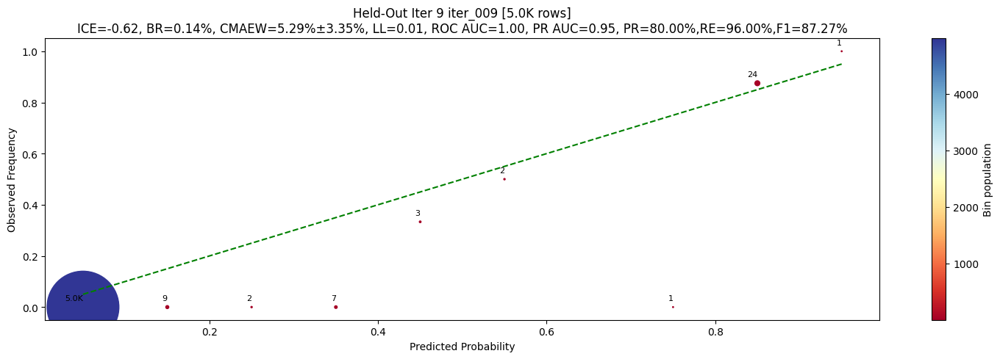

2025-12-22 15:22:11,597 - INFO - _compute_enrichment_factor-line:3024 - Computing enrichment (batched prediction)...
2025-12-22 15:22:33,616 - INFO - run-line:3186 - Training bootstrap models...


Bootstrap models:   0%|          | 0/5 [00:00<?, ?it/s]

Predicting models:   0%|          | 0/5 [00:00<?, ?it/s]

2025-12-22 15:32:57,424 - INFO - _pseudo_label_negatives-line:2567 - Pseudo-negatives added: 100, weight=1.00
2025-12-22 15:32:57,770 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR488202400091403_MJD58340.19342, row=42144925, conf=0.9998


2025-12-22 15:32:58,089 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR386209400023272_MJD59010.40318, row=31392323, conf=0.9998


2025-12-22 15:32:58,408 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR311209200027397_MJD58494.31507, row=12684217, conf=0.9997


2025-12-22 15:32:58,734 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR591206400110461_MJD58343.19521, row=61290457, conf=0.9998


2025-12-22 15:32:59,033 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR538210400058082_MJD58334.19444, row=50244690, conf=0.9998


2025-12-22 15:32:59,326 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR538206400078914_MJD58334.19729, row=49845796, conf=0.9998


2025-12-22 15:32:59,690 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR261208400022343_MJD58486.34514, row=736105, conf=0.9998


2025-12-22 15:32:59,970 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR485210200059525_MJD58642.3196, row=40198079, conf=0.9998


2025-12-22 15:33:00,344 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR767206100019391_MJD58448.0979, row=83276787, conf=0.9998


2025-12-22 15:33:00,619 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR615205200000289_MJD58797.34784, row=65054282, conf=0.9998


2025-12-22 15:33:00,946 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR538206400133713_MJD58334.19544, row=49860465, conf=0.9998


2025-12-22 15:33:01,210 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR803202400045683_MJD58468.0926, row=88935101, conf=0.9998


2025-12-22 15:33:01,516 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR541206100062408_MJD58342.20635, row=53486851, conf=0.9997


2025-12-22 15:33:01,845 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR591201400078246_MJD58343.19629, row=60892719, conf=0.9998


2025-12-22 15:33:02,172 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR803202400045660_MJD58468.0926, row=88933579, conf=0.9998


2025-12-22 15:33:02,511 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR591213400149403_MJD58343.19603, row=61721259, conf=0.9997


2025-12-22 15:33:02,827 - INFO - _pseudo_label_positives-line:2722 - Pseudo-positives added: 16, weight=0.65
_init_credential_provider_builder(): credential_provider_init = None
2025-12-22 15:33:05,085 - INFO - _save_top_candidates-line:3085 - Top-1000 candidates saved to R:\Data\Astronomy\active_learning_output_20251222_134211\top_candidates\top_1000_iter_009.parquet
2025-12-22 15:33:07,738 - INFO - _review_pseudo_labels-line:2868 - Review: removed 0 pseudo-labels (known_flares: 0, unlabeled: 2001 reviewed)
2025-12-22 15:33:07,746 - INFO - _balance_class_weights-line:2969 - Effective train size: pos=99.9, neg=1890.0
2025-12-22 15:33:07,750 - INFO - run-line:3212 - Building training data...
2025-12-22 15:33:07,774 - INFO - run-line:3216 - Retraining main model...
2025-12-22 15:34:39,302 - INFO - _adjust_thresholds-line:2999 - Thresholds relaxed: pos>0.955, neg<0.100
2025-12-22 15:34:39,396 - INFO - run-line:3244 - OOB metrics: recall=0.965, precision=0.993, coverage=91.08%
2025-12-22 1

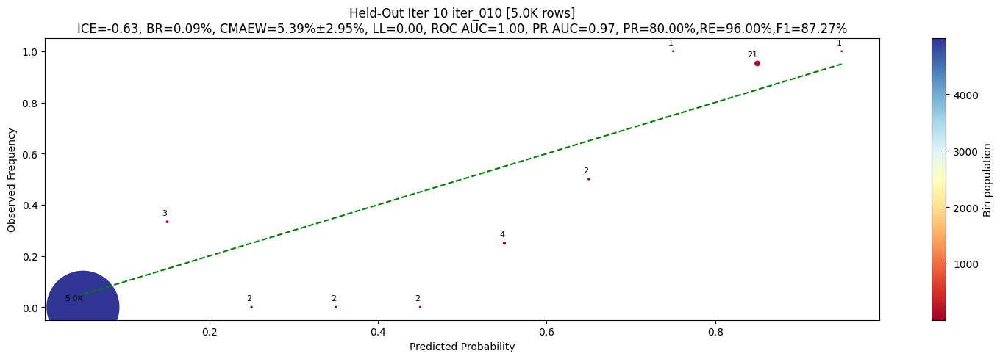

2025-12-22 15:34:43,816 - INFO - _compute_enrichment_factor-line:3024 - Computing enrichment (batched prediction)...
2025-12-22 15:35:06,016 - INFO - run-line:3186 - Training bootstrap models...


Bootstrap models:   0%|          | 0/5 [00:00<?, ?it/s]

Predicting models:   0%|          | 0/5 [00:00<?, ?it/s]

2025-12-22 15:43:05,644 - INFO - _pseudo_label_negatives-line:2567 - Pseudo-negatives added: 100, weight=1.00
2025-12-22 15:43:05,950 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR832202400043027_MJD58775.21301, row=93825628, conf=0.9998


2025-12-22 15:43:06,149 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR283205200168445_MJD58310.28408, row=6954821, conf=0.9996


2025-12-22 15:43:06,410 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR765206400013258_MJD58327.21512, row=82934331, conf=0.9998


2025-12-22 15:43:06,691 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR565211200039869_MJD58795.33718, row=57999125, conf=0.9998


2025-12-22 15:43:06,978 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR768214400040803_MJD58448.09811, row=83914619, conf=0.9998


2025-12-22 15:43:07,242 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR283205400130939_MJD58311.27172, row=7010460, conf=0.9998


2025-12-22 15:43:07,534 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR539212400149392_MJD58334.19505, row=51613140, conf=0.9998


2025-12-22 15:43:07,761 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR333204200063719_MJD58314.25843, row=17853870, conf=0.9998


2025-12-22 15:43:08,087 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR686208200055661_MJD58345.20677, row=74736114, conf=0.9998


2025-12-22 15:43:08,345 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR588202400031254_MJD58645.3385, row=59539611, conf=0.9998


2025-12-22 15:43:08,624 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR589208400069150_MJD58646.33947, row=59644290, conf=0.9997


2025-12-22 15:43:08,901 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR308213400055537_MJD58464.35106, row=12412529, conf=0.9997


2025-12-22 15:43:09,178 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR733206200034504_MJD58648.37762, row=82141120, conf=0.9998


2025-12-22 15:43:09,459 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR436213300090627_MJD59015.40307, row=35770660, conf=0.9998


2025-12-22 15:43:09,767 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR279210200131272_MJD58635.30032, row=1759143, conf=0.9997


2025-12-22 15:43:10,031 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR284206400059477_MJD58286.3557, row=10579677, conf=0.9993


2025-12-22 15:43:10,284 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR637210200060641_MJD58657.28097, row=66058482, conf=0.9997


2025-12-22 15:43:10,571 - INFO - _pseudo_label_positives-line:2722 - Pseudo-positives added: 17, weight=0.70
_init_credential_provider_builder(): credential_provider_init = None
2025-12-22 15:43:12,664 - INFO - _save_top_candidates-line:3085 - Top-1000 candidates saved to R:\Data\Astronomy\active_learning_output_20251222_134211\top_candidates\top_1000_iter_010.parquet
2025-12-22 15:43:15,537 - INFO - _review_pseudo_labels-line:2868 - Review: removed 0 pseudo-labels (known_flares: 0, unlabeled: 2118 reviewed)
2025-12-22 15:43:15,545 - INFO - _balance_class_weights-line:2969 - Effective train size: pos=111.8, neg=1990.0
2025-12-22 15:43:15,549 - INFO - run-line:3212 - Building training data...
2025-12-22 15:43:15,574 - INFO - run-line:3216 - Retraining main model...
2025-12-22 15:44:47,340 - INFO - _adjust_thresholds-line:2999 - Thresholds relaxed: pos>0.950, neg<0.100
2025-12-22 15:44:47,345 - INFO - _compute_enrichment_factor-line:3024 - Computing enrichment (batched prediction)...
202

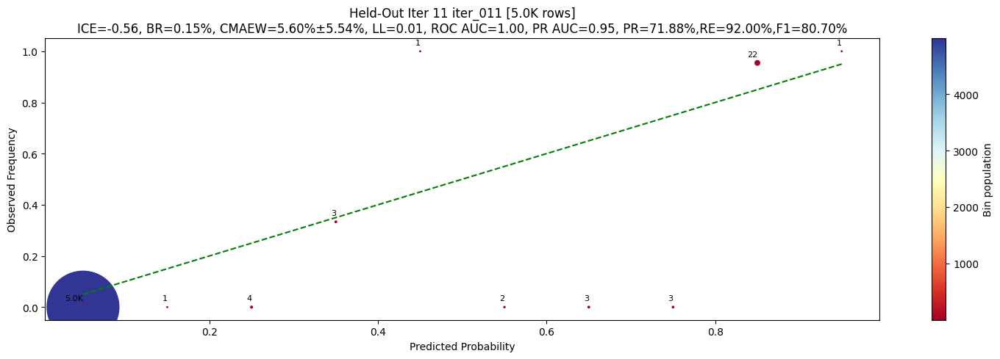

2025-12-22 15:45:19,260 - INFO - _compute_enrichment_factor-line:3024 - Computing enrichment (batched prediction)...
2025-12-22 15:45:42,061 - INFO - run-line:3186 - Training bootstrap models...


Bootstrap models:   0%|          | 0/5 [00:00<?, ?it/s]

Predicting models:   0%|          | 0/5 [00:00<?, ?it/s]

2025-12-22 15:58:21,501 - INFO - _pseudo_label_negatives-line:2567 - Pseudo-negatives added: 100, weight=1.00
2025-12-22 15:58:22,137 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR686212300069746_MJD58346.19235, row=75188431, conf=0.9999


2025-12-22 15:58:22,459 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR768214400042723_MJD58451.07706, row=83913816, conf=0.9999


2025-12-22 15:58:22,758 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR686204200152909_MJD58345.19478, row=74259670, conf=0.9999


2025-12-22 15:58:23,089 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR766210200039235_MJD58296.39101, row=83065890, conf=0.9999


2025-12-22 15:58:23,484 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR636214400043200_MJD59047.36452, row=65820841, conf=0.9999


2025-12-22 15:58:23,765 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR437210200131757_MJD58348.22627, row=36638955, conf=0.9999


2025-12-22 15:58:24,048 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR687204200021319_MJD58658.32456, row=75551581, conf=0.9999


2025-12-22 15:58:24,318 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR591205400102586_MJD58344.19404, row=61162245, conf=0.9999


2025-12-22 15:58:24,651 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR439206400041938_MJD58662.36111, row=37821827, conf=0.9999


2025-12-22 15:58:25,000 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR701203400024638_MJD58792.26306, row=76575056, conf=0.9999


2025-12-22 15:58:25,349 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR684206100003480_MJD58299.23613, row=72038480, conf=0.9999


2025-12-22 15:58:25,635 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR382213400132083_MJD58639.3396, row=25726890, conf=0.9999


2025-12-22 15:58:26,000 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR260205400062161_MJD58493.28813, row=437357, conf=0.9999


2025-12-22 15:58:26,375 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR539204200171808_MJD58334.197, row=50619653, conf=0.9999


2025-12-22 15:58:26,665 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR639206300028309_MJD58338.20786, row=67234796, conf=0.9999


2025-12-22 15:58:27,021 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR540206300175580_MJD58342.20558, row=52565519, conf=0.9999


2025-12-22 15:58:27,352 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR439209400031564_MJD58662.36096, row=37825428, conf=0.9999


2025-12-22 15:58:27,767 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR685205100128648_MJD58345.19511, row=72716659, conf=0.9999


2025-12-22 15:58:28,058 - INFO - _pseudo_label_positives-line:2722 - Pseudo-positives added: 18, weight=0.75
_init_credential_provider_builder(): credential_provider_init = None
2025-12-22 15:58:31,502 - INFO - _save_top_candidates-line:3085 - Top-1000 candidates saved to R:\Data\Astronomy\active_learning_output_20251222_134211\top_candidates\top_1000_iter_011.parquet
2025-12-22 15:58:34,750 - INFO - _review_pseudo_labels-line:2868 - Review: removed 0 pseudo-labels (known_flares: 0, unlabeled: 2236 reviewed)
2025-12-22 15:58:34,760 - INFO - _balance_class_weights-line:2969 - Effective train size: pos=125.3, neg=2090.0
2025-12-22 15:58:34,765 - INFO - run-line:3212 - Building training data...
2025-12-22 15:58:34,794 - INFO - run-line:3216 - Retraining main model...
2025-12-22 15:59:01,139 - INFO - _adjust_thresholds-line:2999 - Thresholds relaxed: pos>0.950, neg<0.100
2025-12-22 15:59:01,223 - INFO - run-line:3244 - OOB metrics: recall=0.971, precision=0.988, coverage=90.51%
2025-12-22 

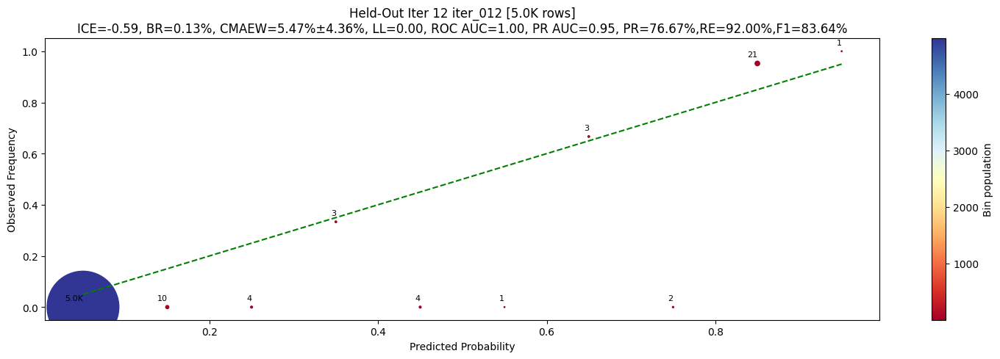

2025-12-22 15:59:06,519 - INFO - _compute_enrichment_factor-line:3024 - Computing enrichment (batched prediction)...
2025-12-22 15:59:32,142 - INFO - run-line:3186 - Training bootstrap models...


Bootstrap models:   0%|          | 0/5 [00:00<?, ?it/s]

Predicting models:   0%|          | 0/5 [00:00<?, ?it/s]

2025-12-22 16:12:47,088 - INFO - _pseudo_label_negatives-line:2567 - Pseudo-negatives added: 100, weight=1.00
2025-12-22 16:12:47,624 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR766206200043184_MJD58295.39215, row=83025300, conf=0.9998


2025-12-22 16:12:47,924 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR772213400041905_MJD58776.33886, row=85613498, conf=0.9998


2025-12-22 16:12:48,254 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR591216400046619_MJD58344.19261, row=61782142, conf=0.9998


2025-12-22 16:12:48,526 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR257208300005695_MJD58468.30895, row=32203, conf=0.9998


2025-12-22 16:12:48,832 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR284212200131884_MJD58286.35129, row=11538718, conf=0.9998


2025-12-22 16:12:49,132 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR613212400023118_MJD58791.37965, row=64071401, conf=0.9998


2025-12-22 16:12:49,519 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR768201400095153_MJD58448.09901, row=83679421, conf=0.9998


2025-12-22 16:12:49,786 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR613204400038656_MJD58836.23776, row=63513058, conf=0.9998


2025-12-22 16:12:50,053 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR768204100079115_MJD58451.0699, row=83708300, conf=0.9998


2025-12-22 16:12:50,350 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR768212100084137_MJD58448.09586, row=83885356, conf=0.9998


2025-12-22 16:12:50,633 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR591212400117995_MJD58343.19402, row=61684930, conf=0.9998


2025-12-22 16:12:50,910 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR381216400017742_MJD59012.40417, row=25003867, conf=0.9998


2025-12-22 16:12:51,274 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR284207300092369_MJD58286.35077, row=10704025, conf=0.9998


2025-12-22 16:12:51,583 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR280206400117265_MJD58303.22784, row=2881280, conf=0.9998


2025-12-22 16:12:51,952 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR279210200133722_MJD58635.30032, row=1759777, conf=0.9998


2025-12-22 16:12:52,259 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR592207400109587_MJD58344.19744, row=61908544, conf=0.9998


2025-12-22 16:12:52,498 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR588201300038850_MJD58645.33888, row=59535966, conf=0.9997


2025-12-22 16:12:52,750 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR437210400093835_MJD58348.21713, row=36686648, conf=0.9998


2025-12-22 16:12:53,075 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR685207400060513_MJD58346.19175, row=73045107, conf=0.9997


2025-12-22 16:12:53,350 - INFO - _pseudo_label_positives-line:2722 - Pseudo-positives added: 19, weight=0.80
_init_credential_provider_builder(): credential_provider_init = None
2025-12-22 16:12:56,784 - INFO - _save_top_candidates-line:3085 - Top-1000 candidates saved to R:\Data\Astronomy\active_learning_output_20251222_134211\top_candidates\top_1000_iter_012.parquet
2025-12-22 16:12:59,703 - INFO - _review_pseudo_labels-line:2868 - Review: removed 0 pseudo-labels (known_flares: 0, unlabeled: 2355 reviewed)
2025-12-22 16:12:59,712 - INFO - _balance_class_weights-line:2969 - Effective train size: pos=140.5, neg=2190.0
2025-12-22 16:12:59,717 - INFO - run-line:3212 - Building training data...
2025-12-22 16:12:59,743 - INFO - run-line:3216 - Retraining main model...
2025-12-22 16:13:18,718 - INFO - _adjust_thresholds-line:2999 - Thresholds relaxed: pos>0.950, neg<0.100
2025-12-22 16:13:18,813 - INFO - run-line:3244 - OOB metrics: recall=0.984, precision=0.995, coverage=89.90%
2025-12-22 

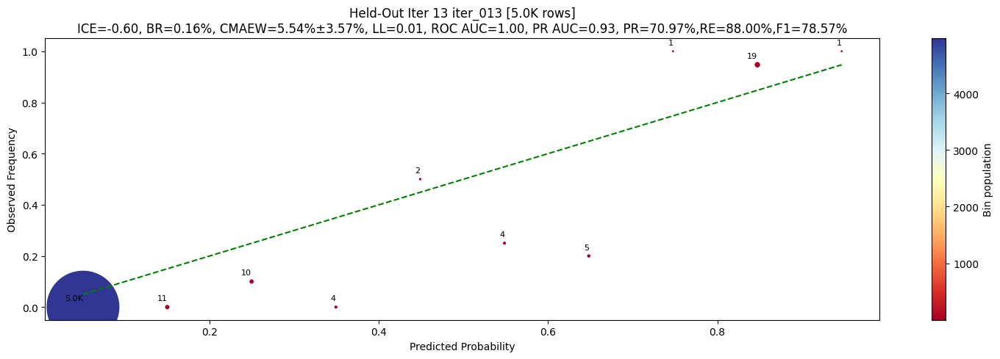

2025-12-22 16:13:24,437 - INFO - _compute_enrichment_factor-line:3024 - Computing enrichment (batched prediction)...
2025-12-22 16:13:47,257 - INFO - run-line:3186 - Training bootstrap models...


Bootstrap models:   0%|          | 0/5 [00:00<?, ?it/s]

Predicting models:   0%|          | 0/5 [00:00<?, ?it/s]

2025-12-22 16:25:57,638 - INFO - _pseudo_label_negatives-line:2567 - Pseudo-negatives added: 100, weight=1.00
2025-12-22 16:25:57,968 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR636208400039468_MJD59031.3799, row=65801302, conf=0.9974


2025-12-22 16:25:58,115 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR384212200158760_MJD58317.28672, row=28425630, conf=0.9972


2025-12-22 16:25:58,306 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR758211400022438_MJD58231.22051, row=82889233, conf=0.9971


2025-12-22 16:25:58,579 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR539212400151759_MJD58334.19504, row=51615006, conf=0.9972


2025-12-22 16:25:58,827 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR489208400100243_MJD58340.20228, row=43859398, conf=0.9975


2025-12-22 16:25:59,061 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR592205200067084_MJD58344.1937, row=61866274, conf=0.9976


2025-12-22 16:25:59,379 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR385206100124154_MJD58293.3631, row=29409742, conf=0.9974


2025-12-22 16:25:59,816 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR769208200073318_MJD58466.09076, row=84416979, conf=0.9975


2025-12-22 16:26:00,056 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR540209200114018_MJD58342.21111, row=52785209, conf=0.9974


2025-12-22 16:26:00,344 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR686202400186322_MJD58346.1928, row=73939387, conf=0.9974


2025-12-22 16:26:00,612 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR768208200088363_MJD58451.06895, row=83828620, conf=0.9973


2025-12-22 16:26:00,921 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR768214400041753_MJD58451.07139, row=83913458, conf=0.9974


2025-12-22 16:26:01,214 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR831208400072230_MJD58776.2038, row=93800008, conf=0.9976


2025-12-22 16:26:01,489 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR541207400076823_MJD58342.20536, row=53611682, conf=0.9974


2025-12-22 16:26:01,770 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR336205400016164_MJD58667.36419, row=24277627, conf=0.9973


2025-12-22 16:26:02,050 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR685207400085214_MJD58345.19682, row=73060106, conf=0.9977


2025-12-22 16:26:02,380 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR768206300077983_MJD58448.09697, row=83792057, conf=0.9977


2025-12-22 16:26:02,700 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR686205400089137_MJD58345.20059, row=74421442, conf=0.9974


2025-12-22 16:26:02,943 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR541206200079177_MJD58342.2063, row=53511684, conf=0.9973


2025-12-22 16:26:03,231 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR639210400128550_MJD58338.21389, row=67637282, conf=0.9976


2025-12-22 16:26:03,600 - INFO - _pseudo_label_positives-line:2722 - Pseudo-positives added: 20, weight=0.80
_init_credential_provider_builder(): credential_provider_init = None
2025-12-22 16:26:06,121 - INFO - _save_top_candidates-line:3085 - Top-1000 candidates saved to R:\Data\Astronomy\active_learning_output_20251222_134211\top_candidates\top_1000_iter_013.parquet
2025-12-22 16:26:10,003 - INFO - _review_pseudo_labels-line:2868 - Review: removed 0 pseudo-labels (known_flares: 0, unlabeled: 2475 reviewed)
2025-12-22 16:26:10,011 - INFO - _balance_class_weights-line:2969 - Effective train size: pos=156.5, neg=2290.0
2025-12-22 16:26:10,015 - INFO - run-line:3212 - Building training data...
2025-12-22 16:26:10,042 - INFO - run-line:3216 - Retraining main model...
2025-12-22 16:27:54,119 - INFO - _adjust_thresholds-line:2999 - Thresholds relaxed: pos>0.950, neg<0.100
2025-12-22 16:27:54,210 - INFO - run-line:3244 - OOB metrics: recall=0.980, precision=0.995, coverage=90.93%
2025-12-22 

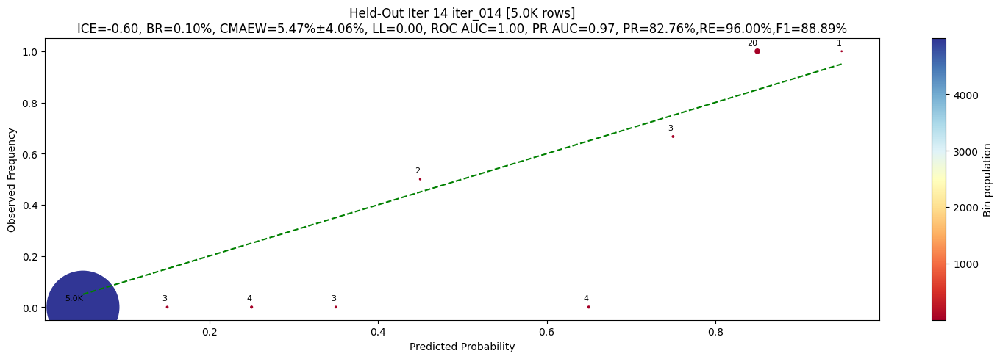

2025-12-22 16:27:59,264 - INFO - _compute_enrichment_factor-line:3024 - Computing enrichment (batched prediction)...
2025-12-22 16:28:26,165 - INFO - run-line:3186 - Training bootstrap models...


Bootstrap models:   0%|          | 0/5 [00:00<?, ?it/s]

Predicting models:   0%|          | 0/5 [00:00<?, ?it/s]

2025-12-22 16:39:33,534 - INFO - _pseudo_label_negatives-line:2567 - Pseudo-negatives added: 100, weight=1.00
2025-12-22 16:39:33,860 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR487209100025366_MJD58644.36245, row=41549583, conf=0.9997


2025-12-22 16:39:34,192 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR806212200076503_MJD59032.39702, row=92665749, conf=0.9997


2025-12-22 16:39:34,559 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR439202400020757_MJD58662.36115, row=37815518, conf=0.9995


2025-12-22 16:39:34,919 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR382204200124282_MJD58639.33985, row=25397368, conf=0.9997


2025-12-22 16:39:35,320 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR686209200110397_MJD58345.19573, row=74860535, conf=0.9995


2025-12-22 16:39:35,689 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR489209200089521_MJD58340.19408, row=43917068, conf=0.9996


2025-12-22 16:39:36,007 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR662212200007194_MJD58794.33946, row=71473653, conf=0.9997


2025-12-22 16:39:36,285 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR334205100084431_MJD58319.28954, row=20755184, conf=0.9996


2025-12-22 16:39:36,583 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR333204200063719_MJD58313.25823, row=17855870, conf=0.9996


2025-12-22 16:39:36,921 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR592206200111744_MJD58344.19461, row=61877430, conf=0.9995


2025-12-22 16:39:37,242 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR639210200147568_MJD58337.2144, row=67534187, conf=0.9996


2025-12-22 16:39:37,544 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR737211300038866_MJD59043.39999, row=82214227, conf=0.9995


2025-12-22 16:39:37,827 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR591213400151124_MJD58343.19602, row=61720163, conf=0.9995


2025-12-22 16:39:38,170 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR768206300085932_MJD58451.07208, row=83790961, conf=0.9995


2025-12-22 16:39:38,514 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR279206300136910_MJD58635.29941, row=1547267, conf=0.9996


2025-12-22 16:39:38,841 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR591206200163002_MJD58344.19293, row=61212155, conf=0.9995


2025-12-22 16:39:39,187 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR704203100027996_MJD58812.34031, row=76595367, conf=0.9996


2025-12-22 16:39:39,563 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR541208400054666_MJD58342.20624, row=53695282, conf=0.9996


2025-12-22 16:39:39,876 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR639212300075660_MJD58337.21339, row=67754178, conf=0.9995


2025-12-22 16:39:40,233 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR589213400119230_MJD58646.33946, row=59676465, conf=0.9995


2025-12-22 16:39:40,586 - INFO - _pseudo_label_positives-line:2722 - Pseudo-positives added: 20, weight=0.80
_init_credential_provider_builder(): credential_provider_init = None
2025-12-22 16:39:42,906 - INFO - _save_top_candidates-line:3085 - Top-1000 candidates saved to R:\Data\Astronomy\active_learning_output_20251222_134211\top_candidates\top_1000_iter_014.parquet
2025-12-22 16:39:45,641 - INFO - _review_pseudo_labels-line:2868 - Review: removed 0 pseudo-labels (known_flares: 0, unlabeled: 2595 reviewed)
2025-12-22 16:39:45,650 - INFO - _balance_class_weights-line:2969 - Effective train size: pos=172.5, neg=2390.0
2025-12-22 16:39:45,655 - INFO - run-line:3212 - Building training data...
2025-12-22 16:39:45,683 - INFO - run-line:3216 - Retraining main model...
2025-12-22 16:41:20,523 - INFO - _adjust_thresholds-line:2999 - Thresholds relaxed: pos>0.950, neg<0.100
2025-12-22 16:41:20,614 - INFO - run-line:3244 - OOB metrics: recall=0.986, precision=0.991, coverage=89.41%
2025-12-22 

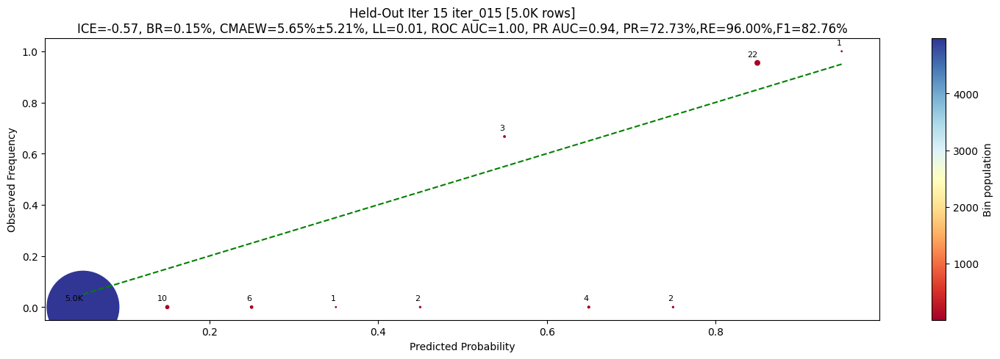

2025-12-22 16:41:24,881 - INFO - _compute_enrichment_factor-line:3024 - Computing enrichment (batched prediction)...
2025-12-22 16:41:45,937 - INFO - run-line:3186 - Training bootstrap models...


Bootstrap models:   0%|          | 0/5 [00:00<?, ?it/s]

Predicting models:   0%|          | 0/5 [00:00<?, ?it/s]

2025-12-22 16:53:27,106 - INFO - _pseudo_label_negatives-line:2567 - Pseudo-negatives added: 100, weight=1.00
2025-12-22 16:53:27,419 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR487207400145468_MJD58644.36136, row=41507533, conf=0.9996


2025-12-22 16:53:27,612 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR260212400068194_MJD58493.29148, row=555952, conf=0.9996


2025-12-22 16:53:27,830 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR283205200130123_MJD58312.26884, row=6936505, conf=0.9996


2025-12-22 16:53:28,069 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR687204200044763_MJD58658.32547, row=75550317, conf=0.9994


2025-12-22 16:53:28,366 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR335202400070994_MJD58674.36835, row=23465672, conf=0.9997


2025-12-22 16:53:28,694 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR279206400164003_MJD58635.30076, row=1566135, conf=0.9995


2025-12-22 16:53:29,132 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR283205200177251_MJD58312.2693, row=6923268, conf=0.9996


2025-12-22 16:53:29,475 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR686206300183330_MJD58346.19265, row=74489797, conf=0.9996


2025-12-22 16:53:29,755 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR280206200102131_MJD58303.22825, row=2791074, conf=0.9997


2025-12-22 16:53:30,053 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR262213400041174_MJD58493.36218, row=877716, conf=0.9995


2025-12-22 16:53:30,488 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR806204200057230_MJD59032.39756, row=91773768, conf=0.9996


2025-12-22 16:53:30,801 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR832205200059877_MJD58775.21285, row=93837663, conf=0.9996


2025-12-22 16:53:31,142 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR309202400058676_MJD58464.34184, row=12445752, conf=0.9995


2025-12-22 16:53:31,433 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR434209400094141_MJD58641.3409, row=33210487, conf=0.9995


2025-12-22 16:53:31,750 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR637212200050234_MJD58657.27876, row=66100613, conf=0.9995


2025-12-22 16:53:32,100 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR803216200059841_MJD58468.09247, row=89077614, conf=0.9995


2025-12-22 16:53:32,397 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR807209100056857_MJD58475.19584, row=93194008, conf=0.9995


2025-12-22 16:53:32,677 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR439212400011265_MJD58662.36209, row=37830194, conf=0.9995


2025-12-22 16:53:32,951 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR434209400103999_MJD58641.33955, row=33211659, conf=0.9996


2025-12-22 16:53:33,308 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR284207300092616_MJD58286.35077, row=10693726, conf=0.9996


2025-12-22 16:53:33,579 - INFO - _pseudo_label_positives-line:2722 - Pseudo-positives added: 20, weight=0.80
_init_credential_provider_builder(): credential_provider_init = None
2025-12-22 16:53:35,477 - INFO - _save_top_candidates-line:3085 - Top-1000 candidates saved to R:\Data\Astronomy\active_learning_output_20251222_134211\top_candidates\top_1000_iter_015.parquet
2025-12-22 16:53:38,325 - INFO - _review_pseudo_labels-line:2868 - Review: removed 0 pseudo-labels (known_flares: 0, unlabeled: 2715 reviewed)
2025-12-22 16:53:38,332 - INFO - _balance_class_weights-line:2969 - Effective train size: pos=188.5, neg=2490.0
2025-12-22 16:53:38,335 - INFO - run-line:3212 - Building training data...
2025-12-22 16:53:38,370 - INFO - run-line:3216 - Retraining main model...
2025-12-22 16:55:14,421 - INFO - _adjust_thresholds-line:2999 - Thresholds relaxed: pos>0.950, neg<0.100
2025-12-22 16:55:14,426 - INFO - _compute_enrichment_factor-line:3024 - Computing enrichment (batched prediction)...
202

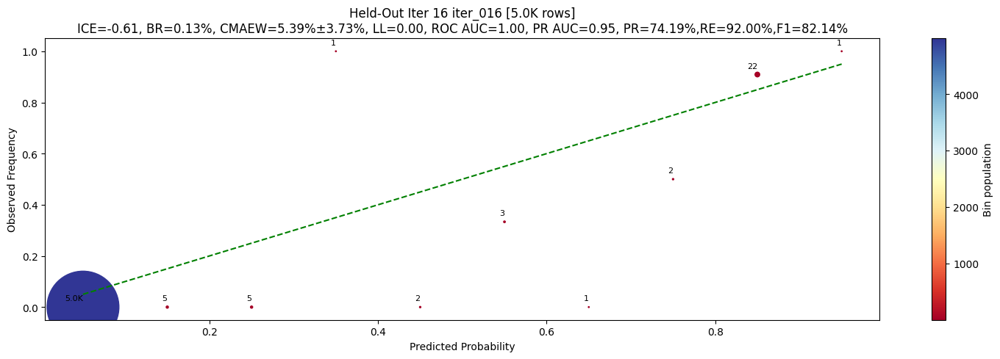

2025-12-22 16:55:47,128 - INFO - _compute_enrichment_factor-line:3024 - Computing enrichment (batched prediction)...
2025-12-22 16:56:09,446 - INFO - run-line:3186 - Training bootstrap models...


Bootstrap models:   0%|          | 0/5 [00:00<?, ?it/s]

Predicting models:   0%|          | 0/5 [00:00<?, ?it/s]

2025-12-22 17:06:48,961 - INFO - _pseudo_label_negatives-line:2567 - Pseudo-negatives added: 100, weight=1.00
2025-12-22 17:06:49,279 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR768214400067690_MJD58448.09622, row=83913033, conf=0.9993


2025-12-22 17:06:49,449 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR538206200090929_MJD58334.1954, row=49770919, conf=0.9993


2025-12-22 17:06:49,635 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR589201300104577_MJD58646.33942, row=59580753, conf=0.9994


2025-12-22 17:06:49,932 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR331210100133672_MJD58306.23789, row=15317483, conf=0.9994


2025-12-22 17:06:50,199 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR831212400011617_MJD58776.21229, row=93811983, conf=0.9994


2025-12-22 17:06:50,484 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR335206400066764_MJD58674.36742, row=23623980, conf=0.9994


2025-12-22 17:06:50,798 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR333204300128563_MJD58313.25823, row=17866743, conf=0.9994


2025-12-22 17:06:51,056 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR279209400170935_MJD58635.30165, row=1722531, conf=0.9994


2025-12-22 17:06:51,301 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR487212200140212_MJD58644.36134, row=41750502, conf=0.9994


2025-12-22 17:06:51,561 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR852204400035951_MJD59036.39659, row=93965349, conf=0.9994


2025-12-22 17:06:51,868 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR380209400004733_MJD59046.23606, row=24810597, conf=0.9994


2025-12-22 17:06:52,176 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR487212400157400_MJD58644.36179, row=41759719, conf=0.9995


2025-12-22 17:06:52,399 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR284212200159263_MJD58287.35461, row=11538546, conf=0.9994


2025-12-22 17:06:52,628 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR568214300017217_MJD58796.44096, row=59344277, conf=0.9993


2025-12-22 17:06:52,858 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR486206400067112_MJD58643.36152, row=40654567, conf=0.9994


2025-12-22 17:06:53,150 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR690202300023691_MJD58660.35786, row=76529998, conf=0.9994


2025-12-22 17:06:53,500 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR439201300033264_MJD58662.3611, row=37813853, conf=0.9994


2025-12-22 17:06:53,847 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR684204200030325_MJD58300.23558, row=72024467, conf=0.9994


2025-12-22 17:06:54,116 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR686205400078361_MJD58346.19462, row=74423505, conf=0.9993


2025-12-22 17:06:54,421 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR686212400144864_MJD58346.1924, row=75229907, conf=0.9994


2025-12-22 17:06:54,677 - INFO - _pseudo_label_positives-line:2722 - Pseudo-positives added: 20, weight=0.80
_init_credential_provider_builder(): credential_provider_init = None
2025-12-22 17:06:56,664 - INFO - _save_top_candidates-line:3085 - Top-1000 candidates saved to R:\Data\Astronomy\active_learning_output_20251222_134211\top_candidates\top_1000_iter_016.parquet
2025-12-22 17:06:59,672 - INFO - _review_pseudo_labels-line:2868 - Review: removed 0 pseudo-labels (known_flares: 0, unlabeled: 2835 reviewed)
2025-12-22 17:06:59,679 - INFO - _balance_class_weights-line:2969 - Effective train size: pos=204.5, neg=2590.0
2025-12-22 17:06:59,682 - INFO - run-line:3212 - Building training data...
2025-12-22 17:06:59,706 - INFO - run-line:3216 - Retraining main model...
2025-12-22 17:08:13,618 - INFO - _adjust_thresholds-line:2999 - Thresholds relaxed: pos>0.950, neg<0.100
2025-12-22 17:08:13,695 - INFO - run-line:3244 - OOB metrics: recall=0.981, precision=0.992, coverage=91.13%
2025-12-22 

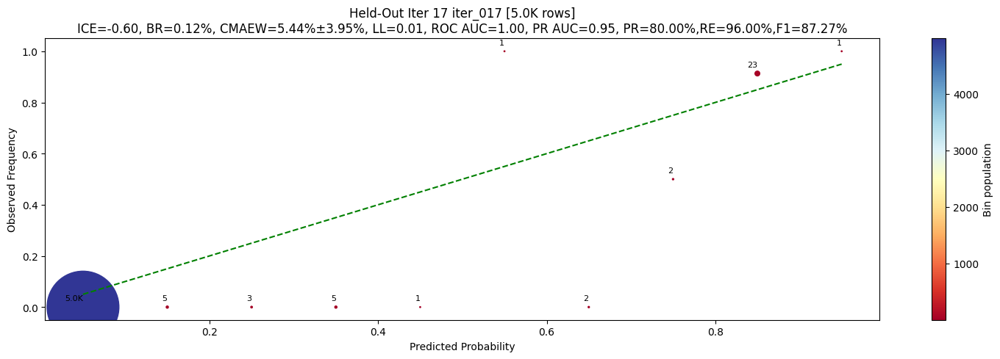

2025-12-22 17:08:17,970 - INFO - _compute_enrichment_factor-line:3024 - Computing enrichment (batched prediction)...
2025-12-22 17:08:38,721 - INFO - run-line:3186 - Training bootstrap models...


Bootstrap models:   0%|          | 0/5 [00:00<?, ?it/s]

Predicting models:   0%|          | 0/5 [00:00<?, ?it/s]

2025-12-22 17:18:54,051 - INFO - _pseudo_label_negatives-line:2567 - Pseudo-negatives added: 100, weight=1.00
2025-12-22 17:18:54,428 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR685213400089275_MJD58345.194, row=73592791, conf=0.9997


2025-12-22 17:18:54,826 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR805213400010678_MJD58476.11386, row=91306652, conf=0.9998


2025-12-22 17:18:55,138 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR803204200097819_MJD58468.09447, row=88953732, conf=0.9997


2025-12-22 17:18:55,473 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR284209100038227_MJD58287.35441, row=11025482, conf=0.9997


2025-12-22 17:18:55,740 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR541209100065808_MJD58342.20445, row=53711378, conf=0.9997


2025-12-22 17:18:56,052 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR284204200108915_MJD58286.35127, row=10260441, conf=0.9997


2025-12-22 17:18:56,323 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR331208400188968_MJD58305.23706, row=15039786, conf=0.9998


2025-12-22 17:18:56,615 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR334212200013770_MJD58319.28845, row=22516724, conf=0.9997


2025-12-22 17:18:56,957 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR541206200104277_MJD58342.20448, row=53507378, conf=0.9997


2025-12-22 17:18:57,247 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR330216400048591_MJD58289.27628, row=13534127, conf=0.9997


2025-12-22 17:18:57,556 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR541210400094820_MJD58342.20539, row=53826248, conf=0.9997


2025-12-22 17:18:57,841 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR772210200023252_MJD58649.39672, row=85599085, conf=0.9997


2025-12-22 17:18:58,144 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR283213400190360_MJD58311.26944, row=8914114, conf=0.9997


2025-12-22 17:18:58,447 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR331212100178701_MJD58305.23746, row=15771328, conf=0.9997


2025-12-22 17:18:58,735 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR382208400112950_MJD58639.33982, row=25587472, conf=0.9997


2025-12-22 17:18:59,022 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR283206400160185_MJD58312.27201, row=7303455, conf=0.9997


2025-12-22 17:18:59,287 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR385202400133527_MJD58291.36229, row=28991535, conf=0.9997


2025-12-22 17:18:59,606 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR411213400046227_MJD58456.29797, row=31822272, conf=0.9997


2025-12-22 17:18:59,905 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR309209200055037_MJD58464.3393, row=12497861, conf=0.9997


2025-12-22 17:19:00,211 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR768214400055438_MJD58448.09622, row=83914739, conf=0.9997


2025-12-22 17:19:00,496 - INFO - _pseudo_label_positives-line:2722 - Pseudo-positives added: 20, weight=0.80
_init_credential_provider_builder(): credential_provider_init = None
2025-12-22 17:19:02,735 - INFO - _save_top_candidates-line:3085 - Top-1000 candidates saved to R:\Data\Astronomy\active_learning_output_20251222_134211\top_candidates\top_1000_iter_017.parquet
2025-12-22 17:19:05,673 - INFO - _review_pseudo_labels-line:2868 - Review: removed 0 pseudo-labels (known_flares: 0, unlabeled: 2955 reviewed)
2025-12-22 17:19:05,683 - INFO - _balance_class_weights-line:2969 - Effective train size: pos=220.5, neg=2690.0
2025-12-22 17:19:05,687 - INFO - run-line:3212 - Building training data...
2025-12-22 17:19:05,727 - INFO - run-line:3216 - Retraining main model...
2025-12-22 17:20:13,394 - INFO - _adjust_thresholds-line:2999 - Thresholds relaxed: pos>0.950, neg<0.100
2025-12-22 17:20:13,475 - INFO - run-line:3244 - OOB metrics: recall=0.985, precision=1.000, coverage=89.05%
2025-12-22 

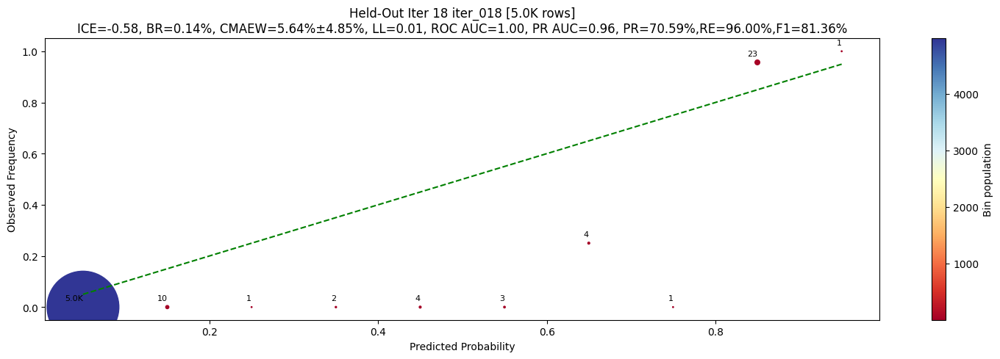

2025-12-22 17:20:18,362 - INFO - _compute_enrichment_factor-line:3024 - Computing enrichment (batched prediction)...
2025-12-22 17:20:39,142 - INFO - run-line:3186 - Training bootstrap models...


Bootstrap models:   0%|          | 0/5 [00:00<?, ?it/s]

Predicting models:   0%|          | 0/5 [00:00<?, ?it/s]

2025-12-22 17:29:38,653 - INFO - _pseudo_label_negatives-line:2567 - Pseudo-negatives added: 100, weight=1.00
2025-12-22 17:29:38,990 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR485208400058907_MJD58642.32068, row=40155498, conf=0.9989


2025-12-22 17:29:39,241 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR382212300081202_MJD58639.3416, row=25694262, conf=0.9990


2025-12-22 17:29:39,527 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR768214400053485_MJD58451.06854, row=83913572, conf=0.9983


2025-12-22 17:29:39,843 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR260212200073103_MJD58493.29059, row=543857, conf=0.9988


2025-12-22 17:29:40,164 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR309207100051216_MJD58464.3859, row=12479435, conf=0.9990


2025-12-22 17:29:40,447 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR285210400038891_MJD58666.36131, row=12332900, conf=0.9988


2025-12-22 17:29:40,757 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR589202400143069_MJD58646.33945, row=59599006, conf=0.9989


2025-12-22 17:29:41,027 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR536206200018533_MJD59018.40579, row=48280204, conf=0.9988


2025-12-22 17:29:41,318 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR766205100052523_MJD58294.39884, row=83010286, conf=0.9989


2025-12-22 17:29:41,606 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR686210400115107_MJD58346.19348, row=74952490, conf=0.9991


2025-12-22 17:29:41,951 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR538208200069710_MJD58334.19425, row=50009299, conf=0.9990


2025-12-22 17:29:42,236 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR685206400015403_MJD58346.19187, row=72966914, conf=0.9989


2025-12-22 17:29:42,537 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR806206400012541_MJD58473.09603, row=92005117, conf=0.9986


2025-12-22 17:29:42,856 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR638209200104482_MJD58338.21311, row=66622733, conf=0.9990


2025-12-22 17:29:43,198 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR279209200161676_MJD58635.30121, row=1695927, conf=0.9991


2025-12-22 17:29:43,490 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR283205200177251_MJD58311.27399, row=6957665, conf=0.9990


2025-12-22 17:29:43,831 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR639211400163303_MJD58337.21351, row=67702641, conf=0.9988


2025-12-22 17:29:44,109 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR432214100036196_MJD59014.40461, row=32779935, conf=0.9989


2025-12-22 17:29:44,435 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR536204100034180_MJD59018.40448, row=48272238, conf=0.9989


2025-12-22 17:29:44,851 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR279213400112782_MJD58635.30346, row=1876330, conf=0.9988


2025-12-22 17:29:45,154 - INFO - _pseudo_label_positives-line:2722 - Pseudo-positives added: 20, weight=0.80
_init_credential_provider_builder(): credential_provider_init = None
2025-12-22 17:29:47,819 - INFO - _save_top_candidates-line:3085 - Top-1000 candidates saved to R:\Data\Astronomy\active_learning_output_20251222_134211\top_candidates\top_1000_iter_018.parquet
2025-12-22 17:29:50,422 - INFO - _review_pseudo_labels-line:2868 - Review: removed 0 pseudo-labels (known_flares: 0, unlabeled: 3075 reviewed)
2025-12-22 17:29:50,431 - INFO - _balance_class_weights-line:2969 - Effective train size: pos=236.5, neg=2790.0
2025-12-22 17:29:50,435 - INFO - run-line:3212 - Building training data...
2025-12-22 17:29:50,463 - INFO - run-line:3216 - Retraining main model...
2025-12-22 17:30:08,987 - INFO - _adjust_thresholds-line:2999 - Thresholds relaxed: pos>0.950, neg<0.100
2025-12-22 17:30:09,066 - INFO - run-line:3244 - OOB metrics: recall=0.997, precision=0.993, coverage=90.30%
2025-12-22 

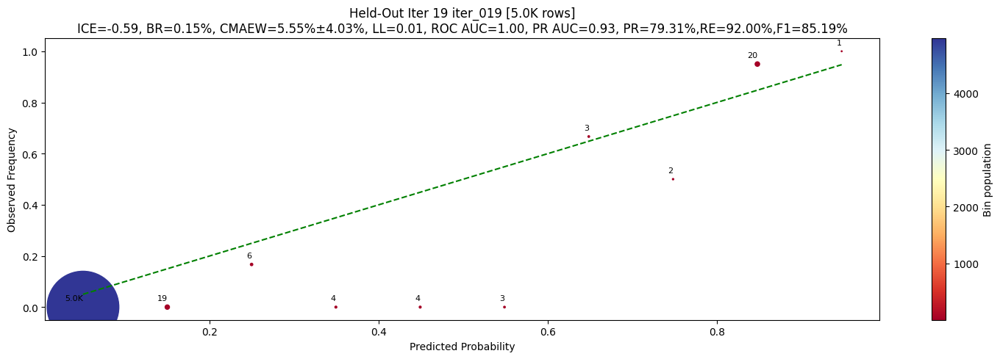

2025-12-22 17:30:13,811 - INFO - _compute_enrichment_factor-line:3024 - Computing enrichment (batched prediction)...
2025-12-22 17:30:32,693 - INFO - run-line:3186 - Training bootstrap models...


Bootstrap models:   0%|          | 0/5 [00:00<?, ?it/s]

Predicting models:   0%|          | 0/5 [00:00<?, ?it/s]

2025-12-22 17:39:19,232 - INFO - _pseudo_label_negatives-line:2567 - Pseudo-negatives added: 100, weight=1.00
2025-12-22 17:39:19,540 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR565214300013907_MJD58795.33931, row=58101982, conf=0.9986


2025-12-22 17:39:19,836 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR768209200103259_MJD58451.06956, row=83846379, conf=0.9987


2025-12-22 17:39:20,187 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR767206300106405_MJD58451.06915, row=83295388, conf=0.9987


2025-12-22 17:39:20,534 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR768208400054113_MJD58451.07179, row=83835855, conf=0.9988


2025-12-22 17:39:20,846 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR767209200092586_MJD58451.07041, row=83398828, conf=0.9986


2025-12-22 17:39:21,199 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR591206400137820_MJD58344.19303, row=61282007, conf=0.9987


2025-12-22 17:39:21,569 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR591212400148926_MJD58343.19402, row=61681840, conf=0.9986


2025-12-22 17:39:21,888 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR284202300113356_MJD58286.35209, row=10059032, conf=0.9987


2025-12-22 17:39:22,214 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR334213400083222_MJD58319.28859, row=22751028, conf=0.9986


2025-12-22 17:39:22,535 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR589202400139969_MJD58646.33993, row=59596699, conf=0.9986


2025-12-22 17:39:22,813 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR769206100084392_MJD58466.09112, row=84281390, conf=0.9986


2025-12-22 17:39:23,145 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR279206400129681_MJD58635.29986, row=1568704, conf=0.9986


2025-12-22 17:39:23,557 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR689212400054396_MJD58449.0693, row=76413418, conf=0.9987


2025-12-22 17:39:23,835 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR768206300047381_MJD58451.07023, row=83792872, conf=0.9986


2025-12-22 17:39:24,140 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR771212300035053_MJD58461.14826, row=85445224, conf=0.9986


2025-12-22 17:39:24,418 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR803204100050069_MJD58468.09233, row=88949855, conf=0.9986


2025-12-22 17:39:24,751 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR383205200117459_MJD58638.38273, row=25926095, conf=0.9986


2025-12-22 17:39:25,020 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR685206200091711_MJD58345.19588, row=72918107, conf=0.9987


2025-12-22 17:39:25,296 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR541205400087100_MJD58342.2046, row=53478013, conf=0.9986


2025-12-22 17:39:25,626 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR540209400160863_MJD58342.20378, row=52856056, conf=0.9986


2025-12-22 17:39:25,881 - INFO - _pseudo_label_positives-line:2722 - Pseudo-positives added: 20, weight=0.80
_init_credential_provider_builder(): credential_provider_init = None
2025-12-22 17:39:28,349 - INFO - _save_top_candidates-line:3085 - Top-1000 candidates saved to R:\Data\Astronomy\active_learning_output_20251222_134211\top_candidates\top_1000_iter_019.parquet
2025-12-22 17:39:31,032 - INFO - _review_pseudo_labels-line:2868 - Review: removed 0 pseudo-labels (known_flares: 0, unlabeled: 3195 reviewed)
2025-12-22 17:39:31,040 - INFO - _balance_class_weights-line:2969 - Effective train size: pos=252.5, neg=2890.0
2025-12-22 17:39:31,043 - INFO - run-line:3212 - Building training data...
2025-12-22 17:39:31,072 - INFO - run-line:3216 - Retraining main model...
2025-12-22 17:41:10,471 - INFO - _adjust_thresholds-line:2999 - Thresholds relaxed: pos>0.950, neg<0.100
2025-12-22 17:41:10,550 - INFO - run-line:3244 - OOB metrics: recall=0.978, precision=0.997, coverage=90.88%
2025-12-22 

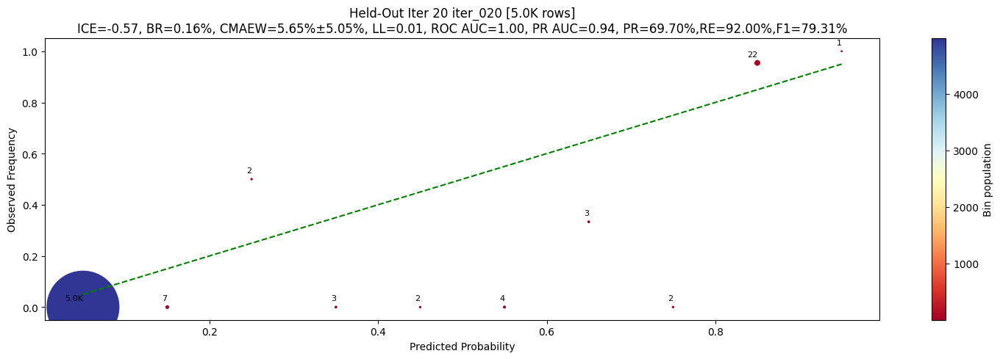

2025-12-22 17:41:14,775 - INFO - _compute_enrichment_factor-line:3024 - Computing enrichment (batched prediction)...
2025-12-22 17:41:36,351 - INFO - run-line:3186 - Training bootstrap models...


Bootstrap models:   0%|          | 0/5 [00:00<?, ?it/s]

Predicting models:   0%|          | 0/5 [00:00<?, ?it/s]

2025-12-22 17:50:05,162 - INFO - _pseudo_label_negatives-line:2567 - Pseudo-negatives added: 100, weight=1.00
2025-12-22 17:50:05,485 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR541213400064188_MJD58342.20443, row=54172224, conf=0.9995


2025-12-22 17:50:05,773 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR284205400085764_MJD58286.35061, row=10478861, conf=0.9995


2025-12-22 17:50:06,070 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR336204200050097_MJD58667.36254, row=24275784, conf=0.9996


2025-12-22 17:50:06,434 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR485210200049153_MJD58642.32187, row=40199728, conf=0.9995


2025-12-22 17:50:06,789 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR683202400041018_MJD58322.29464, row=71926493, conf=0.9996


2025-12-22 17:50:07,109 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR489210100070352_MJD58340.19494, row=44002020, conf=0.9995


2025-12-22 17:50:07,422 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR769209200066369_MJD58466.09133, row=84498970, conf=0.9995


2025-12-22 17:50:07,721 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR539210200159688_MJD58334.1961, row=51302057, conf=0.9995


2025-12-22 17:50:07,991 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR767212300052810_MJD58448.09569, row=83527470, conf=0.9995


2025-12-22 17:50:08,320 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR335206400055591_MJD58674.36742, row=23624688, conf=0.9996


2025-12-22 17:50:08,590 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR830206100069868_MJD58777.21209, row=93626695, conf=0.9995


2025-12-22 17:50:08,937 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR279210400101254_MJD58635.30031, row=1776050, conf=0.9995


2025-12-22 17:50:09,246 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR768204200087788_MJD58451.07169, row=83711607, conf=0.9995


2025-12-22 17:50:09,532 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR803216400108762_MJD58468.09297, row=89081396, conf=0.9995


2025-12-22 17:50:09,852 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR767209200071052_MJD58451.06852, row=83398044, conf=0.9995


2025-12-22 17:50:10,152 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR360210300043032_MJD58491.26767, row=24660499, conf=0.9995


2025-12-22 17:50:10,453 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR683206100045514_MJD58322.29445, row=71939853, conf=0.9995


2025-12-22 17:50:10,760 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR589213200066953_MJD58646.3394, row=59673952, conf=0.9995


2025-12-22 17:50:11,076 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR685207400090528_MJD58345.19682, row=73049755, conf=0.9995


2025-12-22 17:50:11,425 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR438212300088048_MJD58669.33977, row=37730150, conf=0.9995


2025-12-22 17:50:11,743 - INFO - _pseudo_label_positives-line:2722 - Pseudo-positives added: 20, weight=0.80
_init_credential_provider_builder(): credential_provider_init = None
2025-12-22 17:50:13,732 - INFO - _save_top_candidates-line:3085 - Top-1000 candidates saved to R:\Data\Astronomy\active_learning_output_20251222_134211\top_candidates\top_1000_iter_020.parquet
2025-12-22 17:50:16,287 - INFO - _review_pseudo_labels-line:2868 - Review: removed 0 pseudo-labels (known_flares: 0, unlabeled: 3315 reviewed)
2025-12-22 17:50:16,294 - INFO - _balance_class_weights-line:2969 - Effective train size: pos=268.5, neg=2990.0
2025-12-22 17:50:16,297 - INFO - run-line:3212 - Building training data...
2025-12-22 17:50:16,325 - INFO - run-line:3216 - Retraining main model...
2025-12-22 17:51:53,096 - INFO - _adjust_thresholds-line:2999 - Thresholds relaxed: pos>0.950, neg<0.100
2025-12-22 17:51:53,101 - INFO - _compute_enrichment_factor-line:3024 - Computing enrichment (batched prediction)...
202

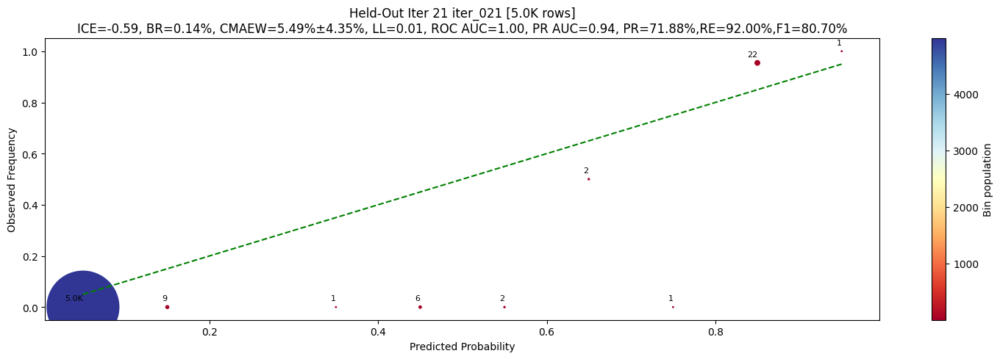

2025-12-22 17:52:24,261 - INFO - _compute_enrichment_factor-line:3024 - Computing enrichment (batched prediction)...
2025-12-22 17:52:45,431 - INFO - run-line:3186 - Training bootstrap models...


Bootstrap models:   0%|          | 0/5 [00:00<?, ?it/s]

Predicting models:   0%|          | 0/5 [00:00<?, ?it/s]

2025-12-22 18:01:07,677 - INFO - _pseudo_label_negatives-line:2567 - Pseudo-negatives added: 100, weight=1.00
2025-12-22 18:01:08,004 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR260205400075314_MJD58493.28948, row=434098, conf=0.9990


2025-12-22 18:01:08,404 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR311204400045006_MJD58494.31482, row=12666747, conf=0.9990


2025-12-22 18:01:08,764 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR767213400080931_MJD58451.06956, row=83562296, conf=0.9986


2025-12-22 18:01:09,069 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR772209200038455_MJD58776.3393, row=85594973, conf=0.9991


2025-12-22 18:01:09,330 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR280210400059489_MJD58303.22737, row=3585100, conf=0.9990


2025-12-22 18:01:09,579 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR772201400027942_MJD58776.33913, row=85570170, conf=0.9988


2025-12-22 18:01:09,771 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR541213400080675_MJD58341.26192, row=54164511, conf=0.9989


2025-12-22 18:01:09,938 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR260210200050794_MJD58476.33832, row=514981, conf=0.9990


2025-12-22 18:01:10,191 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR284209100038227_MJD58286.35061, row=11015014, conf=0.9989


2025-12-22 18:01:10,427 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR733210100003923_MJD58648.37928, row=82150683, conf=0.9989


2025-12-22 18:01:10,671 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR489210200109196_MJD58340.19402, row=44004339, conf=0.9989


2025-12-22 18:01:10,916 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR637212200033463_MJD58657.2765, row=66100692, conf=0.9989


2025-12-22 18:01:11,202 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR280210200176221_MJD58303.23236, row=3497597, conf=0.9989


2025-12-22 18:01:11,428 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR279201400121679_MJD58635.29937, row=1088764, conf=0.9989


2025-12-22 18:01:11,660 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR438210200035523_MJD58669.33964, row=37668431, conf=0.9990


2025-12-22 18:01:11,945 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR284202300102647_MJD58286.35071, row=10051792, conf=0.9990


2025-12-22 18:01:12,228 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR385206400135494_MJD58292.36259, row=29497373, conf=0.9990


2025-12-22 18:01:12,505 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR537204200062489_MJD58665.36118, row=48411900, conf=0.9990


2025-12-22 18:01:12,796 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR768208200009334_MJD58451.06805, row=83830581, conf=0.9989


2025-12-22 18:01:13,131 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR284205200100355_MJD58286.35064, row=10434475, conf=0.9989


2025-12-22 18:01:13,426 - INFO - _pseudo_label_positives-line:2722 - Pseudo-positives added: 20, weight=0.80
_init_credential_provider_builder(): credential_provider_init = None
2025-12-22 18:01:15,574 - INFO - _save_top_candidates-line:3085 - Top-1000 candidates saved to R:\Data\Astronomy\active_learning_output_20251222_134211\top_candidates\top_1000_iter_021.parquet
2025-12-22 18:01:19,053 - INFO - _review_pseudo_labels-line:2868 - Review: removed 0 pseudo-labels (known_flares: 0, unlabeled: 3435 reviewed)
2025-12-22 18:01:19,060 - INFO - _balance_class_weights-line:2969 - Effective train size: pos=284.5, neg=3090.0
2025-12-22 18:01:19,064 - INFO - run-line:3212 - Building training data...
2025-12-22 18:01:19,090 - INFO - run-line:3216 - Retraining main model...
2025-12-22 18:02:59,558 - INFO - _adjust_thresholds-line:2999 - Thresholds relaxed: pos>0.950, neg<0.100
2025-12-22 18:02:59,641 - INFO - run-line:3244 - OOB metrics: recall=0.991, precision=0.994, coverage=90.39%
2025-12-22 

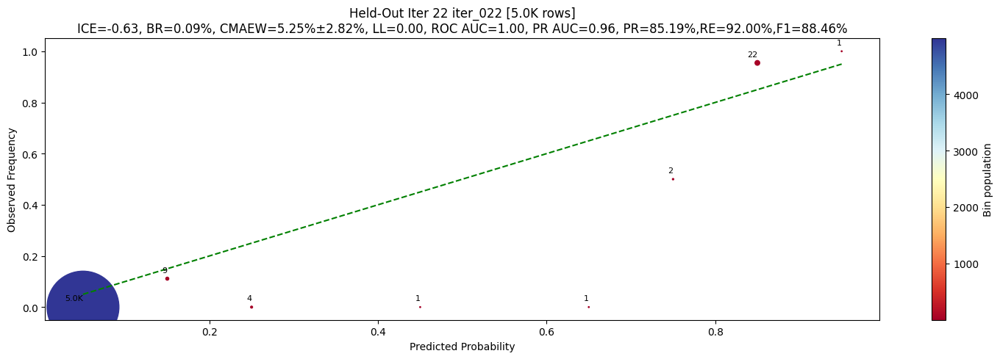

2025-12-22 18:03:04,395 - INFO - _compute_enrichment_factor-line:3024 - Computing enrichment (batched prediction)...
2025-12-22 18:03:26,297 - INFO - run-line:3186 - Training bootstrap models...


Bootstrap models:   0%|          | 0/5 [00:00<?, ?it/s]

Predicting models:   0%|          | 0/5 [00:00<?, ?it/s]

2025-12-22 18:14:41,254 - INFO - _pseudo_label_negatives-line:2567 - Pseudo-negatives added: 100, weight=1.00
2025-12-22 18:14:41,729 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR733207400019437_MJD58648.37691, row=82145649, conf=0.9998


2025-12-22 18:14:42,097 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR438213400049776_MJD58669.34091, row=37753997, conf=0.9998


2025-12-22 18:14:42,428 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR768206300080927_MJD58451.07115, row=83790908, conf=0.9998


2025-12-22 18:14:42,762 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR852210100022194_MJD59036.39592, row=93974710, conf=0.9997


2025-12-22 18:14:43,118 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR638202400092825_MJD58337.21395, row=66281658, conf=0.9998


2025-12-22 18:14:43,469 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR615205200000282_MJD58797.34925, row=65050561, conf=0.9997


2025-12-22 18:14:43,776 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR282210200151412_MJD58308.2584, row=5564055, conf=0.9997


2025-12-22 18:14:44,086 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR769201400063813_MJD58466.09108, row=83983136, conf=0.9998


2025-12-22 18:14:44,423 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR686205400047199_MJD58345.195, row=74422464, conf=0.9998


2025-12-22 18:14:44,774 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR591212400096303_MJD58344.19648, row=61680921, conf=0.9998


2025-12-22 18:14:45,103 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR257213100010905_MJD58471.32084, row=53311, conf=0.9996


2025-12-22 18:14:45,447 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR806213300000987_MJD59032.39831, row=92814218, conf=0.9997


2025-12-22 18:14:45,713 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR638202400092828_MJD58337.21302, row=66282750, conf=0.9997


2025-12-22 18:14:46,038 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR768214400055193_MJD58451.07422, row=83915350, conf=0.9998


2025-12-22 18:14:46,323 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR686205400075729_MJD58345.19964, row=74420677, conf=0.9997


2025-12-22 18:14:46,644 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR768214400071774_MJD58451.06854, row=83913412, conf=0.9997


2025-12-22 18:14:47,019 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR541204200088853_MJD58342.2099, row=53389118, conf=0.9997


2025-12-22 18:14:47,338 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR639205200084353_MJD58338.21486, row=67152714, conf=0.9997


2025-12-22 18:14:47,654 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR591201300118224_MJD58343.19718, row=60879678, conf=0.9997


2025-12-22 18:14:47,959 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR638202300133481_MJD58338.21421, row=66273468, conf=0.9997


2025-12-22 18:14:48,256 - INFO - _pseudo_label_positives-line:2722 - Pseudo-positives added: 20, weight=0.80
_init_credential_provider_builder(): credential_provider_init = None
2025-12-22 18:14:50,996 - INFO - _save_top_candidates-line:3085 - Top-1000 candidates saved to R:\Data\Astronomy\active_learning_output_20251222_134211\top_candidates\top_1000_iter_022.parquet
2025-12-22 18:14:53,907 - INFO - _review_pseudo_labels-line:2868 - Review: removed 0 pseudo-labels (known_flares: 0, unlabeled: 3555 reviewed)
2025-12-22 18:14:53,914 - INFO - _balance_class_weights-line:2969 - Effective train size: pos=300.5, neg=3190.0
2025-12-22 18:14:53,917 - INFO - run-line:3212 - Building training data...
2025-12-22 18:14:53,946 - INFO - run-line:3216 - Retraining main model...
2025-12-22 18:15:11,929 - INFO - _adjust_thresholds-line:2999 - Thresholds relaxed: pos>0.950, neg<0.100
2025-12-22 18:15:12,008 - INFO - run-line:3244 - OOB metrics: recall=0.989, precision=0.997, coverage=90.74%
2025-12-22 

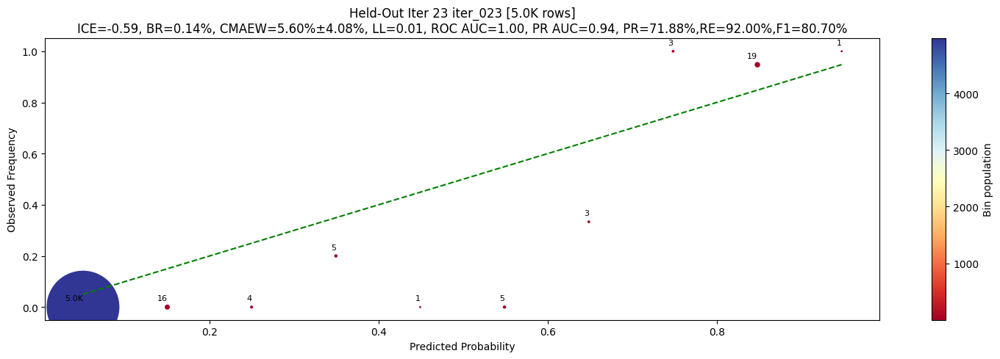

2025-12-22 18:15:16,045 - INFO - _compute_enrichment_factor-line:3024 - Computing enrichment (batched prediction)...
2025-12-22 18:15:35,695 - INFO - run-line:3186 - Training bootstrap models...


Bootstrap models:   0%|          | 0/5 [00:00<?, ?it/s]

Predicting models:   0%|          | 0/5 [00:00<?, ?it/s]

2025-12-22 18:24:36,688 - INFO - _pseudo_label_negatives-line:2567 - Pseudo-negatives added: 100, weight=1.00
2025-12-22 18:24:37,022 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR688205400062497_MJD58449.06867, row=75744099, conf=0.9986


2025-12-22 18:24:37,324 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR485211400048199_MJD58642.31968, row=40230544, conf=0.9986


2025-12-22 18:24:37,673 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR689201300006087_MJD58449.07147, row=76144447, conf=0.9986


2025-12-22 18:24:37,961 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR639216200076119_MJD58338.20738, row=68079666, conf=0.9986


2025-12-22 18:24:38,181 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR801206100060849_MJD58652.35528, row=88631236, conf=0.9986


2025-12-22 18:24:38,435 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR683205200048143_MJD58323.29711, row=71936407, conf=0.9986


2025-12-22 18:24:38,624 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR769213400099598_MJD58466.09232, row=84733365, conf=0.9987


2025-12-22 18:24:38,823 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR335201300040002_MJD58674.36743, row=23431414, conf=0.9986


2025-12-22 18:24:39,159 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR683205200004801_MJD58322.29446, row=71935689, conf=0.9986


2025-12-22 18:24:39,441 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR642210200047901_MJD58661.35784, row=69189036, conf=0.9986


2025-12-22 18:24:39,800 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR803206300067143_MJD58468.09262, row=88978485, conf=0.9986


2025-12-22 18:24:40,148 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR831209200025841_MJD58776.21264, row=93800953, conf=0.9986


2025-12-22 18:24:40,447 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR334210200182714_MJD58319.28854, row=22008536, conf=0.9986


2025-12-22 18:24:40,691 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR637201300066402_MJD58657.27632, row=65846062, conf=0.9986


2025-12-22 18:24:41,072 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR336209200049419_MJD58667.36283, row=24283988, conf=0.9986


2025-12-22 18:24:41,457 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR333204100089236_MJD58313.25827, row=17831849, conf=0.9985


2025-12-22 18:24:41,807 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR832210400050852_MJD58775.2132, row=93871492, conf=0.9986


2025-12-22 18:24:42,053 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR591206400106526_MJD58343.19428, row=61271748, conf=0.9986


2025-12-22 18:24:42,390 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR685206400097779_MJD58345.19411, row=72956397, conf=0.9986


2025-12-22 18:24:42,691 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR279206200137497_MJD58635.29941, row=1530613, conf=0.9986


2025-12-22 18:24:42,930 - INFO - _pseudo_label_positives-line:2722 - Pseudo-positives added: 20, weight=0.80
_init_credential_provider_builder(): credential_provider_init = None
2025-12-22 18:24:44,553 - INFO - _save_top_candidates-line:3085 - Top-1000 candidates saved to R:\Data\Astronomy\active_learning_output_20251222_134211\top_candidates\top_1000_iter_023.parquet
2025-12-22 18:24:47,427 - INFO - _review_pseudo_labels-line:2868 - Review: removed 0 pseudo-labels (known_flares: 0, unlabeled: 3675 reviewed)
2025-12-22 18:24:47,434 - INFO - _balance_class_weights-line:2969 - Effective train size: pos=316.5, neg=3290.0
2025-12-22 18:24:47,438 - INFO - run-line:3212 - Building training data...
2025-12-22 18:24:47,465 - INFO - run-line:3216 - Retraining main model...
2025-12-22 18:25:04,767 - INFO - _adjust_thresholds-line:2999 - Thresholds relaxed: pos>0.950, neg<0.100
2025-12-22 18:25:04,856 - INFO - run-line:3244 - OOB metrics: recall=0.992, precision=0.995, coverage=90.23%
2025-12-22 

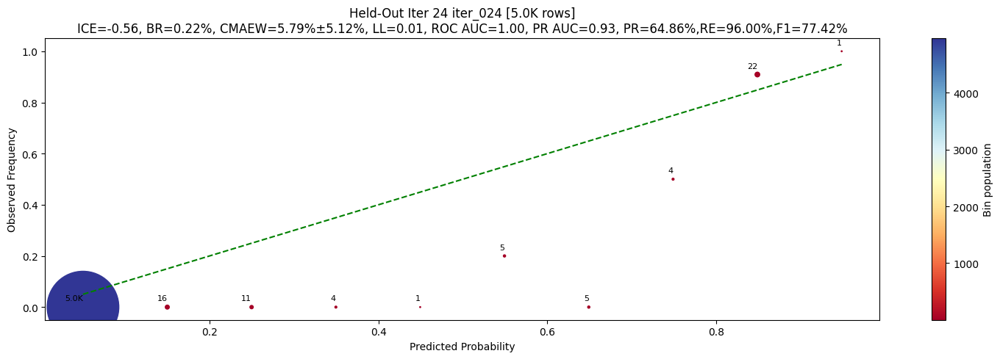

2025-12-22 18:25:09,337 - INFO - _compute_enrichment_factor-line:3024 - Computing enrichment (batched prediction)...
2025-12-22 18:25:27,656 - INFO - run-line:3186 - Training bootstrap models...


Bootstrap models:   0%|          | 0/5 [00:00<?, ?it/s]

Predicting models:   0%|          | 0/5 [00:00<?, ?it/s]

2025-12-22 18:34:07,214 - INFO - _pseudo_label_negatives-line:2567 - Pseudo-negatives added: 100, weight=1.00
2025-12-22 18:34:07,547 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR280210200068399_MJD58303.23236, row=3497544, conf=0.9982


2025-12-22 18:34:07,795 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR588216400032276_MJD58645.33821, row=59572098, conf=0.9983


2025-12-22 18:34:08,076 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR772208100022573_MJD58649.39704, row=85590982, conf=0.9987


2025-12-22 18:34:08,396 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR281212200171255_MJD58636.3427, row=4711069, conf=0.9986


2025-12-22 18:34:08,732 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR311204400062562_MJD58494.31482, row=12666547, conf=0.9987


2025-12-22 18:34:09,074 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR689208400031925_MJD58449.06832, row=76304525, conf=0.9987


2025-12-22 18:34:09,375 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR591212400142749_MJD58343.19402, row=61680203, conf=0.9986


2025-12-22 18:34:09,703 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR689206300041601_MJD58449.07136, row=76235912, conf=0.9987


2025-12-22 18:34:10,020 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR592210400101369_MJD58344.20205, row=61983534, conf=0.9986


2025-12-22 18:34:10,285 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR768216200002744_MJD58451.0692, row=83930794, conf=0.9987


2025-12-22 18:34:10,565 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR588212200032521_MJD58645.34508, row=59563310, conf=0.9987


2025-12-22 18:34:10,841 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR331210200152241_MJD58304.23699, row=15399401, conf=0.9987


2025-12-22 18:34:11,143 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR766206200047343_MJD58295.39352, row=83024325, conf=0.9986


2025-12-22 18:34:11,437 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR831206300036257_MJD58776.21262, row=93791869, conf=0.9987


2025-12-22 18:34:11,724 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR591201400074467_MJD58344.19503, row=60896629, conf=0.9986


2025-12-22 18:34:12,000 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR434209400098134_MJD58641.33954, row=33212245, conf=0.9985


2025-12-22 18:34:12,320 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR489206300119002_MJD58340.19412, row=43466011, conf=0.9987


2025-12-22 18:34:12,676 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR489206400117106_MJD58340.19413, row=43490411, conf=0.9987


2025-12-22 18:34:13,041 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR767209400118160_MJD58451.08271, row=83424134, conf=0.9987


2025-12-22 18:34:13,385 - INFO - _pseudo_label_positives-line:2709 -   Added pseudo_pos: id=ZTFDR488208400167676_MJD58340.19318, row=42560951, conf=0.9986


2025-12-22 18:34:13,651 - INFO - _pseudo_label_positives-line:2722 - Pseudo-positives added: 20, weight=0.80
_init_credential_provider_builder(): credential_provider_init = None
2025-12-22 18:34:16,483 - INFO - _save_top_candidates-line:3085 - Top-1000 candidates saved to R:\Data\Astronomy\active_learning_output_20251222_134211\top_candidates\top_1000_iter_024.parquet
2025-12-22 18:34:19,625 - INFO - _review_pseudo_labels-line:2868 - Review: removed 0 pseudo-labels (known_flares: 0, unlabeled: 3795 reviewed)
2025-12-22 18:34:19,632 - INFO - _balance_class_weights-line:2969 - Effective train size: pos=332.5, neg=3390.0
2025-12-22 18:34:19,636 - INFO - run-line:3212 - Building training data...
2025-12-22 18:34:19,667 - INFO - run-line:3216 - Retraining main model...
2025-12-22 18:34:37,321 - INFO - _adjust_thresholds-line:2999 - Thresholds relaxed: pos>0.950, neg<0.100
2025-12-22 18:34:37,395 - INFO - run-line:3244 - OOB metrics: recall=0.988, precision=0.995, coverage=89.96%
2025-12-22 

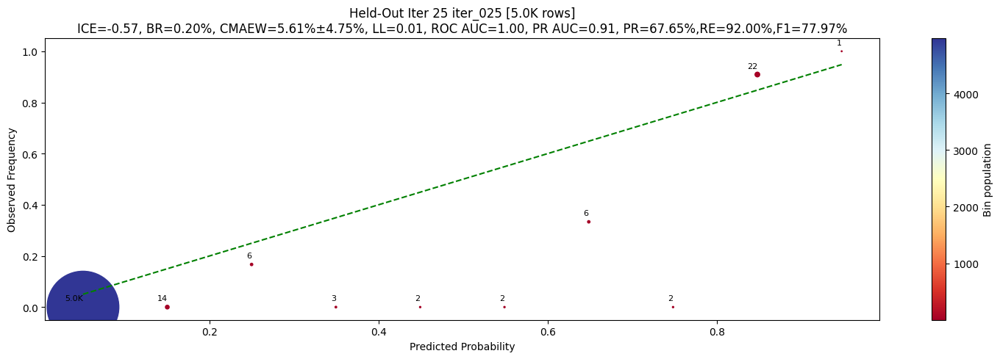

2025-12-22 18:34:41,702 - INFO - _compute_enrichment_factor-line:3024 - Computing enrichment (batched prediction)...
2025-12-22 18:34:58,398 - INFO - run-line:3186 - Training bootstrap models...


Bootstrap models:   0%|          | 0/5 [00:00<?, ?it/s]

Predicting models:   0%|          | 0/5 [00:00<?, ?it/s]

In [ ]:
# setup_logging(level=logging.INFO)

# Run pipeline
results = run_active_learning_pipeline(
    unlabeled_samples=big_features,
    known_flares=oos_features,
    output_dir=join(r"R:\Data\Astronomy", "active_learning_output"),
    unlabeled_dataset=dataset["target"],
    known_flares_dataset=dataset["test"],
)

In [25]:
# setup_logging(level=logging.INFO)

# Run pipeline
results = run_active_learning_pipeline(
    unlabeled_samples=big_features,
    known_flares=oos_features,
    output_dir=join(r"R:\Data\Astronomy", "active_learning_output"),
    unlabeled_dataset=dataset["target"],
    known_flares_dataset=dataset["test"],
    freaky_held_out_indices=freaky_held_out_indices,
    forced_positive_indices=[55554273] + surely_pos,  # tracked_pos+surely_pos
    forced_negative_indices=[83251304]
    + surely_neg
    + maybe_neg,  # tracked_neg+surely_neg+maybe_neg
    expert_labels_file=r"expert_labels.txt",
)

2025-12-28 18:23:36,317 - INFO - _load_expert_labels_file-line:5416 - Loading prior expert labels from expert_labels.txt
2025-12-28 18:23:36,349 - INFO - _load_expert_labels_file-line:5443 - Expert labels file: 39 lines, 1383 pos entries, 2521 neg entries (raw)
2025-12-28 18:23:36,354 - WARNING - _load_expert_labels_file-line:5457 - Found 45 duplicate positive entries in expert labels (deduplicated)
2025-12-28 18:23:36,359 - WARNING - _load_expert_labels_file-line:5459 - Found 47 duplicate negative entries in expert labels (deduplicated)
2025-12-28 18:23:36,363 - WARNING - _load_expert_labels_file-line:5482 - COLLISION: 23 samples labeled as BOTH positive AND negative. Resolved by mode: 0 → pos, 1 → neg. Skipped (even count, no majority): 22
2025-12-28 18:23:36,368 - WARNING - _load_expert_labels_file-line:5488 - Skipped IDs (even count): [5813815, 12331435, 16326767, 22653321, 24570995, 34965301, 36021881, 41422612, 48365089, 49236971]...
2025-12-28 18:23:36,370 - INFO - _load_expert_

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

2025-12-28 18:28:01,575 - INFO - initialize-line:3105 - ITERATION 0 COMPLETE
2025-12-28 18:28:01,583 - INFO - initialize-line:3106 -   Train: 44048 samples
2025-12-28 18:28:01,583 - INFO - initialize-line:3107 -   Validation: RE=0.870, PR=0.947, ROC-AUC=0.998, PR-AUC=0.965, ICE=-0.5375, LL=0.0261, Brier=0.0070
2025-12-28 18:28:04,283 - INFO - _get_unlabeled_features_for_prediction-line:2651 - Creating zero-copy view of unlabeled_samples for prediction... (RAM: 32.60 GB)
2025-12-28 18:28:23,101 - INFO - _get_unlabeled_features_for_prediction-line:2658 - Zero-copy view created: shape=(94028217, 96), RAM: 32.60 -> 67.43 GB (delta: +34.83 GB)


Predicting models: 0it [00:00, ?it/s]

2025-12-28 18:30:03,635 - INFO - _expert_label_samples-line:3960 - Expert mode: Excluding 100 samples from last expert session (within 10 iters)
2025-12-28 18:30:24,354 - INFO - _expert_label_samples-line:3982 - Expert mode: Selected 100 uncertain samples for labeling
2025-12-28 18:30:24,354 - INFO - _expert_label_samples-line:3984 -   22 samples have previous labels (may conflict)
2025-12-28 18:30:24,362 - INFO - _expert_label_samples-line:3990 -   idx=21017964, P(flare)=0.5000, uncertainty=0.0000
2025-12-28 18:30:24,362 - INFO - _expert_label_samples-line:3990 -   idx=31871140, P(flare)=0.5000, uncertainty=0.0000
2025-12-28 18:30:24,365 - INFO - _expert_label_samples-line:3990 -   idx=38069105, P(flare)=0.5000, uncertainty=0.0000
2025-12-28 18:30:24,369 - INFO - _expert_label_samples-line:3990 -   idx=12379534, P(flare)=0.5000, uncertainty=0.0000, prev_label=1, prev_source=forced_pos
2025-12-28 18:30:24,372 - INFO - _expert_label_samples-line:3990 -   idx=34841035, P(flare)=0.5002, u

KeyboardInterrupt: 

time: 10min 45s (started: 2025-12-28 18:23:36 +03:00)


# MLFRAME

In [20]:
labeled_df = build_labeled_dataset(
    unlabeled_samples=big_features,
    known_flares=oos_features,
    unlabeled_dataset=dataset["target"],
    known_flares_dataset=dataset["test"],
    freaky_held_out_indices=freaky_held_out_indices,
    forced_positive_indices=[55554273] + surely_pos,  # tracked_pos+surely_pos
    forced_negative_indices=[83251304]
    + surely_neg
    + maybe_neg,  # tracked_neg+surely_neg+maybe_neg
    expert_labels_file=r"expert_labels.txt",
)

labeled_df

2026-01-01 13:31:30,684 - INFO - build_labeled_dataset-line:73 - Added 99 known flares (positive)
2026-01-01 13:31:30,684 - INFO - build_labeled_dataset-line:82 - Added 8 freaky held-out indices (positive)
2026-01-01 13:31:30,694 - INFO - build_labeled_dataset-line:87 - Added 2215 forced positive indices
2026-01-01 13:31:30,700 - INFO - build_labeled_dataset-line:92 - Added 3173 forced negative indices
2026-01-01 13:31:30,705 - INFO - _load_expert_labels_file-line:5416 - Loading prior expert labels from expert_labels.txt
2026-01-01 13:31:30,921 - INFO - _load_expert_labels_file-line:5443 - Expert labels file: 40 lines, 1383 pos entries, 2521 neg entries (raw)
2026-01-01 13:31:30,927 - WARNING - _load_expert_labels_file-line:5457 - Found 45 duplicate positive entries in expert labels (deduplicated)
2026-01-01 13:31:30,931 - WARNING - _load_expert_labels_file-line:5459 - Found 47 duplicate negative entries in expert labels (deduplicated)
2026-01-01 13:31:30,936 - WARNING - _load_expert_l

_orig_idx,id,class,npoints,mag_mean,mag_std,mag_min,mag_max,mag_median,mag_q25,mag_q75,mag_skewness,mag_kurtosis,mag_entropy,mag_first,mag_last,mag_arg_min,mag_arg_max,mag_n_unique,mag_trend_changes,magerr_mean,magerr_std,magerr_min,magerr_max,magerr_median,magerr_q25,magerr_q75,magerr_skewness,magerr_kurtosis,magerr_entropy,magerr_first,magerr_last,magerr_arg_min,magerr_arg_max,magerr_n_unique,magerr_trend_changes,norm_mean,…,mjd_diff_n_unique,mjd_diff_trend_changes,ts,norm_n_below_3sigma,norm_max_consecutive_below_2sigma,norm_rise_decay_idx_ratio,norm_n_local_minima,norm_n_zero_crossings,norm_rise_decay_time_ratio,mjd_span,norm_frac_below_3sigma,norm_max_consecutive_frac_below_2sigma,norm_frac_local_minima,norm_frac_zero_crossings,wv_haar_total_energy,wv_haar_detail_ratio,wv_haar_max_detail,wv_haar_d1_energy,wv_haar_d2_energy,wv_haar_d3_energy,wv_haar_d4_energy,wv_db4_total_energy,wv_db4_detail_ratio,wv_db4_max_detail,wv_db4_d1_energy,wv_db4_d2_energy,wv_db4_d3_energy,wv_db4_d4_energy,wv_sym4_total_energy,wv_sym4_detail_ratio,wv_sym4_max_detail,wv_sym4_d1_energy,wv_sym4_d2_energy,wv_sym4_d3_energy,wv_sym4_d4_energy,source,_dataset
u32,str,i32,u32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,u32,u32,u32,u32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,u32,u32,u32,u32,f32,…,u32,u32,"datetime[μs, UTC]",i32,i32,f32,i32,i32,f32,f32,f64,f64,f64,f64,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,str,i32
0,"""ZTFDR257209100009778""",1,81,18.277956,0.750536,17.015057,20.387354,18.423584,17.687233,18.766064,0.2315,0.250924,4.393619,20.387354,18.864996,21,0,81,26,0.048074,0.031054,0.017062,0.183053,0.045382,0.026185,0.059344,2.5264,8.290339,4.231629,0.183053,0.064138,21,0,81,26,-3.208962,…,3,28,2018-12-19 00:00:00 UTC,36,37,0.366667,13,2,1.660651,0.07169,0.444444,0.45679,0.160494,0.024691,24134.207031,0.35495,72.740486,5913.046387,2050.105713,322.357452,280.921997,63624.984375,0.03833,40.51878,2189.249268,168.37117,81.117088,0.0,57202.554688,0.014593,11.759074,462.936951,246.223663,125.621567,0.0,"""known_flare""",1
1,"""ZTFDR260208100017563""",1,80,19.993542,0.696953,17.942547,20.743458,20.307732,19.590908,20.544415,-1.082484,0.312565,4.381419,20.544455,19.909906,49,38,80,47,0.167013,0.05541,0.03964,0.230914,0.19325,0.125968,0.212915,-0.744423,-0.753964,4.319683,0.212918,0.155199,49,38,80,47,-1.625814,…,3,41,2019-01-10 00:00:00 UTC,24,30,1.612903,24,11,3.998388,0.070811,0.3,0.375,0.3,0.1375,1238.986206,0.135499,7.2558,61.678265,44.895584,18.425713,42.881363,1306.994873,0.166069,10.756878,147.583221,45.375313,24.09292,0.0,1423.175659,0.073924,6.943209,21.925751,62.967041,20.314232,0.0,"""known_flare""",1
2,"""ZTFDR280214400089687""",1,96,20.389763,0.501157,18.74905,21.139164,20.576591,20.130533,20.747143,-1.102585,0.645175,4.564046,20.861336,20.375034,58,5,96,65,0.155814,0.036119,0.05539,0.211005,0.16967,0.13486,0.182202,-0.915431,-0.110681,4.534921,0.190592,0.154399,58,5,96,65,-1.101141,…,2,45,2018-07-04 00:00:00 UTC,21,25,1.552632,33,17,2.35714,0.059836,0.21875,0.260417,0.34375,0.177083,945.216797,0.401415,15.002,240.828491,6.223735,68.68119,63.690628,992.884766,0.182333,8.429711,98.668434,43.582954,38.784275,0.0,1017.546997,0.118066,5.845948,43.955574,35.885162,40.296463,0.0,"""known_flare""",1
3,"""ZTFDR281201100016537""",1,83,19.894436,0.774005,18.632027,21.014927,19.637901,19.265348,20.693279,-0.011298,-1.517447,4.418092,20.624474,19.675564,47,24,83,48,0.120904,0.050061,0.050351,0.195758,0.099438,0.077366,0.173587,0.122181,-1.639616,4.332079,0.168845,0.101924,47,24,83,48,2.579839,…,2,42,2019-06-02 00:00:00 UTC,24,25,1.333333,24,6,2.811501,0.063659,0.289157,0.301205,0.289157,0.072289,5521.078125,0.185223,25.353157,678.985657,230.908875,39.615719,73.120369,9911.904297,0.014606,4.400582,55.54995,35.753201,53.472855,0.0,7427.095703,0.015847,3.491476,18.665026,26.559851,72.472916,0.0,"""known_flare""",1
4,"""ZTFDR283211100006940""",1,23,19.219332,0.60785,17.624674,19.872463,19.485464,19.00582

time: 8.45 s (started: 2026-01-01 13:31:30 +03:00)


In [21]:
labeled_df["id"].n_unique()

9036

time: 63 ms (started: 2026-01-01 13:31:40 +03:00)


In [22]:
# labeled_df = labeled_df.drop(["id", "ts", "source"])

time: 16 ms (started: 2026-01-01 13:31:42 +03:00)


In [23]:
labeled_df = labeled_df.drop(
    [
        "id",
    ]
)

time: 62 ms (started: 2026-01-01 13:31:44 +03:00)


In [24]:
from sklearn.model_selection import train_test_split

labeled_df_train, labeled_df_test = train_test_split(
    labeled_df, test_size=0.1, shuffle=True,random_state=42
)

time: 47 ms (started: 2026-01-01 13:31:46 +03:00)


In [25]:
labeled_df_test

_orig_idx,class,npoints,mag_mean,mag_std,mag_min,mag_max,mag_median,mag_q25,mag_q75,mag_skewness,mag_kurtosis,mag_entropy,mag_first,mag_last,mag_arg_min,mag_arg_max,mag_n_unique,mag_trend_changes,magerr_mean,magerr_std,magerr_min,magerr_max,magerr_median,magerr_q25,magerr_q75,magerr_skewness,magerr_kurtosis,magerr_entropy,magerr_first,magerr_last,magerr_arg_min,magerr_arg_max,magerr_n_unique,magerr_trend_changes,norm_mean,norm_std,…,mjd_diff_n_unique,mjd_diff_trend_changes,ts,norm_n_below_3sigma,norm_max_consecutive_below_2sigma,norm_rise_decay_idx_ratio,norm_n_local_minima,norm_n_zero_crossings,norm_rise_decay_time_ratio,mjd_span,norm_frac_below_3sigma,norm_max_consecutive_frac_below_2sigma,norm_frac_local_minima,norm_frac_zero_crossings,wv_haar_total_energy,wv_haar_detail_ratio,wv_haar_max_detail,wv_haar_d1_energy,wv_haar_d2_energy,wv_haar_d3_energy,wv_haar_d4_energy,wv_db4_total_energy,wv_db4_detail_ratio,wv_db4_max_detail,wv_db4_d1_energy,wv_db4_d2_energy,wv_db4_d3_energy,wv_db4_d4_energy,wv_sym4_total_energy,wv_sym4_detail_ratio,wv_sym4_max_detail,wv_sym4_d1_energy,wv_sym4_d2_energy,wv_sym4_d3_energy,wv_sym4_d4_energy,source,_dataset
u32,i32,u32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,u32,u32,u32,u32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,u32,u32,u32,u32,f32,f32,…,u32,u32,"datetime[μs, UTC]",i32,i32,f32,i32,i32,f32,f32,f64,f64,f64,f64,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,f32,str,i32
77341422,0,128,18.247055,0.379472,17.100582,18.601383,18.391697,18.249023,18.46257,-1.889415,2.334394,4.851813,18.449093,18.583235,87,64,128,74,0.032251,0.006502,0.015406,0.040468,0.034483,0.031026,0.036378,-1.433971,1.021769,4.829166,0.036008,0.039903,87,64,128,74,-4.194668,11.004638,…,2,47,2018-07-26 00:00:00 UTC,36,24,2.146342,37,38,2.145616,0.06027,0.28125,0.1875,0.2890625,0.296875,17632.121094,0.374408,42.048435,3260.248291,1886.016724,933.419067,521.927124,19625.814453,0.167009,27.735025,1436.126221,961.341736,457.251221,422.958527,18329.814453,0.304628,46.24826,3878.017578,862.201904,417.405396,426.147156,"""unlabeled_neg""",0
7862232,0,86,20.251574,0.455012,19.210388,20.891125,20.41803,20.24369,20.523798,-1.371643,0.492523,4.454095,20.588402,20.704327,10,73,86,55,0.137281,0.031142,0.06857,0.182596,0.148593,0.135088,0.15646,-1.297551,0.332539,4.42544,0.161056,0.169305,10,73,86,55,-1.120246,3.062133,…,2,44,2018-07-12 00:00:00 UTC,15,15,0.144737,28,30,0.190761,0.0598,0.174419,0.174419,0.325581,0.348837,918.828674,0.53561,12.472139,240.241913,108.833427,84.70858,58.349682,948.135193,0.154135,4.335433,44.31562,47.819271,54.005978,0.0,977.518494,0.194258,6.048196,82.787476,48.939922,58.163216,0.0,"""unlabeled_neg""",0
46034027,0,89,16.9793,0.152264,16.31057,17.123175,17.045391,16.935818,17.075924,-1.941179,3.902993,4.488596,17.055836,16.983585,81,34,89,47,0.017232,0.000818,0.01416,0.018104,0.017585,0.016915,0.017784,-1.562816,1.871078,4.487493,0.017653,0.017199,81,34,89,47,-3.758401,8.658676,…,2,64,2018-12-31 00:00:00 UTC,29,19,10.25,23,17,10.330498,0.09325,0.325843,0.213483,0.258427,0.191011,7941.240723,0.450331,26.070114,513.353088,1037.373779,1115.745728,909.714539,8339.328125,0.30988,21.870943,680.825073,795.11084,1108.252808,0.0,8137.029297,0.321288,20.753857,834.421997,699.414185,1080.49353,0.0,"""unlabeled_neg""",0
459594,1,51,19.50218,0.519932,18.553062,20.46566,19.539976,19.121655,19.899059,-0.166086,-0.934195,3.931477,20.382442,20.164198,9,2,51,27,0.12822,0.04403,0.060998,0.22174,0.125474,0.092525,0.160651,0.233875,-0.896857,3.873257,0.213249,0.189513,9,2,51,27,-0.301221,4.143749,…,4,25,2018-12-24 00:00:00 UTC,15,13,0.238095,14,4,0.886527,0.06035,0.294118,0.254902,0.27451,0.078431,1156.620605,0.476769,16.42119,211.231277,290.864838,18.298582,31.045759,1351.594604,0.048646,3.324187,22.163654,43.585751,0.0,0.0,1449.947266,0.072632,6.305135,71.966278,33.34679,0.0,0.0,"""unlabeled_pos""",0
12507460,1,78,19.05617,0.442773,17.424618,19.581097,19.161001,18.935734,19.375528,-1.818

time: 93 ms (started: 2026-01-01 13:31:48 +03:00)


In [26]:
ds_map = {0: dataset["target"], 1: dataset["test"]}
seq_cols = ("mjd", "mag", "magerr")

new_sequences = [
    _extract_sequence_from_hf_dataset(
        ds_map[row["_dataset"]], row["_orig_idx"], seq_cols
    )
    for row in labeled_df_test.iter_rows(named=True)
]

targets = labeled_df_test["class"].to_numpy().astype(np.int8)

time: 4.53 s (started: 2026-01-01 13:31:50 +03:00)


In [ ]:
targets = labeled_df_test["class"].to_numpy().astype(np.int8)

new_features, _, new_sequences = prepare_recurrent_training_data(
    labeled_df_test,
    unlabeled_dataset=dataset["target"],
    known_flares_dataset=dataset["test"],
    sequence_cols=("mjd", "mag", "magerr"),
    derived_cols=("norm", "vel"),
)

In [62]:
params = dict(
    labeled_df=labeled_df_train,
    unlabeled_dataset=dataset["target"],
    known_flares_dataset=dataset["test"],
    sequence_cols=("mjd", "mag", "magerr"),
    derived_cols=("norm", "vel"),
    # Bigger network
    hidden_size=256,  # default 128 - RNN hidden size
    num_layers=3,  # default 2 - RNN layers
    mlp_hidden_sizes=(512, 256, 128),  # default (256, 128) - MLP head
    # Training params
    learning_rate=1e-3,  # default 1e-3
    batch_size=128,  # default 256 - smaller batches can help
    max_epochs=2,  # default 100
    dropout=0.4,  # default 0.3
    #
    n_heads=4 * 2,
    dim_feedforward=256 * 2,
)

time: 0 ns (started: 2026-01-01 15:28:20 +03:00)


In [63]:
models = {}
metrics = {}
training_times = {}
predicting_times = {}

from timeit import default_timer as timer


def eval_models():
    for input_mode in InputMode:
        for rnn_type in RNNType:
            key = f"{input_mode}_{rnn_type}"
            if key not in models:
                dur = timer()
                model = train_recurrent_classifier(
                    input_mode=input_mode, rnn_type=rnn_type, **params
                )
                dur = timer() - dur
                training_times[key] = dur
                models[key] = model

            dur = timer()
            probs = model.predict_proba(features=new_features, sequences=new_sequences)
            dur = timer() - dur
            predicting_times[key] = dur

            metrics[key] = {}

            _, _ = report_model_perf(
                targets=targets,
                columns=None,
                df=None,
                model_name=key,
                model=None,
                target_label_encoder=None,
                preds=None,
                probs=probs,
                plot_file=join(charts_dir, key) if charts_dir else None,
                metrics=metrics[key],
                group_ids=None,
                **report_params,
            )

time: 0 ns (started: 2026-01-01 15:28:21 +03:00)


In [64]:
eval_models()

2026-01-01 15:28:23,124 - INFO - prepare_recurrent_training_data-line:283 - Prepared features: (8132, 97), labels: (8132,)
2026-01-01 15:28:30,586 - INFO - prepare_recurrent_training_data-line:307 - Extracted 8132 sequences
2026-01-01 15:28:30,635 - INFO - seed_everything-line:54 - Seed set to 42
2026-01-01 15:28:35,864 - INFO - _info-line:64 - GPU available: True (cuda), used: True
2026-01-01 15:28:35,864 - INFO - _info-line:64 - TPU available: False, using: 0 TPU cores
2026-01-01 15:28:35,873 - INFO - _info-line:64 - HPU available: False, using: 0 HPUs
R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\callbacks\model_checkpoint.py:652: Checkpoint directory S:\recovered13\Programming\MyCurrentProjects\Astronomy\astronomy\checkpoints exists and is not empty.
2026-01-01 15:28:35,883 - INFO - set_nvidia_flags-line:61 - LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
2026-01-01 15:28:36,152 - INFO - _info-line:64 - Loading `train_dataloader` to estimate number of stepping batches.
R:

Sanity Checking: |                                                                               | 0/? [00:00<…

R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:424: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=31` in the `DataLoader` to improve performance.


KeyError: 0

time: 19.1 s (started: 2026-01-01 15:28:23 +03:00)


2025-12-31 16:27:28,828 - INFO - prepare_recurrent_training_data-line:237 - Prepared features: (8132, 97), labels: (8132,)
2025-12-31 16:27:33,769 - INFO - prepare_recurrent_training_data-line:260 - Extracted 8132 sequences
2025-12-31 16:27:33,789 - INFO - seed_everything-line:54 - Seed set to 42
2025-12-31 16:27:37,125 - INFO - _info-line:64 - GPU available: True (cuda), used: True
2025-12-31 16:27:37,129 - INFO - _info-line:64 - TPU available: False, using: 0 TPU cores
2025-12-31 16:27:37,133 - INFO - _info-line:64 - HPU available: False, using: 0 HPUs
R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\callbacks\model_checkpoint.py:652: Checkpoint directory S:\recovered13\Programming\MyCurrentProjects\Astronomy\astronomy\checkpoints exists and is not empty.
2025-12-31 16:27:37,147 - INFO - set_nvidia_flags-line:61 - LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
2025-12-31 16:27:37,248 - INFO - _info-line:64 - Loading `train_dataloader` to estimate number of stepping batches.
R:

Sanity Checking: |                                                                               | 0/? [00:00<…

R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:424: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=31` in the `DataLoader` to improve performance.
R:\ProgramData\anaconda3\Lib\site-packages\torch\nn\modules\linear.py:116: UserWarning:

Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ..\aten\src\ATen\Context.cpp:185.)

S:\recovered13\Programmin

Training: |                                                                                      | 0/? [00:00<…

R:\ProgramData\anaconda3\Lib\site-packages\torch\autograd\graph.py:744: UserWarning:

Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ..\aten\src\ATen\Context.cpp:185.)



Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

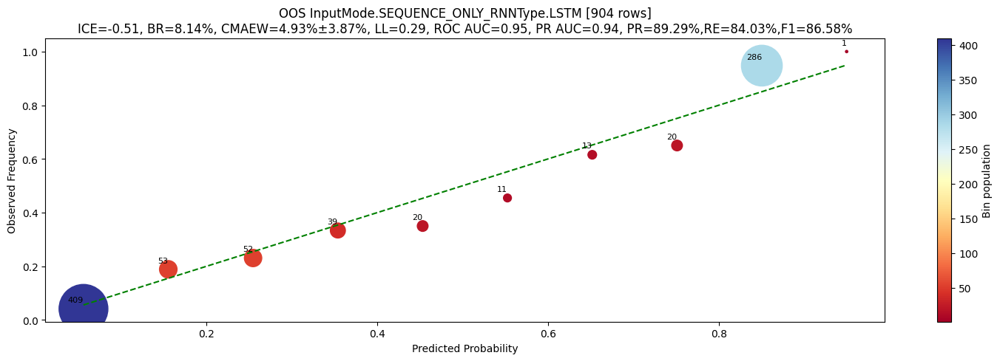

2025-12-31 16:52:48,203 - INFO - prepare_recurrent_training_data-line:237 - Prepared features: (8132, 97), labels: (8132,)


OOS InputMode.SEQUENCE_ONLY_RNNType.LSTM
              precision    recall  f1-score   support

           0       0.90      0.93      0.92       547
           1       0.89      0.84      0.87       357

    accuracy                           0.90       904
   macro avg       0.90      0.89      0.89       904
weighted avg       0.90      0.90      0.90       904

ROC AUCs: 1=0.95
PR AUCs: 1=0.94
CALIBRATIONs: 
	1: MAEW=4.93%, STD=3.87%, COV=90%
BRIER LOSSes: 
	1=8.14%
LOG_LOSSes: 
	1=0.29
ICEs: 
	1=-0.51
TOTAL INTEGRAL ERROR: 0.0000


2025-12-31 16:52:54,318 - INFO - prepare_recurrent_training_data-line:260 - Extracted 8132 sequences
2025-12-31 16:52:54,353 - INFO - seed_everything-line:54 - Seed set to 42
2025-12-31 16:52:57,583 - INFO - _info-line:64 - GPU available: True (cuda), used: True
2025-12-31 16:52:57,587 - INFO - _info-line:64 - TPU available: False, using: 0 TPU cores
2025-12-31 16:52:57,592 - INFO - _info-line:64 - HPU available: False, using: 0 HPUs
R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\callbacks\model_checkpoint.py:652: Checkpoint directory S:\recovered13\Programming\MyCurrentProjects\Astronomy\astronomy\checkpoints exists and is not empty.
2025-12-31 16:52:57,600 - INFO - set_nvidia_flags-line:61 - LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
2025-12-31 16:52:57,704 - INFO - _info-line:64 - Loading `train_dataloader` to estimate number of stepping batches.
R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:424: The 'train_dataloader'

Sanity Checking: |                                                                               | 0/? [00:00<…

R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:424: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=31` in the `DataLoader` to improve performance.
R:\ProgramData\anaconda3\Lib\site-packages\torch\nn\modules\linear.py:116: UserWarning:

Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ..\aten\src\ATen\Context.cpp:185.)

S:\recovered13\Programmin

Training: |                                                                                      | 0/? [00:00<…

R:\ProgramData\anaconda3\Lib\site-packages\torch\autograd\graph.py:744: UserWarning:

Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ..\aten\src\ATen\Context.cpp:185.)



Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

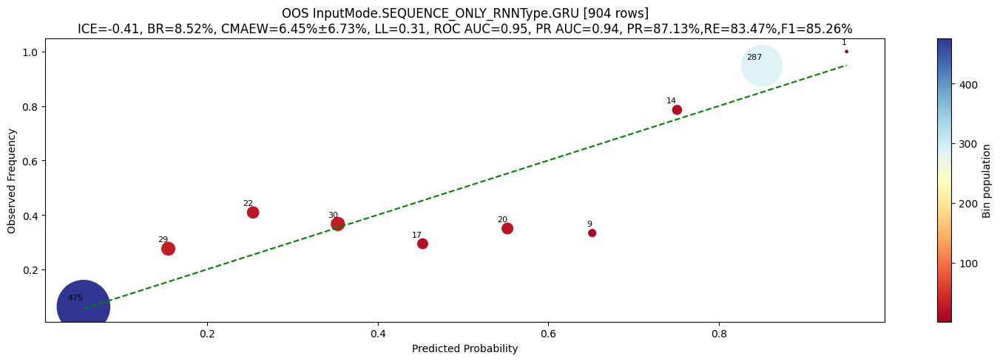

2025-12-31 17:22:30,722 - INFO - prepare_recurrent_training_data-line:237 - Prepared features: (8132, 97), labels: (8132,)


OOS InputMode.SEQUENCE_ONLY_RNNType.GRU
              precision    recall  f1-score   support

           0       0.90      0.92      0.91       547
           1       0.87      0.83      0.85       357

    accuracy                           0.89       904
   macro avg       0.88      0.88      0.88       904
weighted avg       0.89      0.89      0.89       904

ROC AUCs: 1=0.95
PR AUCs: 1=0.94
CALIBRATIONs: 
	1: MAEW=6.45%, STD=6.73%, COV=90%
BRIER LOSSes: 
	1=8.52%
LOG_LOSSes: 
	1=0.31
ICEs: 
	1=-0.41
TOTAL INTEGRAL ERROR: 0.0000


2025-12-31 17:22:37,003 - INFO - prepare_recurrent_training_data-line:260 - Extracted 8132 sequences
2025-12-31 17:22:37,036 - INFO - seed_everything-line:54 - Seed set to 42
2025-12-31 17:22:40,189 - INFO - _info-line:64 - GPU available: True (cuda), used: True
2025-12-31 17:22:40,193 - INFO - _info-line:64 - TPU available: False, using: 0 TPU cores
2025-12-31 17:22:40,196 - INFO - _info-line:64 - HPU available: False, using: 0 HPUs
R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\callbacks\model_checkpoint.py:652: Checkpoint directory S:\recovered13\Programming\MyCurrentProjects\Astronomy\astronomy\checkpoints exists and is not empty.
2025-12-31 17:22:40,206 - INFO - set_nvidia_flags-line:61 - LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
2025-12-31 17:22:40,287 - INFO - _info-line:64 - Loading `train_dataloader` to estimate number of stepping batches.
R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:424: The 'train_dataloader'

Sanity Checking: |                                                                               | 0/? [00:00<…

R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:424: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=31` in the `DataLoader` to improve performance.
R:\ProgramData\anaconda3\Lib\site-packages\torch\nn\modules\linear.py:116: UserWarning:

Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ..\aten\src\ATen\Context.cpp:185.)

S:\recovered13\Programmin

Training: |                                                                                      | 0/? [00:00<…

R:\ProgramData\anaconda3\Lib\site-packages\torch\autograd\graph.py:744: UserWarning:

Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ..\aten\src\ATen\Context.cpp:185.)



Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

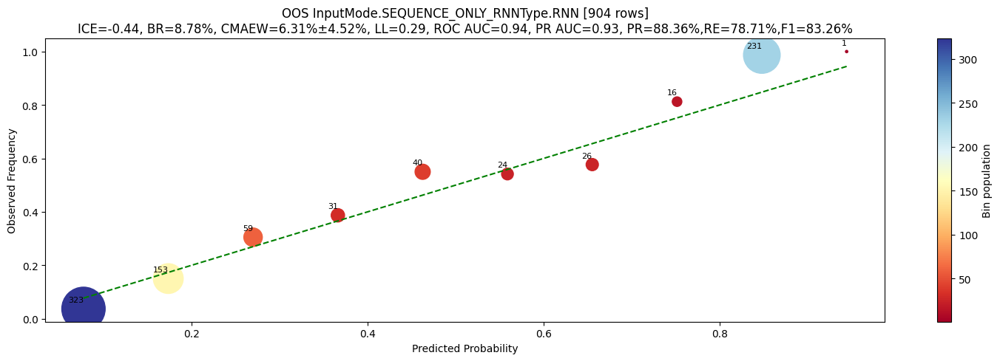

2025-12-31 17:33:41,470 - INFO - prepare_recurrent_training_data-line:237 - Prepared features: (8132, 97), labels: (8132,)


OOS InputMode.SEQUENCE_ONLY_RNNType.RNN
              precision    recall  f1-score   support

           0       0.87      0.93      0.90       547
           1       0.88      0.79      0.83       357

    accuracy                           0.88       904
   macro avg       0.88      0.86      0.87       904
weighted avg       0.88      0.88      0.87       904

ROC AUCs: 1=0.94
PR AUCs: 1=0.93
CALIBRATIONs: 
	1: MAEW=6.31%, STD=4.52%, COV=90%
BRIER LOSSes: 
	1=8.78%
LOG_LOSSes: 
	1=0.29
ICEs: 
	1=-0.44
TOTAL INTEGRAL ERROR: 0.0000


2025-12-31 17:33:46,756 - INFO - prepare_recurrent_training_data-line:260 - Extracted 8132 sequences
2025-12-31 17:33:46,789 - INFO - seed_everything-line:54 - Seed set to 42
2025-12-31 17:33:49,922 - INFO - _info-line:64 - GPU available: True (cuda), used: True
2025-12-31 17:33:49,924 - INFO - _info-line:64 - TPU available: False, using: 0 TPU cores
2025-12-31 17:33:49,927 - INFO - _info-line:64 - HPU available: False, using: 0 HPUs
R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\callbacks\model_checkpoint.py:652: Checkpoint directory S:\recovered13\Programming\MyCurrentProjects\Astronomy\astronomy\checkpoints exists and is not empty.
2025-12-31 17:33:49,932 - INFO - set_nvidia_flags-line:61 - LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
2025-12-31 17:33:50,022 - INFO - _info-line:64 - Loading `train_dataloader` to estimate number of stepping batches.
R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:424: The 'train_dataloader'

Sanity Checking: |                                                                               | 0/? [00:00<…

R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:424: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=31` in the `DataLoader` to improve performance.
R:\ProgramData\anaconda3\Lib\site-packages\torch\nn\modules\linear.py:116: UserWarning:

Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ..\aten\src\ATen\Context.cpp:185.)

R:\ProgramData\anaconda3\

Training: |                                                                                      | 0/? [00:00<…

R:\ProgramData\anaconda3\Lib\site-packages\torch\nn\functional.py:4884: UserWarning:

Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ..\aten\src\ATen\Context.cpp:185.)

R:\ProgramData\anaconda3\Lib\site-packages\torch\nn\functional.py:5507: UserWarning:

Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable det

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

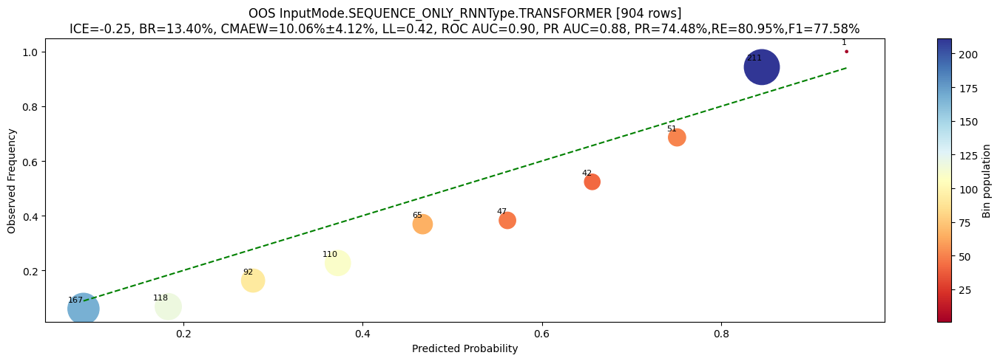

2025-12-31 17:44:22,733 - INFO - prepare_recurrent_training_data-line:237 - Prepared features: (8132, 97), labels: (8132,)
2025-12-31 17:44:22,754 - INFO - seed_everything-line:54 - Seed set to 42


OOS InputMode.SEQUENCE_ONLY_RNNType.TRANSFORMER
              precision    recall  f1-score   support

           0       0.87      0.82      0.84       547
           1       0.74      0.81      0.78       357

    accuracy                           0.82       904
   macro avg       0.81      0.81      0.81       904
weighted avg       0.82      0.82      0.82       904

ROC AUCs: 1=0.90
PR AUCs: 1=0.88
CALIBRATIONs: 
	1: MAEW=10.06%, STD=4.12%, COV=90%
BRIER LOSSes: 
	1=13.40%
LOG_LOSSes: 
	1=0.42
ICEs: 
	1=-0.25
TOTAL INTEGRAL ERROR: 0.0000


2025-12-31 17:44:23,306 - INFO - _info-line:64 - GPU available: True (cuda), used: True
2025-12-31 17:44:23,310 - INFO - _info-line:64 - TPU available: False, using: 0 TPU cores
2025-12-31 17:44:23,314 - INFO - _info-line:64 - HPU available: False, using: 0 HPUs
R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\callbacks\model_checkpoint.py:652: Checkpoint directory S:\recovered13\Programming\MyCurrentProjects\Astronomy\astronomy\checkpoints exists and is not empty.
2025-12-31 17:44:23,324 - INFO - set_nvidia_flags-line:61 - LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
2025-12-31 17:44:23,374 - INFO - _info-line:64 - Loading `train_dataloader` to estimate number of stepping batches.
R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:424: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=31` in the `DataLoader` to improve performa

Sanity Checking: |                                                                               | 0/? [00:00<…

R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:424: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=31` in the `DataLoader` to improve performance.
R:\ProgramData\anaconda3\Lib\site-packages\torch\nn\modules\linear.py:116: UserWarning:

Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ..\aten\src\ATen\Context.cpp:185.)

R:\ProgramData\anaconda3\

Training: |                                                                                      | 0/? [00:00<…

R:\ProgramData\anaconda3\Lib\site-packages\torch\autograd\graph.py:744: UserWarning:

Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ..\aten\src\ATen\Context.cpp:185.)



Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

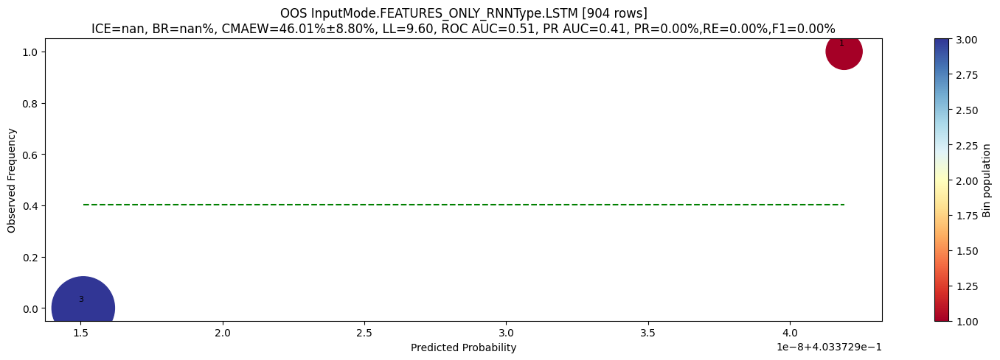

2025-12-31 17:45:41,033 - INFO - prepare_recurrent_training_data-line:237 - Prepared features: (8132, 97), labels: (8132,)
2025-12-31 17:45:41,059 - INFO - seed_everything-line:54 - Seed set to 42


OOS InputMode.FEATURES_ONLY_RNNType.LSTM
              precision    recall  f1-score   support

           0       0.61      1.00      0.75       547
           1       0.00      0.00      0.00       357

    accuracy                           0.61       904
   macro avg       0.30      0.50      0.38       904
weighted avg       0.37      0.61      0.46       904

ROC AUCs: 1=0.51
PR AUCs: 1=0.41
CALIBRATIONs: 
	1: MAEW=46.01%, STD=8.80%, COV=10%
BRIER LOSSes: 
	1=nan%
LOG_LOSSes: 
	1=9.60
ICEs: 
	1=nan
TOTAL INTEGRAL ERROR: 0.0000


2025-12-31 17:45:41,637 - INFO - _info-line:64 - GPU available: True (cuda), used: True
2025-12-31 17:45:41,641 - INFO - _info-line:64 - TPU available: False, using: 0 TPU cores
2025-12-31 17:45:41,645 - INFO - _info-line:64 - HPU available: False, using: 0 HPUs
R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\callbacks\model_checkpoint.py:652: Checkpoint directory S:\recovered13\Programming\MyCurrentProjects\Astronomy\astronomy\checkpoints exists and is not empty.
2025-12-31 17:45:41,657 - INFO - set_nvidia_flags-line:61 - LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
2025-12-31 17:45:41,693 - INFO - _info-line:64 - Loading `train_dataloader` to estimate number of stepping batches.
R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:424: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=31` in the `DataLoader` to improve performa

Sanity Checking: |                                                                               | 0/? [00:00<…

R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:424: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=31` in the `DataLoader` to improve performance.
R:\ProgramData\anaconda3\Lib\site-packages\torch\nn\modules\linear.py:116: UserWarning:

Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ..\aten\src\ATen\Context.cpp:185.)

R:\ProgramData\anaconda3\

Training: |                                                                                      | 0/? [00:00<…

R:\ProgramData\anaconda3\Lib\site-packages\torch\autograd\graph.py:744: UserWarning:

Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ..\aten\src\ATen\Context.cpp:185.)



Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

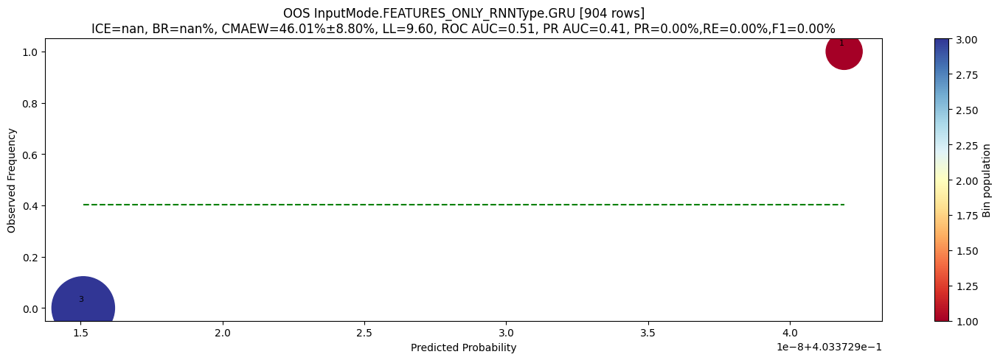

2025-12-31 17:46:58,609 - INFO - prepare_recurrent_training_data-line:237 - Prepared features: (8132, 97), labels: (8132,)
2025-12-31 17:46:58,625 - INFO - seed_everything-line:54 - Seed set to 42


OOS InputMode.FEATURES_ONLY_RNNType.GRU
              precision    recall  f1-score   support

           0       0.61      1.00      0.75       547
           1       0.00      0.00      0.00       357

    accuracy                           0.61       904
   macro avg       0.30      0.50      0.38       904
weighted avg       0.37      0.61      0.46       904

ROC AUCs: 1=0.51
PR AUCs: 1=0.41
CALIBRATIONs: 
	1: MAEW=46.01%, STD=8.80%, COV=10%
BRIER LOSSes: 
	1=nan%
LOG_LOSSes: 
	1=9.60
ICEs: 
	1=nan
TOTAL INTEGRAL ERROR: 0.0000


2025-12-31 17:46:59,120 - INFO - _info-line:64 - GPU available: True (cuda), used: True
2025-12-31 17:46:59,124 - INFO - _info-line:64 - TPU available: False, using: 0 TPU cores
2025-12-31 17:46:59,128 - INFO - _info-line:64 - HPU available: False, using: 0 HPUs
R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\callbacks\model_checkpoint.py:652: Checkpoint directory S:\recovered13\Programming\MyCurrentProjects\Astronomy\astronomy\checkpoints exists and is not empty.
2025-12-31 17:46:59,139 - INFO - set_nvidia_flags-line:61 - LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
2025-12-31 17:46:59,175 - INFO - _info-line:64 - Loading `train_dataloader` to estimate number of stepping batches.
R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:424: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=31` in the `DataLoader` to improve performa

Sanity Checking: |                                                                               | 0/? [00:00<…

R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:424: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=31` in the `DataLoader` to improve performance.
R:\ProgramData\anaconda3\Lib\site-packages\torch\nn\modules\linear.py:116: UserWarning:

Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ..\aten\src\ATen\Context.cpp:185.)

R:\ProgramData\anaconda3\

Training: |                                                                                      | 0/? [00:00<…

R:\ProgramData\anaconda3\Lib\site-packages\torch\autograd\graph.py:744: UserWarning:

Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ..\aten\src\ATen\Context.cpp:185.)



Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

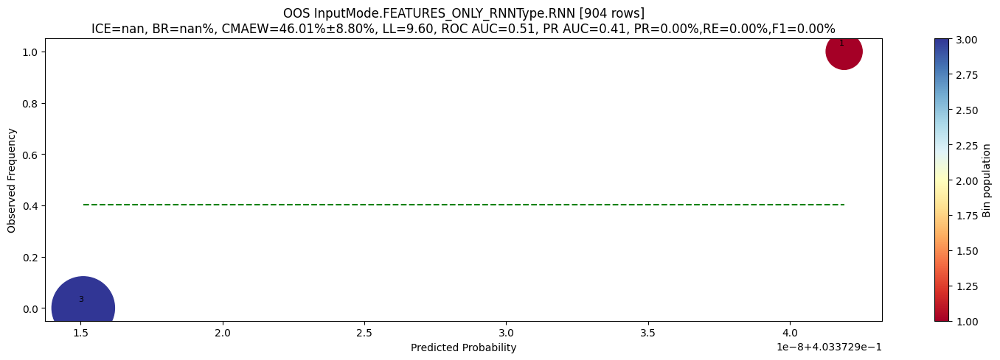

2025-12-31 17:48:15,787 - INFO - prepare_recurrent_training_data-line:237 - Prepared features: (8132, 97), labels: (8132,)
2025-12-31 17:48:15,810 - INFO - seed_everything-line:54 - Seed set to 42


OOS InputMode.FEATURES_ONLY_RNNType.RNN
              precision    recall  f1-score   support

           0       0.61      1.00      0.75       547
           1       0.00      0.00      0.00       357

    accuracy                           0.61       904
   macro avg       0.30      0.50      0.38       904
weighted avg       0.37      0.61      0.46       904

ROC AUCs: 1=0.51
PR AUCs: 1=0.41
CALIBRATIONs: 
	1: MAEW=46.01%, STD=8.80%, COV=10%
BRIER LOSSes: 
	1=nan%
LOG_LOSSes: 
	1=9.60
ICEs: 
	1=nan
TOTAL INTEGRAL ERROR: 0.0000


2025-12-31 17:48:16,303 - INFO - _info-line:64 - GPU available: True (cuda), used: True
2025-12-31 17:48:16,307 - INFO - _info-line:64 - TPU available: False, using: 0 TPU cores
2025-12-31 17:48:16,311 - INFO - _info-line:64 - HPU available: False, using: 0 HPUs
R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\callbacks\model_checkpoint.py:652: Checkpoint directory S:\recovered13\Programming\MyCurrentProjects\Astronomy\astronomy\checkpoints exists and is not empty.
2025-12-31 17:48:16,321 - INFO - set_nvidia_flags-line:61 - LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
2025-12-31 17:48:16,353 - INFO - _info-line:64 - Loading `train_dataloader` to estimate number of stepping batches.
R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:424: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=31` in the `DataLoader` to improve performa

Sanity Checking: |                                                                               | 0/? [00:00<…

R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:424: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=31` in the `DataLoader` to improve performance.
R:\ProgramData\anaconda3\Lib\site-packages\torch\nn\modules\linear.py:116: UserWarning:

Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ..\aten\src\ATen\Context.cpp:185.)

R:\ProgramData\anaconda3\

Training: |                                                                                      | 0/? [00:00<…

R:\ProgramData\anaconda3\Lib\site-packages\torch\autograd\graph.py:744: UserWarning:

Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ..\aten\src\ATen\Context.cpp:185.)



Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

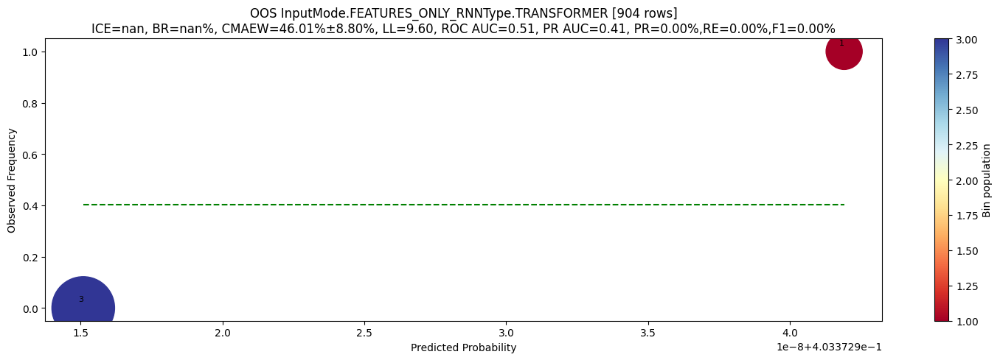

2025-12-31 17:49:34,041 - INFO - prepare_recurrent_training_data-line:237 - Prepared features: (8132, 97), labels: (8132,)


OOS InputMode.FEATURES_ONLY_RNNType.TRANSFORMER
              precision    recall  f1-score   support

           0       0.61      1.00      0.75       547
           1       0.00      0.00      0.00       357

    accuracy                           0.61       904
   macro avg       0.30      0.50      0.38       904
weighted avg       0.37      0.61      0.46       904

ROC AUCs: 1=0.51
PR AUCs: 1=0.41
CALIBRATIONs: 
	1: MAEW=46.01%, STD=8.80%, COV=10%
BRIER LOSSes: 
	1=nan%
LOG_LOSSes: 
	1=9.60
ICEs: 
	1=nan
TOTAL INTEGRAL ERROR: 0.0000


2025-12-31 17:49:39,567 - INFO - prepare_recurrent_training_data-line:260 - Extracted 8132 sequences
2025-12-31 17:49:39,585 - INFO - seed_everything-line:54 - Seed set to 42
2025-12-31 17:49:42,493 - INFO - _info-line:64 - GPU available: True (cuda), used: True
2025-12-31 17:49:42,498 - INFO - _info-line:64 - TPU available: False, using: 0 TPU cores
2025-12-31 17:49:42,501 - INFO - _info-line:64 - HPU available: False, using: 0 HPUs
R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\callbacks\model_checkpoint.py:652: Checkpoint directory S:\recovered13\Programming\MyCurrentProjects\Astronomy\astronomy\checkpoints exists and is not empty.
2025-12-31 17:49:42,511 - INFO - set_nvidia_flags-line:61 - LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
2025-12-31 17:49:42,619 - INFO - _info-line:64 - Loading `train_dataloader` to estimate number of stepping batches.
R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:424: The 'train_dataloader'

Sanity Checking: |                                                                               | 0/? [00:00<…

R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:424: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=31` in the `DataLoader` to improve performance.
R:\ProgramData\anaconda3\Lib\site-packages\torch\nn\modules\linear.py:116: UserWarning:

Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ..\aten\src\ATen\Context.cpp:185.)

S:\recovered13\Programmin

Training: |                                                                                      | 0/? [00:00<…

R:\ProgramData\anaconda3\Lib\site-packages\torch\autograd\graph.py:744: UserWarning:

Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ..\aten\src\ATen\Context.cpp:185.)



Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

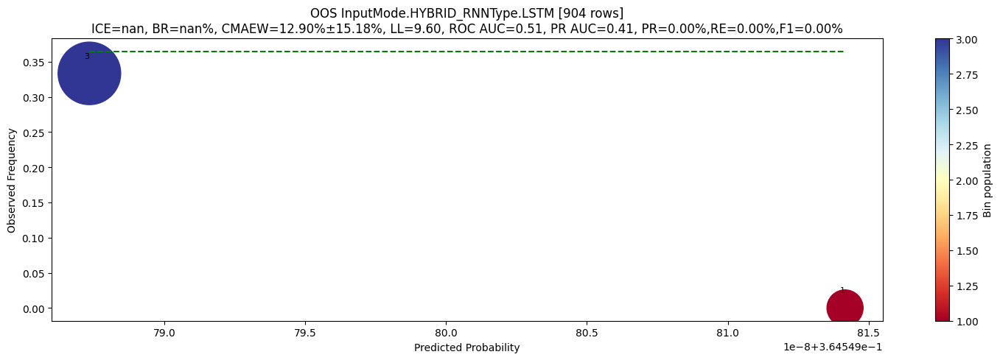

2025-12-31 17:56:07,943 - INFO - prepare_recurrent_training_data-line:237 - Prepared features: (8132, 97), labels: (8132,)


OOS InputMode.HYBRID_RNNType.LSTM
              precision    recall  f1-score   support

           0       0.61      1.00      0.75       547
           1       0.00      0.00      0.00       357

    accuracy                           0.61       904
   macro avg       0.30      0.50      0.38       904
weighted avg       0.37      0.61      0.46       904

ROC AUCs: 1=0.51
PR AUCs: 1=0.41
CALIBRATIONs: 
	1: MAEW=12.90%, STD=15.18%, COV=10%
BRIER LOSSes: 
	1=nan%
LOG_LOSSes: 
	1=9.60
ICEs: 
	1=nan
TOTAL INTEGRAL ERROR: 0.0000


2025-12-31 17:56:13,569 - INFO - prepare_recurrent_training_data-line:260 - Extracted 8132 sequences
2025-12-31 17:56:13,587 - INFO - seed_everything-line:54 - Seed set to 42
2025-12-31 17:56:16,467 - INFO - _info-line:64 - GPU available: True (cuda), used: True
2025-12-31 17:56:16,471 - INFO - _info-line:64 - TPU available: False, using: 0 TPU cores
2025-12-31 17:56:16,474 - INFO - _info-line:64 - HPU available: False, using: 0 HPUs
R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\callbacks\model_checkpoint.py:652: Checkpoint directory S:\recovered13\Programming\MyCurrentProjects\Astronomy\astronomy\checkpoints exists and is not empty.
2025-12-31 17:56:16,482 - INFO - set_nvidia_flags-line:61 - LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
2025-12-31 17:56:16,576 - INFO - _info-line:64 - Loading `train_dataloader` to estimate number of stepping batches.
R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:424: The 'train_dataloader'

Sanity Checking: |                                                                               | 0/? [00:00<…

R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:424: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=31` in the `DataLoader` to improve performance.
R:\ProgramData\anaconda3\Lib\site-packages\torch\nn\modules\linear.py:116: UserWarning:

Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ..\aten\src\ATen\Context.cpp:185.)

S:\recovered13\Programmin

Training: |                                                                                      | 0/? [00:00<…

R:\ProgramData\anaconda3\Lib\site-packages\torch\autograd\graph.py:744: UserWarning:

Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ..\aten\src\ATen\Context.cpp:185.)



Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

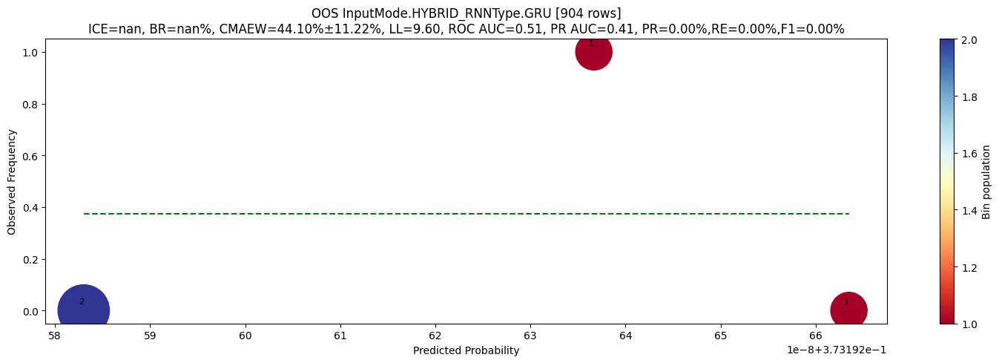

2025-12-31 18:07:12,794 - INFO - prepare_recurrent_training_data-line:237 - Prepared features: (8132, 97), labels: (8132,)


OOS InputMode.HYBRID_RNNType.GRU
              precision    recall  f1-score   support

           0       0.61      1.00      0.75       547
           1       0.00      0.00      0.00       357

    accuracy                           0.61       904
   macro avg       0.30      0.50      0.38       904
weighted avg       0.37      0.61      0.46       904

ROC AUCs: 1=0.51
PR AUCs: 1=0.41
CALIBRATIONs: 
	1: MAEW=44.10%, STD=11.22%, COV=10%
BRIER LOSSes: 
	1=nan%
LOG_LOSSes: 
	1=9.60
ICEs: 
	1=nan
TOTAL INTEGRAL ERROR: 0.0000


2025-12-31 18:07:18,925 - INFO - prepare_recurrent_training_data-line:260 - Extracted 8132 sequences
2025-12-31 18:07:18,943 - INFO - seed_everything-line:54 - Seed set to 42
2025-12-31 18:07:22,313 - INFO - _info-line:64 - GPU available: True (cuda), used: True
2025-12-31 18:07:22,318 - INFO - _info-line:64 - TPU available: False, using: 0 TPU cores
2025-12-31 18:07:22,322 - INFO - _info-line:64 - HPU available: False, using: 0 HPUs
R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\callbacks\model_checkpoint.py:652: Checkpoint directory S:\recovered13\Programming\MyCurrentProjects\Astronomy\astronomy\checkpoints exists and is not empty.
2025-12-31 18:07:22,335 - INFO - set_nvidia_flags-line:61 - LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
2025-12-31 18:07:22,431 - INFO - _info-line:64 - Loading `train_dataloader` to estimate number of stepping batches.
R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:424: The 'train_dataloader'

Sanity Checking: |                                                                               | 0/? [00:00<…

R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:424: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=31` in the `DataLoader` to improve performance.
R:\ProgramData\anaconda3\Lib\site-packages\torch\nn\modules\linear.py:116: UserWarning:

Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ..\aten\src\ATen\Context.cpp:185.)

S:\recovered13\Programmin

Training: |                                                                                      | 0/? [00:00<…

R:\ProgramData\anaconda3\Lib\site-packages\torch\autograd\graph.py:744: UserWarning:

Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ..\aten\src\ATen\Context.cpp:185.)



Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

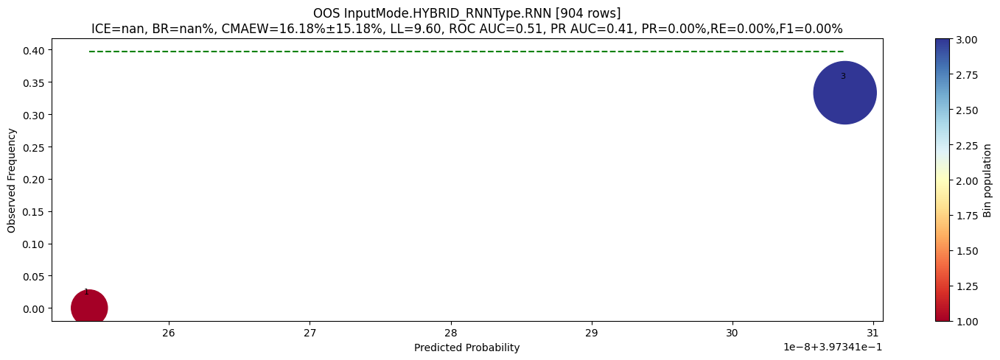

2025-12-31 18:20:03,633 - INFO - prepare_recurrent_training_data-line:237 - Prepared features: (8132, 97), labels: (8132,)


OOS InputMode.HYBRID_RNNType.RNN
              precision    recall  f1-score   support

           0       0.61      1.00      0.75       547
           1       0.00      0.00      0.00       357

    accuracy                           0.61       904
   macro avg       0.30      0.50      0.38       904
weighted avg       0.37      0.61      0.46       904

ROC AUCs: 1=0.51
PR AUCs: 1=0.41
CALIBRATIONs: 
	1: MAEW=16.18%, STD=15.18%, COV=10%
BRIER LOSSes: 
	1=nan%
LOG_LOSSes: 
	1=9.60
ICEs: 
	1=nan
TOTAL INTEGRAL ERROR: 0.0000


2025-12-31 18:20:09,495 - INFO - prepare_recurrent_training_data-line:260 - Extracted 8132 sequences
2025-12-31 18:20:09,524 - INFO - seed_everything-line:54 - Seed set to 42
2025-12-31 18:20:13,347 - INFO - _info-line:64 - GPU available: True (cuda), used: True
2025-12-31 18:20:13,351 - INFO - _info-line:64 - TPU available: False, using: 0 TPU cores
2025-12-31 18:20:13,354 - INFO - _info-line:64 - HPU available: False, using: 0 HPUs
R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\callbacks\model_checkpoint.py:652: Checkpoint directory S:\recovered13\Programming\MyCurrentProjects\Astronomy\astronomy\checkpoints exists and is not empty.
2025-12-31 18:20:13,364 - INFO - set_nvidia_flags-line:61 - LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
2025-12-31 18:20:13,481 - INFO - _info-line:64 - Loading `train_dataloader` to estimate number of stepping batches.
R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:424: The 'train_dataloader'

Sanity Checking: |                                                                               | 0/? [00:00<…

R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:424: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=31` in the `DataLoader` to improve performance.
R:\ProgramData\anaconda3\Lib\site-packages\torch\nn\modules\linear.py:116: UserWarning:

Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ..\aten\src\ATen\Context.cpp:185.)

R:\ProgramData\anaconda3\

Training: |                                                                                      | 0/? [00:00<…

R:\ProgramData\anaconda3\Lib\site-packages\torch\nn\functional.py:4884: UserWarning:

Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ..\aten\src\ATen\Context.cpp:185.)

R:\ProgramData\anaconda3\Lib\site-packages\torch\nn\functional.py:5507: UserWarning:

Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable det

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

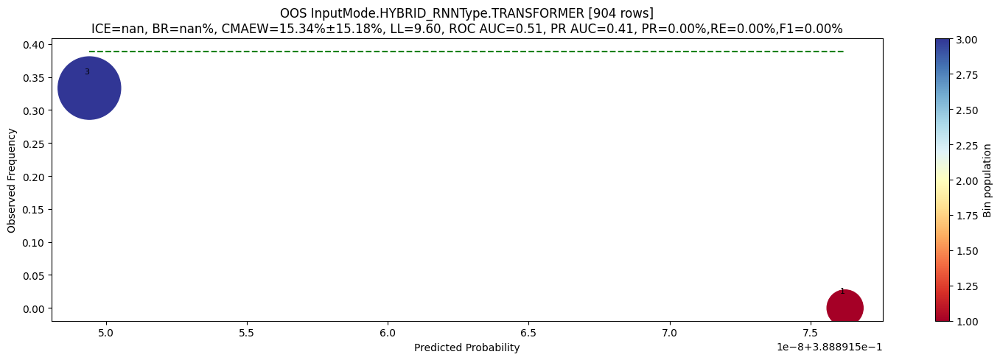

OOS InputMode.HYBRID_RNNType.TRANSFORMER
              precision    recall  f1-score   support

           0       0.61      1.00      0.75       547
           1       0.00      0.00      0.00       357

    accuracy                           0.61       904
   macro avg       0.30      0.50      0.38       904
weighted avg       0.37      0.61      0.46       904

ROC AUCs: 1=0.51
PR AUCs: 1=0.41
CALIBRATIONs: 
	1: MAEW=15.34%, STD=15.18%, COV=10%
BRIER LOSSes: 
	1=nan%
LOG_LOSSes: 
	1=9.60
ICEs: 
	1=nan
TOTAL INTEGRAL ERROR: 0.0000
time: 1h 56min 29s (started: 2025-12-31 16:27:28 +03:00)


In [70]:
model = train_recurrent_classifier(
    labeled_df,
    unlabeled_dataset=dataset["target"],
    known_flares_dataset=dataset["test"],
    sequence_cols=("mjd", "mag", "magerr"),
    input_mode="sequence",  # "features", "sequence", "hybrid"
    rnn_type="lstm",
    **params
)

2025-12-31 15:01:30,171 - INFO - prepare_recurrent_training_data-line:235 - Prepared features: (9036, 97), labels: (9036,)
2025-12-31 15:01:37,267 - INFO - prepare_recurrent_training_data-line:258 - Extracted 9036 sequences
2025-12-31 15:01:37,301 - INFO - seed_everything-line:54 - Seed set to 42
2025-12-31 15:01:41,567 - INFO - _info-line:64 - GPU available: True (cuda), used: True
2025-12-31 15:01:41,571 - INFO - _info-line:64 - TPU available: False, using: 0 TPU cores
2025-12-31 15:01:41,575 - INFO - _info-line:64 - HPU available: False, using: 0 HPUs
R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\callbacks\model_checkpoint.py:652: Checkpoint directory S:\recovered13\Programming\MyCurrentProjects\Astronomy\astronomy\checkpoints exists and is not empty.
2025-12-31 15:01:41,584 - INFO - set_nvidia_flags-line:61 - LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
2025-12-31 15:01:41,696 - INFO - _info-line:64 - Loading `train_dataloader` to estimate number of stepping batches.
R:

Sanity Checking: |                                                                               | 0/? [00:00<…

R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:424: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=31` in the `DataLoader` to improve performance.
R:\ProgramData\anaconda3\Lib\site-packages\torch\nn\modules\linear.py:116: UserWarning:

Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ..\aten\src\ATen\Context.cpp:185.)

S:\recovered13\Programmin

Training: |                                                                                      | 0/? [00:00<…

R:\ProgramData\anaconda3\Lib\site-packages\torch\autograd\graph.py:744: UserWarning:

Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ..\aten\src\ATen\Context.cpp:185.)



Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

Validation: |                                                                                    | 0/? [00:00<…

time: 25min 32s (started: 2025-12-31 15:01:30 +03:00)


R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\trainer\call.py:54: Detected KeyboardInterrupt, attempting graceful shutdown...


In [ ]:
model = train_recurrent_classifier(
    labeled_df,
    unlabeled_dataset=dataset["target"],
    known_flares_dataset=dataset["test"],
    sequence_cols=("mjd", "mag", "magerr"),
    input_mode="sequence",  # "features", "sequence", "hybrid"
    rnn_type="gru",
    **params
)

In [ ]:
model = train_recurrent_classifier(
    labeled_df,
    unlabeled_dataset=dataset["target"],
    known_flares_dataset=dataset["test"],
    sequence_cols=("mjd", "mag", "magerr"),
    input_mode="sequence",  # "features", "sequence", "hybrid"
    rnn_type="rnn",
    **params
)

2026-01-01 13:32:03,143 - INFO - log_phase-line:44 - ----------------------------------------------------------------------------------------------------------------------------------------------------------------
2026-01-01 13:32:03,148 - INFO - log_phase-line:45 - Starting mlframe training suite: flares
2026-01-01 13:32:03,151 - INFO - log_phase-line:46 - ----------------------------------------------------------------------------------------------------------------------------------------------------------------
2026-01-01 13:32:03,154 - INFO - log_phase-line:44 - ----------------------------------------------------------------------------------------------------------------------------------------------------------------
2026-01-01 13:32:03,157 - INFO - log_phase-line:45 - PHASE 1: Data Loading & Preprocessing
2026-01-01 13:32:03,160 - INFO - log_phase-line:46 - -------------------------------------------------------------------------------------------------------------------------

Raw data:
<class 'polars.dataframe.frame.DataFrame'>
RangeIndex: 8132 entries, 0 to 8131
Columns: 101 entries, _orig_idx to _dataset
dtypes: Datetime(time_unit='us', time_zone='UTC')(1), Float32(71), Float64(4), Int32(6), String(1), UInt32(18)
memory usage: 0.0+ GB
Processed data:
<class 'polars.dataframe.frame.DataFrame'>
RangeIndex: 8132 entries, 0 to 8131
Columns: 101 entries, _orig_idx to _dataset
dtypes: Datetime(time_unit='us', time_zone='UTC')(1), Float32(71), Float64(4), Int32(6), String(1), UInt32(18)
memory usage: 0.0+ GB


,_orig_idx,class,npoints,mag_arg_min,mag_arg_max,mag_n_unique,mag_trend_changes,magerr_arg_min,magerr_arg_max,magerr_n_unique,magerr_trend_changes,norm_arg_min,norm_arg_max,norm_n_unique,norm_trend_changes,mjd_diff_arg_min,mjd_diff_arg_max,mjd_diff_n_unique,mjd_diff_trend_changes,ts,norm_n_below_3sigma,norm_max_consecutive_below_2sigma,norm_n_local_minima,norm_n_zero_crossings,norm_frac_below_3sigma,norm_max_consecutive_frac_below_2sigma,norm_frac_local_minima,norm_frac_zero_crossings,source,_dataset
0,1194658,0,43,22,4,43,26,22,4,43,26,22,4,43,26,0,1,2,31,2019-06-01 00:00:00+00:00,9,10,13,11,0.209302,0.232558,0.302326,0.255814,unlabeled_neg,0
1,79245231,1,109,68,107,109,68,68,107,109,68,68,107,109,68,1,0,2,44,2020-06-24 00:00:00+00:00,13,13,34,34,0.119266,0.119266,0.311927,0.311927,unlabeled_pos,0
2,3960721,0,132,56,8,131,82,56,8,131,82,56,8,131,82,0,2,2,46,2018-07-04 00:00:00+00:00,13,14,41,48,0.098485,0.106061,0.310606,0.363636,unlabeled_neg,0
3,20110146,0,135,121,51,135,81,121,51,135,81,121,51,135,81,0,5,2,46,2018-07-20 00:00:00+00:00,14,14,40,50,0.103704,0.103704,0.296296,0.370370,unlabeled_neg,0
4,1899969,0,140,99,1,140,87,99,1,140,87,99,1,140,87,0,7,2,48,2019-06-01 00:00:00+00:00,7,7,43,57,0.050000,0.050000,0.307143,0.407143,unlabeled_neg,0


'binary_classification class'

,proportion
i8,f64
0,0.605386
1,0.394614


,_orig_idx,class,npoints,mag_mean,mag_std,mag_min,mag_max,mag_median,mag_q25,mag_q75,...,wv_db4_d4_energy,wv_sym4_total_energy,wv_sym4_detail_ratio,wv_sym4_max_detail,wv_sym4_d1_energy,wv_sym4_d2_energy,wv_sym4_d3_energy,wv_sym4_d4_energy,source,_dataset
0,1194658,0,43,21.073467,0.434601,20.123587,21.629410,21.267361,20.951801,21.360657,...,0.000000,246.804092,0.119111,2.493529,7.662905,21.734127,0.000000,0.000000,unlabeled_neg,0
1,79245231,1,109,16.497986,0.051736,16.295444,16.553083,16.512302,16.490498,16.527163,...,0.000000,1279.754517,0.356477,10.793934,203.846909,142.622513,109.733482,0.000000,unlabeled_pos,0
2,3960721,0,132,17.375864,0.083997,17.007389,17.462887,17.397747,17.383497,17.414661,...,72.014984,1577.524536,0.269568,11.457329,177.802582,151.043625,20.608265,75.795219,unlabeled_neg,0
3,20110146,0,135,18.553247,0.122971,18.106068,18.711658,18.581829,18.548067,18.616898,...,64.932091,1040.864746,0.389338,10.917519,228.094025,68.495193,45.089180,63.569630,unlabeled_neg,0
4,1899969,0,140,19.533705,0.347992,17.985849,19.829674,19.604832,19.560648,19.647636,...,180.702423,3370.317627,0.452443,26.387697,939.395569,166.857361,204.931320,213.692444,unlabeled_neg,0


,_orig_idx,class,npoints,mag_mean,mag_std,mag_min,mag_max,mag_median,mag_q25,mag_q75,...,wv_db4_d4_energy,wv_sym4_total_energy,wv_sym4_detail_ratio,wv_sym4_max_detail,wv_sym4_d1_energy,wv_sym4_d2_energy,wv_sym4_d3_energy,wv_sym4_d4_energy,source,_dataset
0,14818887,0,133,17.130640,0.094579,16.750607,17.219568,17.154057,17.133625,17.179558,...,68.690948,2274.694824,0.463341,16.963802,803.923523,157.343857,35.738194,56.954803,unlabeled_neg,0
1,13364473,0,112,18.715443,0.236694,17.949448,18.918367,18.783401,18.742233,18.827837,...,66.420639,2767.741211,0.532208,32.137058,1183.885132,103.617653,97.787910,87.723877,unlabeled_neg,0
2,32772726,1,87,19.792654,0.307404,18.377728,20.377874,19.832180,19.706091,19.963215,...,0.000000,803.888611,0.391297,8.104538,97.963852,89.871674,126.723679,0.000000,unlabeled_pos,0
3,21027546,0,135,17.519121,0.096655,17.129395,17.599480,17.547720,17.528126,17.563416,...,70.110069,2189.683350,0.181479,10.520716,235.122070,60.095005,40.447269,61.716602,unlabeled_neg,0
4,76893905,1,47,19.179667,0.883816,15.931329,20.072630,19.563869,18.898298,19.669952,...,0.000000,6115.539062,0.321543,26.570101,1558.950928,407.455200,0.000000,0.000000,unlabeled_pos,0


2026-01-01 13:32:03,731 - INFO - log_ram_usage-line:39 - Done. RAM usage: 5.0GB.
2026-01-01 13:32:06,916 - INFO - log_ram_usage-line:39 - Done. RAM usage: 0.0GB.
2026-01-01 13:32:06,923 - INFO - drop_columns_from_dataframe-line:83 - Dropping 4 column(s): class,id,ts,source...
2026-01-01 13:32:08,948 - INFO - log_ram_usage-line:39 - Done. RAM usage: 0.0GB.
2026-01-01 13:32:08,956 - INFO - _process_special_values-line:198 - Identifying constant numeric columns...
2026-01-01 13:32:08,976 - INFO - _process_special_values-line:198 - Identifying constant non-numeric columns...
2026-01-01 13:32:08,991 - INFO - preprocess_dataframe-line:145 - Preprocessing: (8132, 98) -> (8132, 98)
2026-01-01 13:32:08,996 - INFO - log_ram_usage-line:39 - Done. RAM usage: 0.0GB.
2026-01-01 13:32:09,000 - INFO - log_phase-line:44 - ----------------------------------------------------------------------------------------------------------------------------------------------------------------
2026-01-01 13:32:09,00

target type:   0%|          | 0/1 [00:00<?, ?it/s]

target:   0%|          | 0/1 [00:00<?, ?it/s]

2026-01-01 13:32:14,940 - INFO - train_mlframe_models_suite-line:1107 - select_target...
2026-01-01 13:32:15,694 - INFO - configure_training_params-line:1761 - data_fits_gpu_ram=True, data_fits_cb_gpu_ram=True, cb_devices=None
2026-01-01 13:32:15,710 - INFO - log_ram_usage-line:39 - Done. RAM usage: 0.1GB.


pre_pipeline:   0%|          | 0/1 [00:00<?, ?it/s]

2026-01-01 13:32:15,727 - INFO - train_mlframe_models_suite-line:1182 - No weighting schemas from extractor, defaulting to uniform weighting.


mlframe model:   0%|          | 0/6 [00:00<?, ?it/s]

weighting schema:   0%|          | 0/1 [00:00<?, ?it/s]

2026-01-01 13:32:15,760 - INFO - process_model-line:453 - Starting train_and_evaluate CatBoostClassifier on binary_classification lumcurves flares class BT=39%, RAM usage 0.1GBs...
2026-01-01 13:32:19,335 - INFO - train_and_evaluate_model-line:1310 - training dataset shape: (7318, 98)
2026-01-01 13:32:21,532 - INFO - train_and_evaluate_model-line:1326 - Training the model...
R:\ProgramData\anaconda3\Lib\site-packages\catboost\core.py:2321: UserWarning:

Can't optimze method "evaluate" because self argument is used



MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Default metric period is 5 because PythonUserDefinedPerObject is/are not implemented for GPU
2026-01-01 13:33:34,862 - INFO - _train_model_with_fallback-line:692 - es_best_iter: 378
2026-01-01 13:33:34,868 - INFO - train_and_evaluate_model-line:1376 - Computing model's performance...


es_best_iter: 378


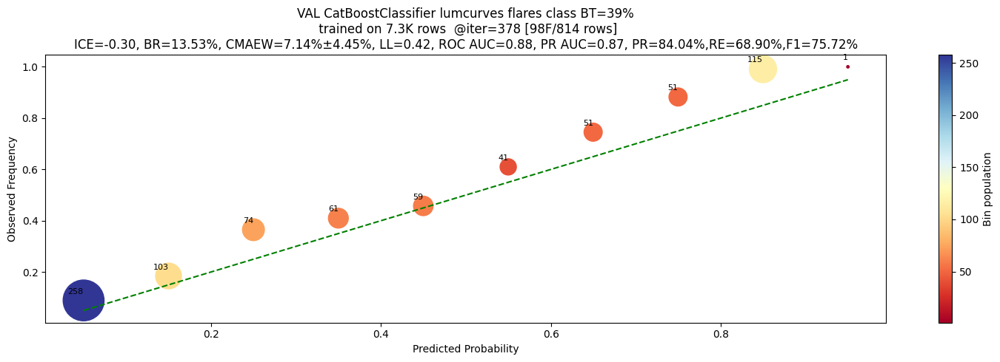

VAL CatBoostClassifier lumcurves flares class BT=39%
 trained on 7.3K rows  @iter=378
              precision    recall  f1-score   support

           0     0.7989    0.9043    0.8483       470
           1     0.8404    0.6890    0.7572       344

    accuracy                         0.8133       814
   macro avg     0.8196    0.7966    0.8027       814
weighted avg     0.8164    0.8133    0.8098       814

ROC AUCs: 1=0.8828
PR AUCs: 1=0.8718
CALIBRATIONs: 
	1: MAEW=7.14%, STD=4.45%, COV=100%
BRIER LOSSes: 
	1=13.5307%
LOG_LOSSes: 
	1=0.4249
ICEs: 
	1=-0.3040
TOTAL INTEGRAL ERROR: -0.3040


2026-01-01 13:33:47,134 - INFO - process_model-line:478 - Finished training, took 1.5 min. RAM usage 0.0GBs...
2026-01-01 13:33:47,215 - INFO - save_mlframe_model-line:55 - Model saved successfully to data\models\lumcurves\flares\binary_classification\class\cb.dump. Size: 0.14 Mb


weighting schema:   0%|          | 0/1 [00:00<?, ?it/s]

2026-01-01 13:33:48,811 - INFO - process_model-line:453 - Starting train_and_evaluate XGBClassifier on binary_classification lumcurves flares class BT=39%, RAM usage 0.0GBs...
2026-01-01 13:33:52,143 - INFO - train_and_evaluate_model-line:1310 - training dataset shape: (7318, 98)
2026-01-01 13:33:53,556 - INFO - train_and_evaluate_model-line:1326 - Training the model...
2026-01-01 13:34:02,924 - INFO - _train_model_with_fallback-line:692 - es_best_iter: 154
2026-01-01 13:34:02,927 - INFO - train_and_evaluate_model-line:1376 - Computing model's performance...


es_best_iter: 154


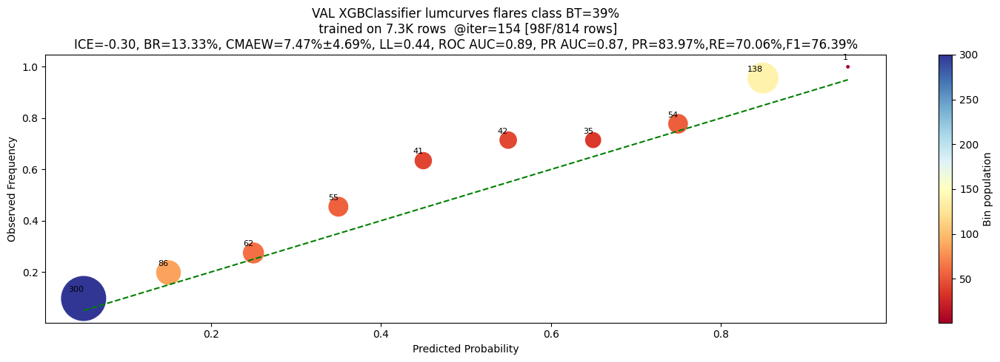

VAL XGBClassifier lumcurves flares class BT=39%
 trained on 7.3K rows  @iter=154
              precision    recall  f1-score   support

           0     0.8046    0.9021    0.8506       470
           1     0.8397    0.7006    0.7639       344

    accuracy                         0.8170       814
   macro avg     0.8221    0.8014    0.8072       814
weighted avg     0.8194    0.8170    0.8139       814

ROC AUCs: 1=0.8886
PR AUCs: 1=0.8738
CALIBRATIONs: 
	1: MAEW=7.47%, STD=4.69%, COV=100%
BRIER LOSSes: 
	1=13.3302%
LOG_LOSSes: 
	1=0.4367
ICEs: 
	1=-0.2991
TOTAL INTEGRAL ERROR: -0.2991


2026-01-01 13:34:08,698 - INFO - process_model-line:478 - Finished training, took 0.3 min. RAM usage 0.0GBs...
2026-01-01 13:34:08,785 - INFO - save_mlframe_model-line:55 - Model saved successfully to data\models\lumcurves\flares\binary_classification\class\xgb.dump. Size: 0.27 Mb


weighting schema:   0%|          | 0/1 [00:00<?, ?it/s]

2026-01-01 13:34:10,840 - INFO - process_model-line:453 - Starting train_and_evaluate LGBMClassifier on binary_classification lumcurves flares class BT=39%, RAM usage 0.0GBs...
2026-01-01 13:34:13,956 - INFO - train_and_evaluate_model-line:1310 - training dataset shape: (7318, 98)
2026-01-01 13:34:15,582 - INFO - train_and_evaluate_model-line:1326 - Training the model...
2026-01-01 13:34:20,460 - WARNING - _train_model_with_fallback-line:663 - Model LGBMClassifier(device_type='cpu', early_stopping_rounds=100, n_estimators=700,
               verbose=-1) skipped due to error 'pandas dtypes must be int, float or bool, got _orig_idx            float[pyarrow]
npoints              float[pyarrow]
mag_mean             float[pyarrow]
mag_std              float[pyarrow]
mag_min              float[pyarrow]
                          ...      
wv_sym4_d1_energy    float[pyarrow]
wv_sym4_d2_energy    float[pyarrow]
wv_sym4_d3_energy    float[pyarrow]
wv_sym4_d4_energy    float[pyarrow]
_dataset    

weighting schema:   0%|          | 0/1 [00:00<?, ?it/s]

2026-01-01 13:34:20,534 - INFO - process_model-line:453 - Starting train_and_evaluate NGBClassifier on binary_classification lumcurves flares class BT=39%, RAM usage 0.0GBs...
2026-01-01 13:34:22,167 - INFO - _apply_pre_pipeline_transforms-line:475 - Fitting & transforming train_df via pre_pipeline Pipeline(steps=[('imp', SimpleImputer()), ('scaler', StandardScaler())])...
2026-01-01 13:34:22,402 - INFO - log_ram_usage-line:39 - Done. RAM usage: 0.0GB.
2026-01-01 13:34:22,405 - INFO - _apply_pre_pipeline_transforms-line:481 - Transforming val_df via pre_pipeline Pipeline(steps=[('imp', SimpleImputer()), ('scaler', StandardScaler())])...
2026-01-01 13:34:22,450 - INFO - log_ram_usage-line:39 - Done. RAM usage: 0.0GB.
2026-01-01 13:34:25,470 - INFO - train_and_evaluate_model-line:1310 - training dataset shape: (7318, 98)
2026-01-01 13:34:26,780 - INFO - train_and_evaluate_model-line:1326 - Training the model...


[iter 0] loss=0.6694 val_loss=0.6412 scale=2.0000 norm=4.0000
[iter 100] loss=0.4305 val_loss=0.5105 scale=0.0010 norm=0.0017
== Early stopping achieved.
== Best iteration / VAL60 (val_loss=0.5096)


2026-01-01 13:35:19,292 - INFO - train_and_evaluate_model-line:1376 - Computing model's performance...


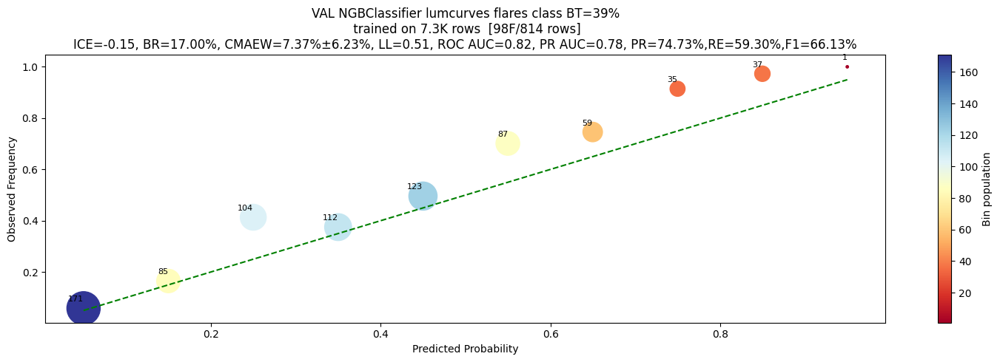

VAL NGBClassifier lumcurves flares class BT=39%
 trained on 7.3K rows 
              precision    recall  f1-score   support

           0     0.7412    0.8532    0.7933       470
           1     0.7473    0.5930    0.6613       344

    accuracy                         0.7432       814
   macro avg     0.7442    0.7231    0.7273       814
weighted avg     0.7438    0.7432    0.7375       814

ROC AUCs: 1=0.8218
PR AUCs: 1=0.7818
CALIBRATIONs: 
	1: MAEW=7.37%, STD=6.23%, COV=100%
BRIER LOSSes: 
	1=17.0050%
LOG_LOSSes: 
	1=0.5105
ICEs: 
	1=-0.1471
TOTAL INTEGRAL ERROR: -0.1471


2026-01-01 13:35:22,200 - INFO - process_model-line:478 - Finished training, took 1.0 min. RAM usage 0.0GBs...
2026-01-01 13:35:22,391 - INFO - save_mlframe_model-line:55 - Model saved successfully to data\models\lumcurves\flares\binary_classification\class\ngb.dump. Size: 0.06 Mb


weighting schema:   0%|          | 0/1 [00:00<?, ?it/s]

2026-01-01 13:35:24,371 - INFO - process_model-line:453 - Starting train_and_evaluate HistGradientBoostingClassifier on binary_classification lumcurves flares class BT=39%, RAM usage 0.0GBs...
2026-01-01 13:35:27,134 - INFO - train_and_evaluate_model-line:1310 - training dataset shape: (7318, 98)
2026-01-01 13:35:28,454 - INFO - train_and_evaluate_model-line:1326 - Training the model...
2026-01-01 13:35:32,546 - INFO - train_and_evaluate_model-line:1376 - Computing model's performance...


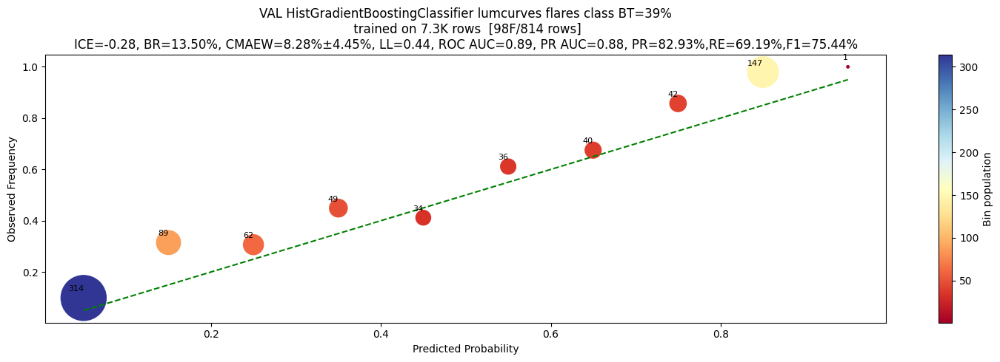

VAL HistGradientBoostingClassifier lumcurves flares class BT=39%
 trained on 7.3K rows 
              precision    recall  f1-score   support

           0     0.7989    0.8957    0.8445       470
           1     0.8293    0.6919    0.7544       344

    accuracy                         0.8096       814
   macro avg     0.8141    0.7938    0.7994       814
weighted avg     0.8117    0.8096    0.8064       814

ROC AUCs: 1=0.8884
PR AUCs: 1=0.8798
CALIBRATIONs: 
	1: MAEW=8.28%, STD=4.45%, COV=90%
BRIER LOSSes: 
	1=13.5008%
LOG_LOSSes: 
	1=0.4379
ICEs: 
	1=-0.2793
TOTAL INTEGRAL ERROR: -0.2793


2026-01-01 13:35:38,954 - INFO - process_model-line:478 - Finished training, took 0.2 min. RAM usage 0.0GBs...
2026-01-01 13:35:39,117 - INFO - save_mlframe_model-line:55 - Model saved successfully to data\models\lumcurves\flares\binary_classification\class\hgb.dump. Size: 0.31 Mb


weighting schema:   0%|          | 0/1 [00:00<?, ?it/s]

2026-01-01 13:35:40,588 - INFO - process_model-line:453 - Starting train_and_evaluate LogisticRegression on binary_classification lumcurves flares class BT=39%, RAM usage 0.0GBs...
2026-01-01 13:35:41,929 - INFO - _apply_pre_pipeline_transforms-line:461 - Using pre-fitted pipeline (transform only): Pipeline(steps=[('imp', SimpleImputer()), ('scaler', StandardScaler())])
2026-01-01 13:35:42,051 - INFO - log_ram_usage-line:39 - Done. RAM usage: 0.0GB.
2026-01-01 13:35:42,054 - INFO - _apply_pre_pipeline_transforms-line:469 - Transforming val_df via pre_pipeline...
2026-01-01 13:35:42,095 - INFO - log_ram_usage-line:39 - Done. RAM usage: 0.0GB.
2026-01-01 13:35:44,729 - INFO - train_and_evaluate_model-line:1310 - training dataset shape: (7318, 98)
2026-01-01 13:35:46,737 - INFO - train_and_evaluate_model-line:1326 - Training the model...
2026-01-01 13:35:48,721 - INFO - train_and_evaluate_model-line:1376 - Computing model's performance...


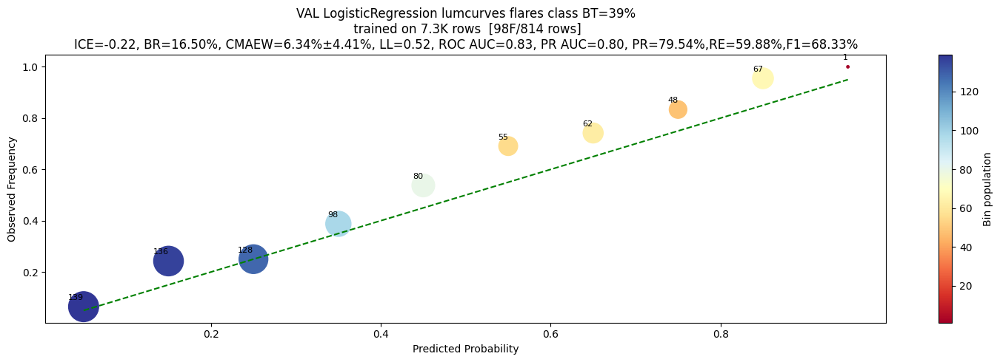

VAL LogisticRegression lumcurves flares class BT=39%
 trained on 7.3K rows 
              precision    recall  f1-score   support

           0     0.7514    0.8872    0.8137       470
           1     0.7954    0.5988    0.6833       344

    accuracy                         0.7654       814
   macro avg     0.7734    0.7430    0.7485       814
weighted avg     0.7700    0.7654    0.7585       814

ROC AUCs: 1=0.8259
PR AUCs: 1=0.7959
CALIBRATIONs: 
	1: MAEW=6.34%, STD=4.41%, COV=100%
BRIER LOSSes: 
	1=16.4989%
LOG_LOSSes: 
	1=0.5151
ICEs: 
	1=-0.2240
TOTAL INTEGRAL ERROR: -0.2240


2026-01-01 13:35:50,879 - INFO - process_model-line:478 - Finished training, took 0.2 min. RAM usage 0.0GBs...
2026-01-01 13:35:50,914 - INFO - save_mlframe_model-line:55 - Model saved successfully to data\models\lumcurves\flares\binary_classification\class\linear.dump. Size: 0.02 Mb
2026-01-01 13:35:52,904 - INFO - train_mlframe_models_suite-line:1276 - evaluating simple ensembles...


ens member 0 excluded due to high distance from the median, mae=0.049687, std=0.080723
ens member 1 excluded due to high distance from the median, mae=0.064406, std=0.085036
ens member 2 excluded due to high distance from the median, mae=0.113276, std=0.117855
ens member 3 excluded due to high distance from the median, mae=0.073020, std=0.093025
ens member 4 excluded due to high distance from the median, mae=0.121550, std=0.128526
ensemble_probabilistic_predictions filters too restrictive (5 vs 5), skipping them


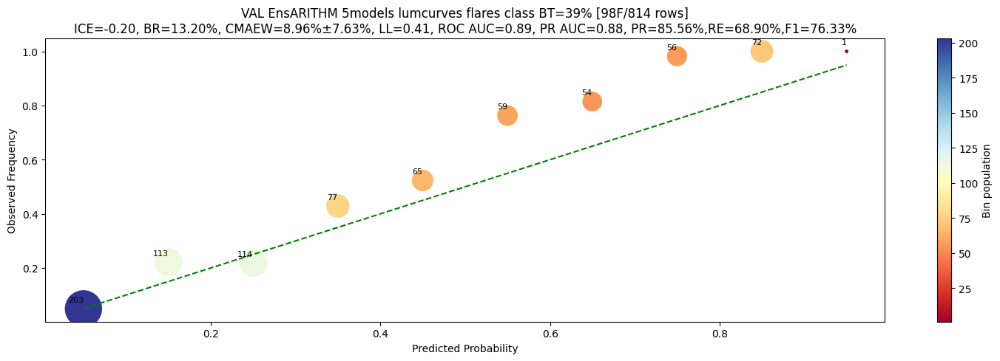

VAL EnsARITHM 5models lumcurves flares class BT=39%
              precision    recall  f1-score   support

           0     0.8007    0.9149    0.8540       470
           1     0.8556    0.6890    0.7633       344

    accuracy                         0.8194       814
   macro avg     0.8282    0.8019    0.8087       814
weighted avg     0.8239    0.8194    0.8157       814

ROC AUCs: 1=0.8906
PR AUCs: 1=0.8805
CALIBRATIONs: 
	1: MAEW=8.96%, STD=7.63%, COV=90%
BRIER LOSSes: 
	1=13.1981%
LOG_LOSSes: 
	1=0.4111
ICEs: 
	1=-0.1998
TOTAL INTEGRAL ERROR: -0.1998


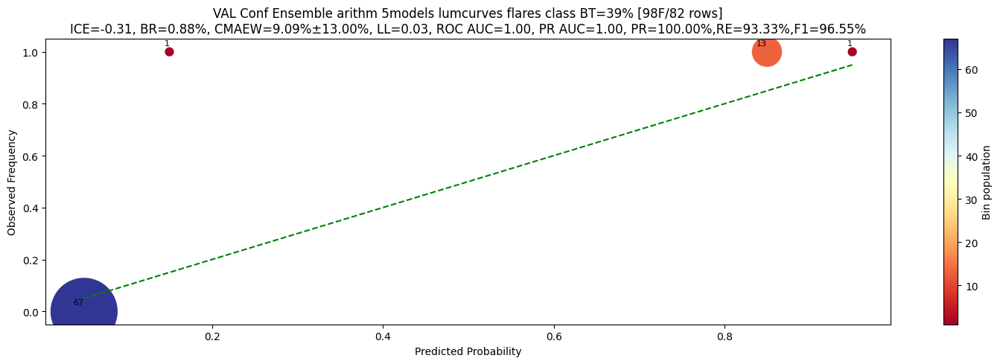

VAL Conf Ensemble arithm 5models lumcurves flares class BT=39%
              precision    recall  f1-score   support

           0     0.9853    1.0000    0.9926        67
           1     1.0000    0.9333    0.9655        15

    accuracy                         0.9878        82
   macro avg     0.9926    0.9667    0.9791        82
weighted avg     0.9880    0.9878    0.9876        82

ROC AUCs: 1=1.0000
PR AUCs: 1=1.0000
CALIBRATIONs: 
	1: MAEW=9.09%, STD=13.00%, COV=30%
BRIER LOSSes: 
	1=0.8837%
LOG_LOSSes: 
	1=0.0294
ICEs: 
	1=-0.3137
TOTAL INTEGRAL ERROR: -0.3137
ens member 0 excluded due to high distance from the median, mae=0.049687, std=0.080723
ens member 1 excluded due to high distance from the median, mae=0.064406, std=0.085036
ens member 2 excluded due to high distance from the median, mae=0.113276, std=0.117855
ens member 3 excluded due to high distance from the median, mae=0.073020, std=0.093025
ens member 4 excluded due to high distance from the median, mae=0.121550, std

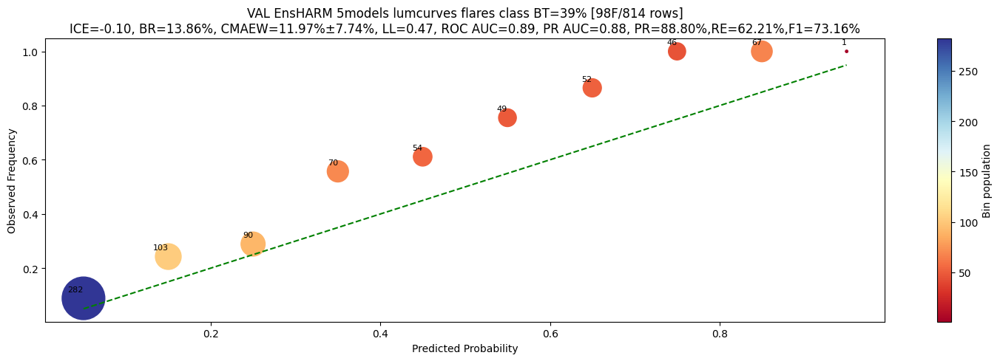

VAL EnsHARM 5models lumcurves flares class BT=39%
              precision    recall  f1-score   support

           0     0.7731    0.9426    0.8495       470
           1     0.8880    0.6221    0.7316       344

    accuracy                         0.8071       814
   macro avg     0.8305    0.7823    0.7905       814
weighted avg     0.8217    0.8071    0.7997       814

ROC AUCs: 1=0.8889
PR AUCs: 1=0.8793
CALIBRATIONs: 
	1: MAEW=11.97%, STD=7.74%, COV=100%
BRIER LOSSes: 
	1=13.8643%
LOG_LOSSes: 
	1=0.4657
ICEs: 
	1=-0.1019
TOTAL INTEGRAL ERROR: -0.1019


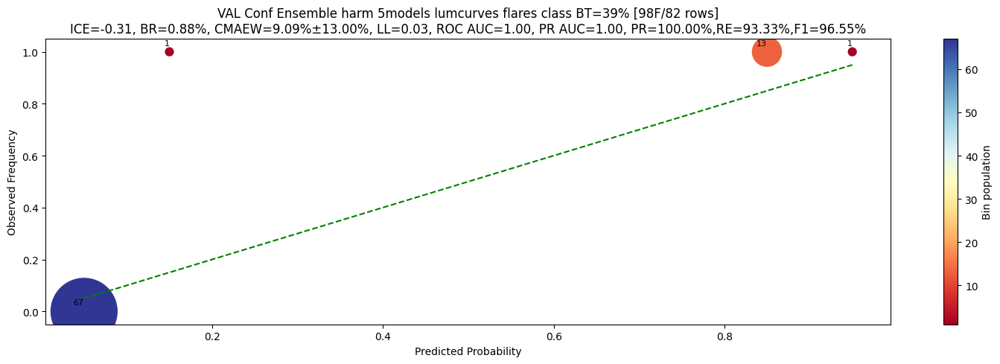

VAL Conf Ensemble harm 5models lumcurves flares class BT=39%
              precision    recall  f1-score   support

           0     0.9853    1.0000    0.9926        67
           1     1.0000    0.9333    0.9655        15

    accuracy                         0.9878        82
   macro avg     0.9926    0.9667    0.9791        82
weighted avg     0.9880    0.9878    0.9876        82

ROC AUCs: 1=1.0000
PR AUCs: 1=1.0000
CALIBRATIONs: 
	1: MAEW=9.09%, STD=13.00%, COV=40%
BRIER LOSSes: 
	1=0.8810%
LOG_LOSSes: 
	1=0.0253
ICEs: 
	1=-0.3138
TOTAL INTEGRAL ERROR: -0.3138
ens member 0 excluded due to high distance from the median, mae=0.049687, std=0.080723
ens member 1 excluded due to high distance from the median, mae=0.064406, std=0.085036
ens member 2 excluded due to high distance from the median, mae=0.113276, std=0.117855
ens member 3 excluded due to high distance from the median, mae=0.073020, std=0.093025
ens member 4 excluded due to high distance from the median, mae=0.121550, std=0

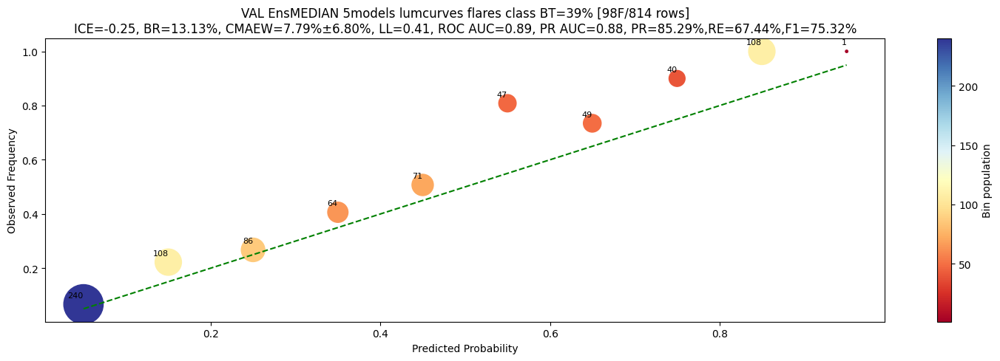

VAL EnsMEDIAN 5models lumcurves flares class BT=39%
              precision    recall  f1-score   support

           0     0.7934    0.9149    0.8498       470
           1     0.8529    0.6744    0.7532       344

    accuracy                         0.8133       814
   macro avg     0.8231    0.7947    0.8015       814
weighted avg     0.8185    0.8133    0.8090       814

ROC AUCs: 1=0.8908
PR AUCs: 1=0.8788
CALIBRATIONs: 
	1: MAEW=7.79%, STD=6.80%, COV=90%
BRIER LOSSes: 
	1=13.1346%
LOG_LOSSes: 
	1=0.4094
ICEs: 
	1=-0.2517
TOTAL INTEGRAL ERROR: -0.2517


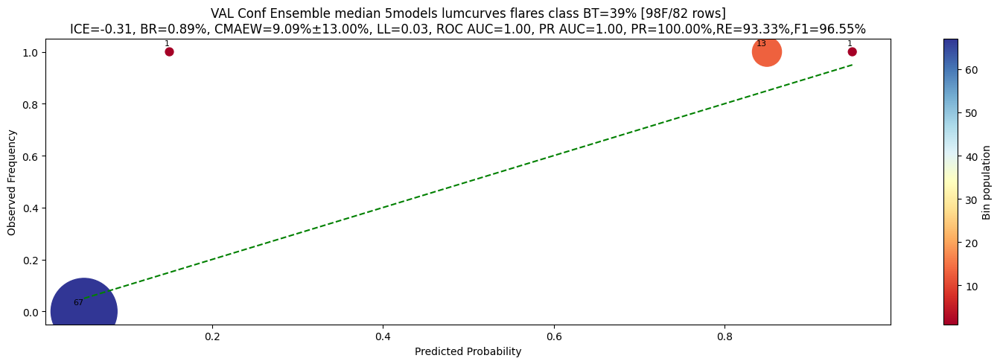

VAL Conf Ensemble median 5models lumcurves flares class BT=39%
              precision    recall  f1-score   support

           0     0.9853    1.0000    0.9926        67
           1     1.0000    0.9333    0.9655        15

    accuracy                         0.9878        82
   macro avg     0.9926    0.9667    0.9791        82
weighted avg     0.9880    0.9878    0.9876        82

ROC AUCs: 1=1.0000
PR AUCs: 1=1.0000
CALIBRATIONs: 
	1: MAEW=9.09%, STD=13.00%, COV=30%
BRIER LOSSes: 
	1=0.8930%
LOG_LOSSes: 
	1=0.0267
ICEs: 
	1=-0.3137
TOTAL INTEGRAL ERROR: -0.3137
ens member 0 excluded due to high distance from the median, mae=0.049687, std=0.080723
ens member 1 excluded due to high distance from the median, mae=0.064406, std=0.085036
ens member 2 excluded due to high distance from the median, mae=0.113276, std=0.117855
ens member 3 excluded due to high distance from the median, mae=0.073020, std=0.093025
ens member 4 excluded due to high distance from the median, mae=0.121550, std

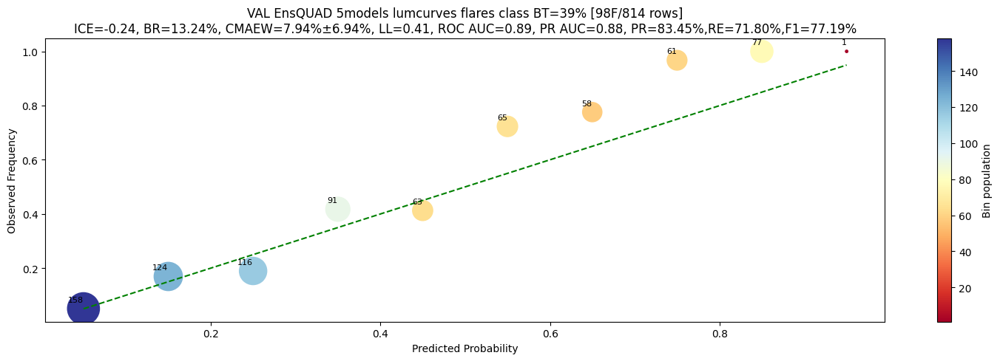

VAL EnsQUAD 5models lumcurves flares class BT=39%
              precision    recall  f1-score   support

           0     0.8127    0.8957    0.8522       470
           1     0.8345    0.7180    0.7719       344

    accuracy                         0.8206       814
   macro avg     0.8236    0.8069    0.8121       814
weighted avg     0.8219    0.8206    0.8183       814

ROC AUCs: 1=0.8881
PR AUCs: 1=0.8786
CALIBRATIONs: 
	1: MAEW=7.94%, STD=6.94%, COV=90%
BRIER LOSSes: 
	1=13.2435%
LOG_LOSSes: 
	1=0.4119
ICEs: 
	1=-0.2401
TOTAL INTEGRAL ERROR: -0.2401


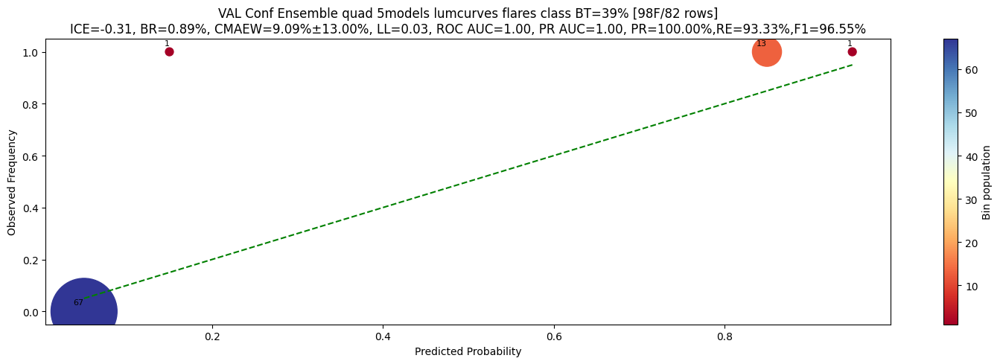

VAL Conf Ensemble quad 5models lumcurves flares class BT=39%
              precision    recall  f1-score   support

           0     0.9853    1.0000    0.9926        67
           1     1.0000    0.9333    0.9655        15

    accuracy                         0.9878        82
   macro avg     0.9926    0.9667    0.9791        82
weighted avg     0.9880    0.9878    0.9876        82

ROC AUCs: 1=1.0000
PR AUCs: 1=1.0000
CALIBRATIONs: 
	1: MAEW=9.09%, STD=13.00%, COV=30%
BRIER LOSSes: 
	1=0.8901%
LOG_LOSSes: 
	1=0.0322
ICEs: 
	1=-0.3136
TOTAL INTEGRAL ERROR: -0.3136
ens member 0 excluded due to high distance from the median, mae=0.049687, std=0.080723
ens member 1 excluded due to high distance from the median, mae=0.064406, std=0.085036
ens member 2 excluded due to high distance from the median, mae=0.113276, std=0.117855
ens member 3 excluded due to high distance from the median, mae=0.073020, std=0.093025
ens member 4 excluded due to high distance from the median, mae=0.121550, std=0

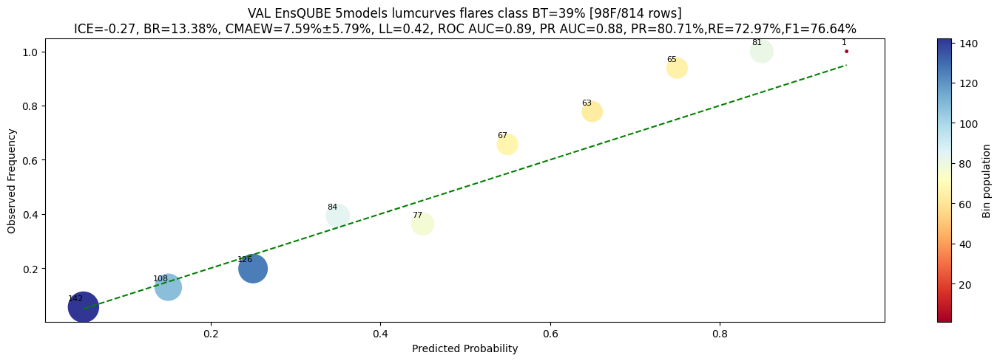

VAL EnsQUBE 5models lumcurves flares class BT=39%
              precision    recall  f1-score   support

           0     0.8151    0.8723    0.8428       470
           1     0.8071    0.7297    0.7664       344

    accuracy                         0.8120       814
   macro avg     0.8111    0.8010    0.8046       814
weighted avg     0.8117    0.8120    0.8105       814

ROC AUCs: 1=0.8857
PR AUCs: 1=0.8766
CALIBRATIONs: 
	1: MAEW=7.59%, STD=5.79%, COV=90%
BRIER LOSSes: 
	1=13.3836%
LOG_LOSSes: 
	1=0.4150
ICEs: 
	1=-0.2691
TOTAL INTEGRAL ERROR: -0.2691


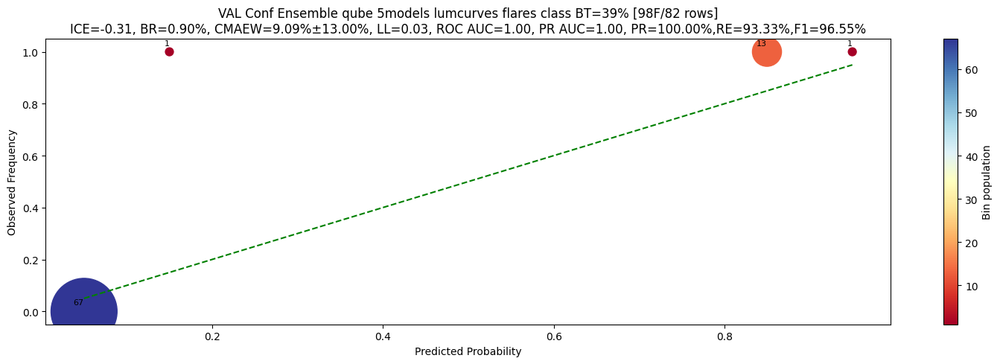

VAL Conf Ensemble qube 5models lumcurves flares class BT=39%
              precision    recall  f1-score   support

           0     0.9853    1.0000    0.9926        67
           1     1.0000    0.9333    0.9655        15

    accuracy                         0.9878        82
   macro avg     0.9926    0.9667    0.9791        82
weighted avg     0.9880    0.9878    0.9876        82

ROC AUCs: 1=1.0000
PR AUCs: 1=1.0000
CALIBRATIONs: 
	1: MAEW=9.09%, STD=13.00%, COV=30%
BRIER LOSSes: 
	1=0.8955%
LOG_LOSSes: 
	1=0.0340
ICEs: 
	1=-0.3136
TOTAL INTEGRAL ERROR: -0.3136
ens member 0 excluded due to high distance from the median, mae=0.049687, std=0.080723
ens member 1 excluded due to high distance from the median, mae=0.064406, std=0.085036
ens member 2 excluded due to high distance from the median, mae=0.113276, std=0.117855
ens member 3 excluded due to high distance from the median, mae=0.073020, std=0.093025
ens member 4 excluded due to high distance from the median, mae=0.121550, std=0

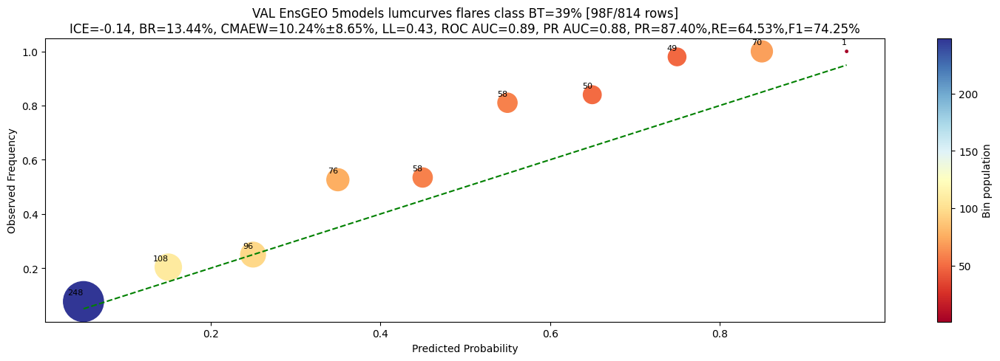

VAL EnsGEO 5models lumcurves flares class BT=39%
              precision    recall  f1-score   support

           0     0.7821    0.9319    0.8505       470
           1     0.8740    0.6453    0.7425       344

    accuracy                         0.8108       814
   macro avg     0.8281    0.7886    0.7965       814
weighted avg     0.8210    0.8108    0.8048       814

ROC AUCs: 1=0.8910
PR AUCs: 1=0.8810
CALIBRATIONs: 
	1: MAEW=10.24%, STD=8.65%, COV=100%
BRIER LOSSes: 
	1=13.4377%
LOG_LOSSes: 
	1=0.4252
ICEs: 
	1=-0.1405
TOTAL INTEGRAL ERROR: -0.1405


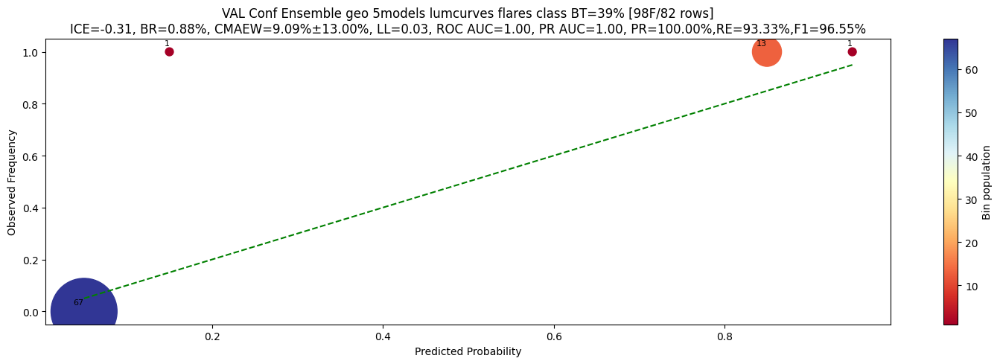

VAL Conf Ensemble geo 5models lumcurves flares class BT=39%
              precision    recall  f1-score   support

           0     0.9853    1.0000    0.9926        67
           1     1.0000    0.9333    0.9655        15

    accuracy                         0.9878        82
   macro avg     0.9926    0.9667    0.9791        82
weighted avg     0.9880    0.9878    0.9876        82

ROC AUCs: 1=1.0000
PR AUCs: 1=1.0000
CALIBRATIONs: 
	1: MAEW=9.09%, STD=13.00%, COV=40%
BRIER LOSSes: 
	1=0.8806%
LOG_LOSSes: 
	1=0.0260
ICEs: 
	1=-0.3138
TOTAL INTEGRAL ERROR: -0.3138


2026-01-01 13:36:59,268 - INFO - log_phase-line:44 - ----------------------------------------------------------------------------------------------------------------------------------------------------------------
2026-01-01 13:36:59,274 - INFO - log_phase-line:45 - Training suite completed for flares, 5 models.
2026-01-01 13:36:59,281 - INFO - log_phase-line:46 - ----------------------------------------------------------------------------------------------------------------------------------------------------------------
2026-01-01 13:36:59,285 - INFO - log_ram_usage-line:39 - Done. RAM usage: 0.0GB.


time: 4min 56s (started: 2026-01-01 13:32:03 +03:00)


In [30]:
target_name = "lumcurves"

ft_extractor = SimpleFeaturesAndTargetsExtractor(
    classification_targets=["class"],
    columns_to_drop=set(["id", "ts", "source"]),
    verbose=1,
)

mlframe_models, metadata = train_mlframe_models_suite(
    df=labeled_df_train,
    target_name=target_name,
    model_name=f"flares",
    features_and_targets_extractor=ft_extractor,
    mlframe_models="cb xgb lgb ngb hgb linear".split(),
    init_common_params={"show_perf_chart": True, "show_fi": True},
    use_ordinary_models=True,
    split_config=TrainingSplitConfig(
        shuffle_val=True, shuffle_test=True, test_size=0.0, val_size=0.1
    ),
    use_mlframe_ensembles=True,
    data_dir="data",
    # models_dir=None,
    verbose=True,
)

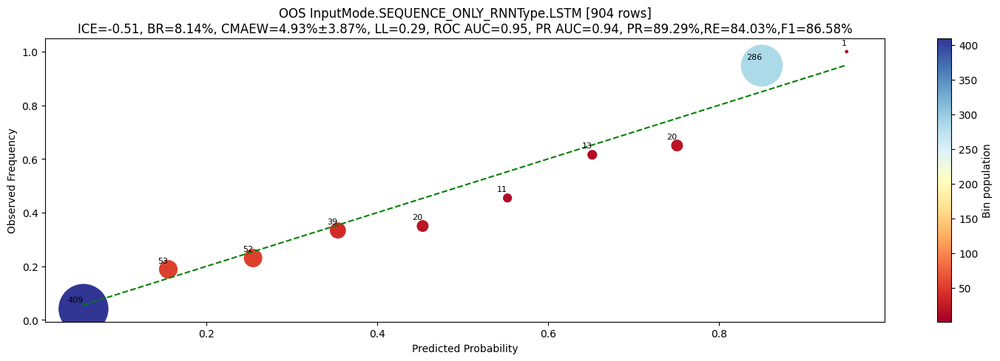

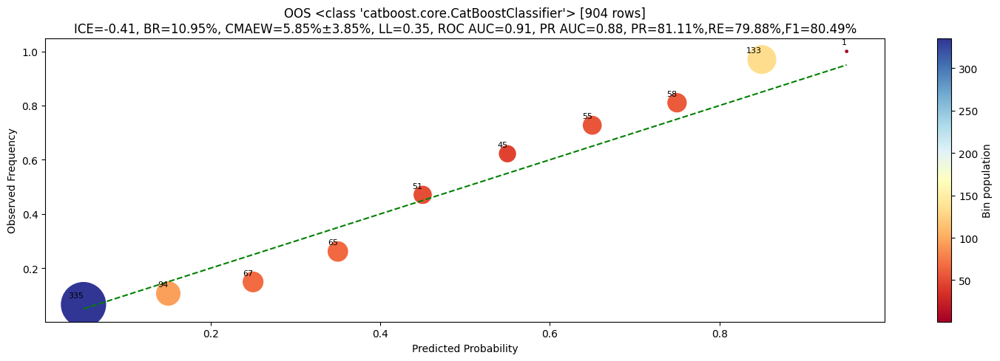

OOS <class 'catboost.core.CatBoostClassifier'>
              precision    recall  f1-score   support

           0       0.89      0.89      0.89       576
           1       0.81      0.80      0.80       328

    accuracy                           0.86       904
   macro avg       0.85      0.85      0.85       904
weighted avg       0.86      0.86      0.86       904

ROC AUCs: 1=0.91
PR AUCs: 1=0.88
CALIBRATIONs: 
	1: MAEW=5.85%, STD=3.85%, COV=90%
BRIER LOSSes: 
	1=10.95%
LOG_LOSSes: 
	1=0.35
ICEs: 
	1=-0.41
TOTAL INTEGRAL ERROR: 0.0000


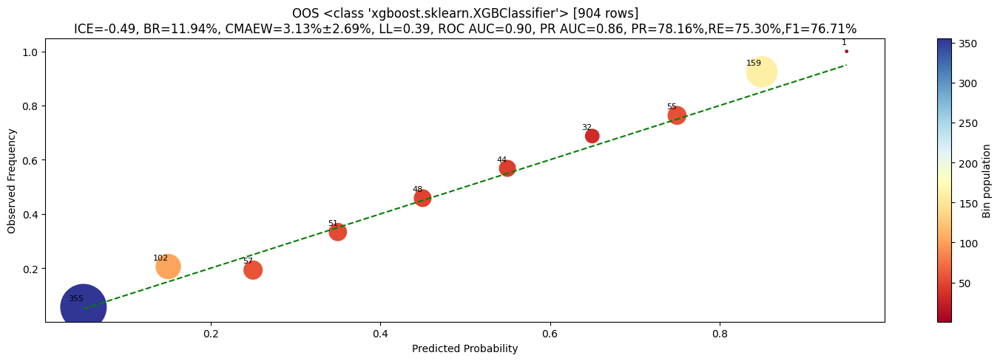

OOS <class 'xgboost.sklearn.XGBClassifier'>
              precision    recall  f1-score   support

           0       0.86      0.88      0.87       576
           1       0.78      0.75      0.77       328

    accuracy                           0.83       904
   macro avg       0.82      0.82      0.82       904
weighted avg       0.83      0.83      0.83       904

ROC AUCs: 1=0.90
PR AUCs: 1=0.86
CALIBRATIONs: 
	1: MAEW=3.13%, STD=2.69%, COV=90%
BRIER LOSSes: 
	1=11.94%
LOG_LOSSes: 
	1=0.39
ICEs: 
	1=-0.49
TOTAL INTEGRAL ERROR: 0.0000


ValueError: Input contains NaN.

time: 1.59 s (started: 2026-01-01 13:45:38 +03:00)


In [45]:
for mlframe_model in mlframe_models["class"]["binary_classification"]:
    model = mlframe_model.model
    key = f"{type(model)}"

    models[key] = model

    probs = model.predict_proba(
        labeled_df_test.select(mlframe_model.columns).to_pandas()
    )

    metrics[key] = {}

    _, _ = report_model_perf(
        targets=targets,
        columns=None,
        df=None,
        model_name=key,
        model=None,
        target_label_encoder=None,
        preds=None,
        probs=probs,
        plot_file=join(charts_dir, key) if charts_dir else None,
        metrics=metrics[key],
        group_ids=None,
        **report_params,
    )

In [47]:

# Extract features and labels
feature_cols = [
    c
    for c in labeled_df.columns
    if c not in ("class", "source", "row_index", "index", "_orig_idx")
]
X = labeled_df.select(feature_cols).to_numpy()
    X = np.nan_to_num(X, nan=0.0, posinf=1e6, neginf=-1e6)
y = labeled_df["class"].to_numpy()

# Train
config = RecurrentConfig(input_mode=InputMode.FEATURES_ONLY)
wrapper = RecurrentClassifierWrapper(config)
wrapper.fit(features=X, labels=y)

2025-12-31 08:30:15,105 - INFO - seed_everything-line:54 - Seed set to 42
2025-12-31 08:30:15,568 - INFO - _info-line:64 - GPU available: True (cuda), used: True
2025-12-31 08:30:15,568 - INFO - _info-line:64 - TPU available: False, using: 0 TPU cores
2025-12-31 08:30:15,578 - INFO - _info-line:64 - HPU available: False, using: 0 HPUs
R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\trainer\configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
R:\ProgramData\anaconda3\Lib\site-packages\pytorch_lightning\callbacks\model_checkpoint.py:652: Checkpoint directory S:\recovered13\Programming\MyCurrentProjects\Astronomy\astronomy\checkpoints exists and is not empty.
2025-12-31 08:30:15,586 - INFO - set_nvidia_flags-line:61 - LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
2025-12-31 08:30:15,628 - INFO - _info-line:64 - Loading `train_dataloader` to estimate number of stepping batches.
R:\ProgramData\anaconda3\Lib\site-packages\py

Training: |                                                                                      | 0/? [00:00<…

R:\ProgramData\anaconda3\Lib\site-packages\torch\nn\modules\linear.py:116: UserWarning:

Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ..\aten\src\ATen\Context.cpp:185.)

R:\ProgramData\anaconda3\Lib\site-packages\torch\autograd\graph.py:744: UserWarning:

Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable 

time: 4min 29s (started: 2025-12-31 08:30:15 +03:00)


In [46]:
import numpy as np

print("NaN in X:", np.isnan(X).sum())
print("Inf in X:", np.isinf(X).sum())
print("X min/max:", X.min(), X.max())

NaN in X: 9009
Inf in X: 0
X min/max: nan nan
time: 16 ms (started: 2025-12-31 08:29:42 +03:00)


In [ ]:
from mlfrm\ame.training.core import _ensure_config
split_config = _ensure_config(split_config, TrainingSplitConfig, kwargs)
train_idx, val_idx, test_idx, train_details, val_details, test_details = make_train_test_split(
        df=df,
        timestamps=timestamps,
        **split_config.model_dump(),
    )